# Voyager I

## Table of Contents
- [Voyager I](#Voyager-I)
  - [Table of Contents](#Table-of-Contents)
  - [Imports](#Imports)
  - [1) Choose the epochs $T_1$ to $T_N$, corresponding to all the planets $P_1$ to $P_N$ in the mission. This is decided later in the optimisation algorithm.](#1\)-Choose-the-epochs-$T_1$-to-$T_N$,-corresponding-to-all-the-planets-$P_1$-to-$P_N$-in-the-mission.-This-is-decided-later-in-the-optimisation-algorithm.)
    - [1.1) Convert epochs to MJD](#1.1\)-Convert-epochs-to-MJD)
    - [1.2) Find the $\Delta t$ for each mission trajectory](#1.2\)-Find-the-$\Delta-t$-for-each-mission-trajectory)
  - [2) Using the known epochs $T_1$ to $T_N$, calculate their respective planetary state vectors $\{\mathbf{r},\mathbf{V}^{\,(\text{P})}\}$ using Algorithm 3.2.](#2\)-Using-the-known-epochs-$T_1$-to-$T_N$,-calculate-their-respective-planetary-state-vectors-$\{\mathbf{r},\mathbf{V}^{\,\(\text{P}\)}\}$-using-Algorithm-3.2.)
  - [3) Now, to define the transfer trajectory we separate them into legs: $P_1\text{-}P_2$, $P_2\text{-}P_3$, ..., $P_{N-1}\text{-}P_N$. For each leg, we can use the solution to Lambert's Problem (Algorithm 3.3) to get its transfer velocity vectors. This fully defines each leg, where for instance $P_1\text{-}P_2$ leg, we have the following parameters $\big\{{\mathbf{r}}_{1}, {\mathbf{r}}_{2}, {\mathbf{V}}^{\,(\text{P})}_1,{\mathbf{V}}^{\,(\text{P})}_2, ({\mathbf{v}})_{D}, ({\mathbf{v}}_{T_2})_{A}, \Delta t\big\}$.](#3\)-Now,-to-define-the-transfer-trajectory-we-separate-them-into-legs:-$P_1\text{-}P_2$,-$P_2\text{-}P_3$,-...,-$P_{N-1}\text{-}P_N$.-For-each-leg,-we-can-use-the-solution-to-Lambert's-Problem-\(Algorithm-3.3\)-to-get-its-transfer-velocity-vectors.-This-fully-defines-each-leg,-where-for-instance-$P_1\text{-}P_2$-leg,-we-have-the-following-parameters-$\big\{{\mathbf{r}}_{1},-{\mathbf{r}}_{2},-{\mathbf{V}}^{\,\(\text{P}\)}_1,{\mathbf{V}}^{\,\(\text{P}\)}_2,-\({\mathbf{v}}\)_{D},-\({\mathbf{v}}_{T_2}\)_{A},-\Delta-t\big\}$.)
  - [4) We can now work out $\Delta V_\mathrm{injection}$, the initial injection burn from $P_1$ into transfer orbit,](#4\)-We-can-now-work-out-$\Delta-V_\mathrm{injection}$,-the-initial-injection-burn-from-$P_1$-into-transfer-orbit,)
  - [Flyby](#Flyby)
    - [5) Find $\Delta V_{p\,\mathrm{(flyby)}}$, we must first find the hyperbolic excess velocities $\{{\mathbf{v}}_{\infty_\mathrm{in}},{\mathbf{v}}_{\infty_\mathrm{out}} \}$ at each flyby planet](#5\)-Find-$\Delta-V_{p\,\mathrm{\(flyby\)}}$,-we-must-first-find-the-hyperbolic-excess-velocities-$\{{\mathbf{v}}_{\infty_\mathrm{in}},{\mathbf{v}}_{\infty_\mathrm{out}}-\}$-at-each-flyby-planet)
    - [6) Find the planet's inbound $a_\mathrm{in}$ and outbound $a_\mathrm{out}$ semi-major axis](#6\)-Find-the-planet's-inbound-$a_\mathrm{in}$-and-outbound-$a_\mathrm{out}$-semi-major-axis)
    - [7) Find its deflection (turning) angle $\delta$ from entering SOI to exiting SOI](#7\)-Find-its-deflection-\(turning\)-angle-$\delta$-from-entering-SOI-to-exiting-SOI)
    - [8) Hence, the radius of the closest approach to the planet $r_{\mathrm{p\,(flyby)}}$ can be calculated](#8\)-Hence,-the-radius-of-the-closest-approach-to-the-planet-$r_{\mathrm{p\,\(flyby\)}}$-can-be-calculated)
    - [9) We now have all the required parameter to equate $\Delta V_{\mathrm{p\,(flyby)}}$,](#9\)-We-now-have-all-the-required-parameter-to-equate-$\Delta-V_{\mathrm{p\,\(flyby\)}}$,)
  - [10) Finally, to summate all the individual $\Delta V$ components of the initial injection and subsequent flybys we can equate,](#10\)-Finally,-to-summate-all-the-individual-$\Delta-V$-components-of-the-initial-injection-and-subsequent-flybys-we-can-equate,)
  - [11) From the calculated mission $\Delta V$, we can find the fuel mass $M_f$ used.](#11\)-From-the-calculated-mission-$\Delta-V$,-we-can-find-the-fuel-mass-$M_f$-used.)
    - [NASA Data](#NASA-Data)
    - [My Real Simulation Data](#My-Real-Simulation-Data)
- [Function: find_deltaV_mission()](#Function:-find_deltaV_mission\(\))
- [Optimisation Algorithms](#Optimisation-Algorithms)
  - [Brute Force Search](#Brute-Force-Search)
    - [1) Find the $\Delta t$ for each mission trajectory](#1\)-Find-the-$\Delta-t$-for-each-mission-trajectory)
    - [2) Define the range for each date allowed for algorithm](#2\)-Define-the-range-for-each-date-allowed-for-algorithm)
    - [3) Run Algorithm](#3\)-Run-Algorithm)
    - [4) Contour Graph of Problem Space](#4\)-Contour-Graph-of-Problem-Space)
    - [5) Fixing a Date for Problem Space 2D Contour](#5\)-Fixing-a-Date-for-Problem-Space-2D-Contour)
  - [Nelder-Mead Simplex Algorithm (Fmin)](#Nelder-Mead-Simplex-Algorithm-\(Fmin\))
    - [Contour Graph of Problem Space](#Contour-Graph-of-Problem-Space)
  - [Genetic Algorithm (GA)](#Genetic-Algorithm-\(GA\))
    - [1) Generate Initial Population](#1\)-Generate-Initial-Population)
    - [2) Evaluation to Get Fitness](#2\)-Evaluation-to-Get-Fitness)
    - [3) Sort Population by Fitness](#3\)-Sort-Population-by-Fitness)
    - [4) Elitism](#4\)-Elitism)
    - [5) Selection](#5\)-Selection)
    - [6) Crossover](#6\)-Crossover)
    - [7) Mutation (Random Perturbations)](#7\)-Mutation-\(Random-Perturbations\))
    - [8) Running GA](#8\)-Running-GA)
    - [9) GA Result Analysis](#9\)-GA-Result-Analysis)
  - [Hybrid GA (GA + Fmin)](#Hybrid-GA-\(GA-+-Fmin\))
    - [Contour Graph of Problem Space](#Contour-Graph-of-Problem-Space)
  - [Save Dates](#Save-Dates)
- [Graphs](#Graphs)
  - [Comparsion Graphs](#Comparsion-Graphs)
    - [2-Axis](#2-Axis)
    - [2-Axis Zoomed](#2-Axis-Zoomed)
  - [Genetic Algorithm (GA) Animation](#Genetic-Algorithm-\(GA\)-Animation)
    - [Orbital Trajectory per Generation](#Orbital-Trajectory-per-Generation)
    - [GA Problem Space per Generation](#GA-Problem-Space-per-Generation)
  - [Final DeltaV \& Fuel Mass](#Final-DeltaV-\&-Fuel-Mass)
    - [Comparsion Table](#Comparsion-Table)
  - [Time Execution](#Time-Execution)
  - [Variation in Heliocentric Velocity along Voyager I Trajectory](#Variation-in-Heliocentric-Velocity-along-Voyager-I-Trajectory)
    - [Voyager I NASA Mission Data](#Voyager-I-NASA-Mission-Data)
    - [Comparison with Algorithms](#Comparison-with-Algorithms)
    - [Graph](#Graph)
  - [DeltaV to Fuel Mass](#DeltaV-to-Fuel-Mass)
- [Voyager I \& II NASA Mission Data](#Voyager-I-\&-II-NASA-Mission-Data)

## Imports

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import math as m
from scipy.optimize import fsolve, brentq, newton, least_squares, fmin
from matplotlib.lines import Line2D
from matplotlib import colors
from scipy.interpolate import griddata
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import ScalarFormatter
import time
import warnings
from tqdm import tqdm
import pickle

from astropy import units as u
from astropy.time import Time
from astropy.coordinates import solar_system_ephemeris

solar_system_ephemeris.set("jpl")

from poliastro.bodies import *
from poliastro.ephem import Ephem
from poliastro.frames import Planes
from poliastro.maneuver import Maneuver
from poliastro.twobody import Orbit
from poliastro.util import norm, time_range
from poliastro.plotting.static import StaticOrbitPlotter

from itertools import permutations, combinations
from random import shuffle
import random
import statistics
import seaborn as sns
from IPython.display import HTML
import matplotlib.animation as animation

from poliastro.core.iod import vallado
from poliastro.core.elements import rv2coe
import datetime

import os
from pathlib import Path

from IPython.display import HTML, display
from matplotlib.animation import PillowWriter
import io
from base64 import b64encode


def show(variable, units):
    def get_var_name(var):
        for name, value in globals().items():
            if value is var:
                return name

    print(get_var_name(variable), "=", variable, units)


# To remove warning messages
warnings.filterwarnings("ignore")

# Set LaTeX for text rendering
plt.rc("text", usetex=True)
plt.rc("font", family="serif")

In [6]:
def set_font_sizes(legend_size=14):
    # Set LaTeX for text rendering
    plt.rc("text", usetex=True)
    plt.rc("font", family="serif")

    # Set font sizes based on legend size
    plt.rc("legend", fontsize=legend_size)  # legend fontsize (base size)
    plt.rc(
        "axes", titlesize=legend_size * 1.2
    )  # fontsize of the axes title (20% larger)
    plt.rc(
        "axes", labelsize=legend_size * 1.0
    )  # fontsize of the x and y labels (same as legend)
    plt.rc(
        "xtick", labelsize=legend_size * 0.8
    )  # fontsize of the tick labels (20% smaller)
    plt.rc(
        "ytick", labelsize=legend_size * 0.8
    )  # fontsize of the tick labels (20% smaller)
    plt.rc(
        "figure", titlesize=legend_size * 1.4
    )  # fontsize of the figure title (40% larger)
    annotation_size = (
        legend_size * 0.9
    )  # annotation text size (10% smaller than legend)
    plt.rc("font", size=annotation_size)  # default font size for annotations

    # Return the settings dict for reference (optional)
    settings = {
        "legend": legend_size,
        "axes.title": legend_size * 1.2,
        "axes.label": legend_size * 1.0,
        "xtick.label": legend_size * 0.8,
        "ytick.label": legend_size * 0.8,
        "figure.title": legend_size * 1.4,
        "annotation": annotation_size,
    }

    return settings

In [7]:
# Create an output directory handler
class OutputManager:
    def __init__(self, base_dir="V1"):
        # Initialise the output manager with a base directory
        self.base_dir = Path(base_dir)
        self.base_dir.mkdir(exist_ok=True)
        print(f"Output directory set to: {self.base_dir.absolute()}")

    # Save a figure with consistent settings
    def save_file(self, filename, dpi=500, bbox_inches="tight", **kwargs):
        # Ensure the filename has an extension
        if not any(filename.endswith(ext) for ext in [".png", ".jpg", ".pdf", ".svg"]):
            filename = f"{filename}.png"

        # Create the full path
        full_path = self.base_dir / filename

        # Save the figure
        plt.savefig(full_path, dpi=dpi, bbox_inches=bbox_inches, **kwargs)
        print(f"Figure saved to: {full_path}")

        return full_path

    # Get the full path for a file.
    def get_path(self, filename):
        return self.base_dir / filename


# Create an instance of the output manager
output_figures = OutputManager("Voyager 1 - Figures")
output_pickle = OutputManager("Raw Results")
output_ani = OutputManager("Voyager 1 - Animations")

Output directory set to: /Users/snath2/Desktop/Aero & Astro/Year 3/IP/Final IP/Optimisation Algorithms/Voyager 1 - Figures
Output directory set to: /Users/snath2/Desktop/Aero & Astro/Year 3/IP/Final IP/Optimisation Algorithms/Raw Results
Output directory set to: /Users/snath2/Desktop/Aero & Astro/Year 3/IP/Final IP/Optimisation Algorithms/Voyager 1 - Animations


In [8]:
# Flag to enable or disable running of the algorithms (when disabled, the stored results are read).
global_flag = False

In [9]:
# Flag to store the algorithm results. If testing, then the algorithm runs will not store results.
testing_flag = False

In [10]:
mu_earth = Earth.k.to(u.km**3 / u.s**2).value
mu_jupiter = Jupiter.k.to(u.km**3 / u.s**2).value
mu_saturn = Saturn.k.to(u.km**3 / u.s**2).value
mu_sun = Sun.k.to(u.km**3 / u.s**2).value
mu_sun

132712442099.00002

In [11]:
mu = mu_sun  # Sun's gravitational parameter (km³/s²)
mu

132712442099.00002

In [12]:
# Define parula colormap (MATLAB-style) with an option to reverse
def parula_map(reverse=False):
    # RGB values
    cm_data = [
        [0.2081, 0.1663, 0.5292],
        [0.2116, 0.1898, 0.5777],
        [0.2123, 0.2138, 0.6270],
        [0.2081, 0.2386, 0.6771],
        [0.1959, 0.2645, 0.7279],
        [0.1707, 0.2919, 0.7792],
        [0.1253, 0.3242, 0.8303],
        [0.0591, 0.3598, 0.8683],
        [0.0117, 0.3875, 0.8820],
        [0.0060, 0.4086, 0.8828],
        [0.0165, 0.4266, 0.8786],
        [0.0329, 0.4430, 0.8720],
        [0.0498, 0.4586, 0.8641],
        [0.0629, 0.4737, 0.8554],
        [0.0723, 0.4887, 0.8467],
        [0.0779, 0.5040, 0.8384],
        [0.0793, 0.5200, 0.8312],
        [0.0749, 0.5375, 0.8263],
        [0.0641, 0.5570, 0.8240],
        [0.0488, 0.5772, 0.8228],
        [0.0343, 0.5966, 0.8199],
        [0.0265, 0.6137, 0.8135],
        [0.0239, 0.6287, 0.8038],
        [0.0231, 0.6418, 0.7913],
        [0.0228, 0.6535, 0.7768],
        [0.0267, 0.6642, 0.7607],
        [0.0384, 0.6743, 0.7436],
        [0.0590, 0.6838, 0.7254],
        [0.0843, 0.6928, 0.7062],
        [0.1133, 0.7015, 0.6859],
        [0.1453, 0.7098, 0.6646],
        [0.1801, 0.7177, 0.6424],
        [0.2178, 0.7250, 0.6193],
        [0.2586, 0.7317, 0.5954],
        [0.3022, 0.7376, 0.5712],
        [0.3482, 0.7424, 0.5473],
        [0.3953, 0.7459, 0.5244],
        [0.4420, 0.7481, 0.5033],
        [0.4871, 0.7491, 0.4840],
        [0.5300, 0.7491, 0.4661],
        [0.5709, 0.7485, 0.4494],
        [0.6099, 0.7473, 0.4337],
        [0.6473, 0.7456, 0.4188],
        [0.6834, 0.7435, 0.4044],
        [0.7184, 0.7411, 0.3905],
        [0.7525, 0.7384, 0.3768],
        [0.7858, 0.7356, 0.3633],
        [0.8185, 0.7327, 0.3498],
        [0.8507, 0.7299, 0.3360],
        [0.8824, 0.7274, 0.3217],
        [0.9139, 0.7258, 0.3063],
        [0.9450, 0.7261, 0.2886],
        [0.9739, 0.7314, 0.2666],
        [0.9938, 0.7455, 0.2403],
        [0.9990, 0.7653, 0.2164],
        [0.9955, 0.7861, 0.1967],
        [0.9880, 0.8066, 0.1794],
        [0.9789, 0.8271, 0.1633],
        [0.9697, 0.8481, 0.1475],
        [0.9626, 0.8705, 0.1309],
        [0.9589, 0.8949, 0.1132],
        [0.9598, 0.9218, 0.0948],
        [0.9661, 0.9514, 0.0755],
        [0.9763, 0.9831, 0.0538],
    ]

    if reverse:
        cm_data = cm_data[::-1]  # Reverse the list if specified

    return colors.ListedColormap(cm_data)

## 1) Choose the epochs $T_1$ to $T_N$, corresponding to all the planets $P_1$ to $P_N$ in the mission. This is decided later in the optimisation algorithm.

In [14]:
# Voyager I real mission timing
scale = "tt"

date_departure = date_earth_jupiter = "1977-09-08 09:08"

date_flyby_jupiter = "1979-03-05 12:05"
# date_jupiter_saturn = "1979-04-24 07:33:03"

date_arrival = date_flyby_saturn = "1980-11-12 23:46"

### 1.1) Convert epochs to MJD

In [16]:
from astropy.time import Time


# e.g T_et = "1979-03-05 12:05:26"
def convert_ET(T_et):
    # Defines time scale for astropy.time of ET, which approx equal to TT
    T_tt = Time(T_et, scale="tt")
    # Calculate TDB (only 1-2 milliseconds different from ET/TT)
    T_tdb = T_tt.tdb
    # Calculates the TAI (T_tai = T_tt - 32.184s)
    T_tai = T_tt.tai
    # Calculates the JD from epoch 1st January 4713 BC at 12:00 TT
    T_jd = T_tt.jd
    # Calculates MJD
    T_mjd = T_jd - 2400000.5
    # Calculate UTC using NASA's Sprice Time Subsystem
    T_utc = T_tt.utc
    return {"TDB": T_tdb, "TAI": T_tai, "JD": T_jd, "MJD": T_mjd, "UTC": T_utc}


scale = "mjd"

date_departure_mjd = convert_ET(date_departure)["MJD"]

date_flyby_jupiter_mjd = convert_ET(date_flyby_jupiter)["MJD"]

date_flyby_saturn_mjd = convert_ET(date_flyby_saturn)["MJD"]

show(date_departure_mjd, "MJD")
show(date_flyby_jupiter_mjd, "MJD")
show(date_flyby_saturn_mjd, "MJD")

date_departure_mjd = 43394.38055555569 MJD
date_flyby_jupiter_mjd = 43937.503472222015 MJD
date_flyby_saturn_mjd = 44555.99027777789 MJD


### 1.2) Find the $\Delta t$ for each mission trajectory

In [18]:
def find_tof(start_date_days, end_date_days):
    delta_t = (end_date_days - start_date_days) * (60 * 60 * 24)
    return delta_t


delta_t_earth_jupiter = find_tof(date_departure_mjd, date_flyby_jupiter_mjd)
delta_t_jupiter_saturn = find_tof(date_flyby_jupiter_mjd, date_flyby_saturn_mjd)
print("Earth-Jupiter:", delta_t_earth_jupiter, "s")
print("Jupiter-Saturn:", delta_t_jupiter_saturn, "s")

Earth-Jupiter: 46925819.999970496 s
Jupiter-Saturn: 53437260.000027716 s


## 2) Using the known epochs $T_1$ to $T_N$, calculate their respective planetary state vectors $\{\mathbf{r},\mathbf{V}^{\,(\text{P})}\}$ using Algorithm 3.2.

In [20]:
def get_planet_state_vector(planet, date_time, scale):
    # Convert the date_time in MJD to modern TDB time scale
    date = Time(date_time, format="mjd", scale=scale).tdb
    # Generate the planet's ephemeris at the given time
    planet_ephem = Ephem.from_body(planet, date, plane=Planes.EARTH_ECLIPTIC)
    # Extract the position and velocity vectors
    r, v = planet_ephem.rv(date)
    r = r.to(u.km)
    v = v.to(u.km / u.s)
    return r, v


scale = "tt"
r_earth, v_earth = get_planet_state_vector(Earth, date_departure_mjd, scale)
r_jupiter, v_jupiter = get_planet_state_vector(Jupiter, date_flyby_jupiter_mjd, scale)
r_saturn, v_saturn = get_planet_state_vector(Saturn, date_flyby_saturn_mjd, scale)

In [21]:
print("Earth:")
display(r_earth, v_earth)
print("Jupiter:")
display(r_jupiter, v_jupiter)
print("Saturn:")
display(r_saturn, v_saturn)

Earth:


<Quantity [ 1.46527291e+08, -3.73266666e+07, -1.03602400e+04] km>

<Quantity [6.78843938e+00, 2.87867619e+01, 1.02335131e-03] km / s>

Jupiter:


<Quantity [-4.81215109e+08,  6.27073938e+08,  8.19439645e+06] km>

<Quantity [-10.51367988,  -7.3532518 ,   0.26572085] km / s>

Saturn:


<Quantity [-1.42004992e+09, -5.43085654e+07,  5.73830616e+07] km>

<Quantity [-0.14811167, -9.66974421,  0.17492744] km / s>

In [22]:
r_earth, v_earth = r_earth.value, v_earth.value
r_jupiter, v_jupiter = r_jupiter.value, v_jupiter.value
r_saturn, v_saturn = r_saturn.value, v_saturn.value

## 3) Now, to define the transfer trajectory we separate them into legs: $P_1\text{-}P_2$, $P_2\text{-}P_3$, ..., $P_{N-1}\text{-}P_N$. For each leg, we can use the solution to Lambert's Problem (Algorithm 3.3) to get its transfer velocity vectors. This fully defines each leg, where for instance $P_1\text{-}P_2$ leg, we have the following parameters $\big\{{\mathbf{r}}_{1}, {\mathbf{r}}_{2}, {\mathbf{V}}^{\,(\text{P})}_1,{\mathbf{V}}^{\,(\text{P})}_2, ({\mathbf{v}})_{D}, ({\mathbf{v}}_{T_2})_{A}, \Delta t\big\}$.

In [24]:
# from poliastro.core.iod import vallado

# # Lambert Solver
# def lambert(r1, r2, delta_t):
#     v_d, v_a = vallado(mu_sun, r1, r2, delta_t, M=0, prograde=True, lowpath=True, numiter=1e6, rtol=1e-8)
#     return v_d, v_a

import numpy as np
from scipy.optimize import brentq, newton, least_squares

# Known parameters [r1, r2, delta_t]
mu = 1.327e11  # Sun's gravitational parameter (km^3/s^2)


# Stumpff functions
def C(z):
    if z > 0:
        return (1 - np.cos(np.sqrt(z))) / z
    elif z < 0:
        return (np.cosh(np.sqrt(-z)) - 1) / (-z)
    else:
        return 0.5


def S(z):
    if z > 0:
        return (np.sqrt(z) - np.sin(np.sqrt(z))) / (z**1.5)
    elif z < 0:
        return (np.sinh(np.sqrt(-z)) - np.sqrt(-z)) / ((-z) ** 1.5)
    else:
        return 1 / 6


# Compute y parameter
def compute_y(z, r1, r2, A):
    C_z = max(C(z), 1e-8)  # Ensure no division by zero
    return max(r1 + r2 + A * (z * S(z) - 1) / np.sqrt(C_z), 1e-8)


# Time-of-flight equation
def F_lambert(z, delta_t, r1, r2, A):
    y_val = compute_y(z, r1, r2, A)
    return ((y_val / C(z)) ** 1.5) * S(z) + A * np.sqrt(y_val) - np.sqrt(mu) * delta_t


# Lambert solver
def lambert(r1, r2, deltat):
    # Step 1: Find the delta_theta between P1 and P2
    r1_mag, r2_mag = np.linalg.norm(r1), np.linalg.norm(r2)
    delta_theta = np.arccos(np.dot(r1, r2) / (r1_mag * r2_mag))

    if np.cross(r1, r2)[2] < 0:
        delta_theta = 2 * np.pi - delta_theta

    # Step 2: Solve for the intermediate auxiliary variable z
    A = np.sin(delta_theta) * np.sqrt(r1_mag * r2_mag / (1 - np.cos(delta_theta)))

    def func(z_val):
        return F_lambert(z_val, deltat, r1_mag, r2_mag, A)

    def solver(func, z_min=-1e3, z_max=1e3, z_guess=0.01):
        try:
            z = brentq(lambda z: func(z), z_min, z_max)
        except ValueError:
            try:
                z = newton(func, z_guess)
            except RuntimeError:
                z = least_squares(func, z_guess).x[0]
        return z

    z = solver(func)
    y_val = compute_y(z, r1_mag, r2_mag, A)

    # Step 3: Compute Lagrange coefficients f, g, gdot
    f = 1 - y_val / r1_mag
    g = A * np.sqrt(y_val / mu)
    gdot = 1 - y_val / r2_mag

    v1 = (r2 - f * r1) / g
    v2 = (gdot * r2 - r1) / g
    return v1, v2


v1_d, v2_a = lambert(r_earth, r_jupiter, delta_t_earth_jupiter)
v2_d, v3_a = lambert(r_jupiter, r_saturn, delta_t_jupiter_saturn)
print(v1_d, v2_a)
print(v2_d, v3_a)

[10.72074241 38.28749663  0.66273895] [-1.22415214e+01  3.46208225e+00  6.42429222e-03]
[-20.97912678 -10.58575624   1.01828126] [-14.94072746 -13.42269638   0.82774958]


In [25]:
print(np.linalg.norm(v1_d), np.linalg.norm(v2_a))
print(np.linalg.norm(v2_d), np.linalg.norm(v3_a))

39.765637662752795 12.721670500594671
23.520605691058012 20.101723417599942


## 4) We can now work out $\Delta V_\mathrm{injection}$, the initial injection burn from $P_1$ into transfer orbit,

In [27]:
deltaV_injection = v1_d - v_earth
deltaV_injection = np.linalg.norm(deltaV_injection)
deltaV_injection

10.303632164583048

## Flyby

### 5) Find $\Delta V_{p\,\mathrm{(flyby)}}$, we must first find the hyperbolic excess velocities $\{{\mathbf{v}}_{\infty_\mathrm{in}},{\mathbf{v}}_{\infty_\mathrm{out}} \}$ at each flyby planet

### 6) Find the planet's inbound $a_\mathrm{in}$ and outbound $a_\mathrm{out}$ semi-major axis

### 7) Find its deflection (turning) angle $\delta$ from entering SOI to exiting SOI

#### Here, we can utilise the equation relating deflection (turning) angle $\delta$ to the outbound eccentricity $e_\mathrm{out}$ of hyperbolic trajectory,

### 8) Hence, the radius of the closest approach to the planet $r_{\mathrm{p\,(flyby)}}$ can be calculated

### 9) We now have all the required parameter to equate $\Delta V_{\mathrm{p\,(flyby)}}$,

In [35]:
R_jupiter = 69911  # km
R_saturn = 58232  # km

R_jupiter_SOI = 48.2e6  # km
R_saturn_SOI = 54.5e6  # km

In [36]:
# Add must be more than R_planet but less that r_SOI <-- NEED TO ADD!!!!!


def find_deltaV_flyby(v_in, v_out, v_planet, mu_planet, R_planet, R_SOI):
    vinf_in = v_in - v_planet
    vinf_out = v_out - v_planet

    a_in = -mu_planet / np.linalg.norm(vinf_in) ** 2
    a_out = -mu_planet / np.linalg.norm(vinf_out) ** 2

    deflection = np.arccos(
        np.dot(vinf_in, vinf_out) / (np.linalg.norm(vinf_in) * np.linalg.norm(vinf_out))
    )

    # e_out = 1/np.sin(deflection/2)

    def f(e_out, a_out, a_in, deflection):
        return (a_out / a_in * (e_out - 1)) * np.sin(
            deflection - np.arcsin(1 / e_out)
        ) - 1

    def solver_e_out(a_out, a_in, deflection, e_guess=1.1, e_min=1.01, e_max=10.0):
        try:
            e_out = brentq(lambda e: f(e, a_out, a_in, deflection), e_min, e_max)
        except ValueError:
            try:
                e_out = newton(lambda e: f(e, a_out, a_in, deflection), e_guess)
            except RuntimeError:
                e_out = least_squares(
                    lambda e: f(e, a_out, a_in, deflection), e_guess
                ).x[0]
        return e_out

    e_out = solver_e_out(a_out, a_in, deflection)

    rp = a_out * (1 - e_out)

    if rp < R_planet and rp > R_SOI:
        deltaV_flyby = 1e99
    else:
        vp_esc = np.sqrt(2 * mu_planet / rp)

        vp = vp_flyby_in = np.sqrt(np.linalg.norm(vinf_in) ** 2 + (2 * mu_planet) / rp)

        if vp_flyby_in > vp_esc:
            deltaV_flyby = abs(
                np.sqrt(np.linalg.norm(vinf_out) ** 2 + (2 * mu_planet) / rp)
                - np.sqrt(np.linalg.norm(vinf_in) ** 2 + (2 * mu_planet) / rp)
            )
        else:
            deltaV_flyby = 1e99

    return deltaV_flyby, rp, vp, vp_esc, np.rad2deg(deflection)


deltaV_jupiter, rp_jupiter, vp_jupiter, vp_esc_jupiter, deflection_jupiter = (
    find_deltaV_flyby(v2_a, v2_d, v_jupiter, mu_jupiter, R_jupiter, R_jupiter_SOI)
)
deltaV_jupiter, rp_jupiter, vp_jupiter, vp_esc_jupiter, deflection_jupiter

(0.013916787065500813,
 1128397.6009035972,
 18.563754373068818,
 14.986288896889137,
 98.16024165269266)

## 10) Finally, to summate all the individual $\Delta V$ components of the initial injection and subsequent flybys we can equate,

In [38]:
deltaV_total = deltaV_injection + deltaV_jupiter
deltaV_total

10.317548951648549

In [39]:
(date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd)

(43394.38055555569, 43937.503472222015, 44555.99027777789)

## 11) From the calculated mission $\Delta V$, we can find the fuel mass $M_f$ used.

### NASA Data

In [42]:
M0_Voyager = 2066  # kg

M0_propulsion_module = 1207  # kg
Mf_propulsion_module = 1039  # kg

M0_mission_module = 825  # kg

In [43]:
F = 68054  # N
t = 43  # s
g0 = 9.80665  # m/s2

# The Isp of the actual Voyager I mission - propulsion module
Isp_NASA = (F * t) / (Mf_propulsion_module * g0)
Isp_NASA, "s"

(287.2009612891239, 's')

**Specific impulse ($I_{sp}$)** is a measure of a rocket engine's efficiency, defined as the impulse (thrust per unit weight flow of propellant) delivered per unit of propellant consumed.

### My Real Simulation Data

In [46]:
def find_Isp(Mf, M0, deltaV):
    Isp = (deltaV * 1e3) / (np.log(M0 / (M0 - Mf)) * g0)
    return Isp


Isp_my_sim = find_Isp(Mf_propulsion_module, M0_Voyager, deltaV_total)
Isp_my_sim, "s"

(1505.2055482955852, 's')

The difference in $I_{sp}$ of NASA data and my_sim data is due to the inherit assumption in my model (Method of Patched Conics and Lambert Transfers).

Also, due to the fact NASA used a 2 stage system with the propulsion system ejected after injection into Earth-Jupiter transfer orbit. This left a 825kg mission module with around 100kg of fuel on it.

In [48]:
Isp = Isp_my_sim
Isp

1505.2055482955852

In [49]:
Vex = Isp * g0 / 1000  # km/s
Vex, "km/s"

(14.7610239901929, 'km/s')

In [50]:
M0_Voyager = M0 = 2066  # kg

In [51]:
def compute_fuel_mass(M0, Vex, deltaV):
    Mf = M0 * (1 - np.exp(-deltaV / Vex))
    return Mf


fuel_mass_total = compute_fuel_mass(M0, Vex, deltaV_total)

print(
    f"The mission deltaV of {deltaV_total:.4f}km/s caused {fuel_mass_total:.2f}kg of fuel used."
)

The mission deltaV of 10.3175km/s caused 1039.00kg of fuel used.


---

# Function: find_deltaV_mission()

In [54]:
def find_deltaV_mission(
    date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd
):
    # Step 1 - Find delta t
    delta_t_earth_jupiter = find_tof(date_departure_mjd, date_flyby_jupiter_mjd)  # s
    delta_t_jupiter_saturn = find_tof(
        date_flyby_jupiter_mjd, date_flyby_saturn_mjd
    )  # s
    tof = delta_t_earth_jupiter + delta_t_jupiter_saturn  # s

    # Step 2 - Find planetary state vectors
    scale = "tt"
    r_earth, v_earth = get_planet_state_vector(Earth, date_departure_mjd, scale)
    r_jupiter, v_jupiter = get_planet_state_vector(
        Jupiter, date_flyby_jupiter_mjd, scale
    )
    r_saturn, v_saturn = get_planet_state_vector(Saturn, date_flyby_saturn_mjd, scale)

    r_earth, v_earth = r_earth.value, v_earth.value
    r_jupiter, v_jupiter = r_jupiter.value, v_jupiter.value
    r_saturn, v_saturn = r_saturn.value, v_saturn.value

    # Step 3 - Define trajectory fully using Lambert Transfer
    v1_d, v2_a = lambert(r_earth, r_jupiter, delta_t_earth_jupiter)
    v2_d, v3_a = lambert(r_jupiter, r_saturn, delta_t_jupiter_saturn)

    # Step 4 - Injection deltaV
    deltaV_injection = v1_d - v_earth
    deltaV_injection = np.linalg.norm(deltaV_injection)

    # Step 5 - Find deltaV of flyby
    deltaV_jupiter, rp_jupiter, vp_jupiter, vp_esc_jupiter, deflection_jupiter = (
        find_deltaV_flyby(v2_a, v2_d, v_jupiter, mu_jupiter, R_jupiter, R_jupiter_SOI)
    )

    # Step 6 - Find total deltaV of mission
    deltaV_total = deltaV_injection + deltaV_jupiter

    # Step 7 - Find the fuel mass used
    fuel_mass_total = compute_fuel_mass(M0, Vex, deltaV_total)

    data_dict = {
        "deltaV_injection (km/s)": deltaV_injection,
        "deltaV_jupiter (km/s)": deltaV_jupiter,
        "rp_jupiter (km)": rp_jupiter,
        "vp_jupiter (km/s)": vp_jupiter,
        "vp_esc_jupiter (km/s)": vp_esc_jupiter,
        "deflection_jupiter (deg)": deflection_jupiter,
        "tof (days)": tof / (60 * 60 * 24),
    }

    return deltaV_total, fuel_mass_total, data_dict


deltaV_REAL, fuel_mass_REAL, data_dict_REAL = find_deltaV_mission(
    date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd
)
deltaV_REAL, fuel_mass_REAL, data_dict_REAL

(10.317548951648549,
 1039.0,
 {'deltaV_injection (km/s)': 10.303632164583048,
  'deltaV_jupiter (km/s)': 0.013916787065500813,
  'rp_jupiter (km)': 1128397.6009035972,
  'vp_jupiter (km/s)': 18.563754373068818,
  'vp_esc_jupiter (km/s)': 14.986288896889137,
  'deflection_jupiter (deg)': 98.16024165269266,
  'tof (days)': 1161.6097222222015})

In [55]:
dates_REAL = [date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd]
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

---

# Optimisation Algorithms

In [58]:
def MJD_to_TT_calander_date(T_mjd):
    T_TT = Time(T_mjd, format="mjd", scale="tt")  # Time object: scale='tt' format='mjd'
    return T_TT.iso


MJD_to_TT_calander_date(date_departure_mjd)

'1977-09-08 09:08:00.000'

In [59]:
convert_ET(MJD_to_TT_calander_date(date_departure_mjd))["UTC"]

<Time object: scale='utc' format='iso' value=1977-09-08 09:07:11.816>

In [60]:
change_in_time_days = 365

## Brute Force Search

### 1) Find the $\Delta t$ for each mission trajectory

In [63]:
print("Earth-Jupiter:", delta_t_earth_jupiter / (60 * 60 * 24), "days")
print("Jupiter-Saturn:", delta_t_jupiter_saturn / (60 * 60 * 24), "days")

Earth-Jupiter: 543.1229166663252 days
Jupiter-Saturn: 618.4868055558763 days


### 2) Define the range for each date allowed for algorithm

In [65]:
population = spacing = 50
print("No. of Iterations:", spacing**3)

No. of Iterations: 125000


In [66]:
T_real = 0
bound = 365
sampling_list = []
K = 50
DeltaT = (2 * bound) / K  # 14.6 #days

for k in range(0, K):
    sampling_list.append((T_real - bound) + k * (DeltaT))

K, DeltaT, len(sampling_list)

(50, 14.6, 50)

In [67]:
time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)
time_range_LIST, len(time_range_LIST)

(array([-365.        , -350.10204082, -335.20408163, -320.30612245,
        -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
        -245.81632653, -230.91836735, -216.02040816, -201.12244898,
        -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
        -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
         -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
          -7.44897959,    7.44897959,   22.34693878,   37.24489796,
          52.14285714,   67.04081633,   81.93877551,   96.83673469,
         111.73469388,  126.63265306,  141.53061224,  156.42857143,
         171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
         230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
         290.51020408,  305.40816327,  320.30612245,  335.20408163,
         350.10204082,  365.        ]),
 50)

In [68]:
time_range_LIST[1] - time_range_LIST[0]

14.897959183673493

In [69]:
departure_time_range_LIST = np.linspace(
    -change_in_time_days, change_in_time_days, spacing
)
departure_time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [70]:
flyby_jupiter_time_range_LIST = np.linspace(
    -change_in_time_days, change_in_time_days, spacing
)
flyby_jupiter_time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [71]:
flyby_saturn_time_range_LIST = np.linspace(
    -change_in_time_days, change_in_time_days, spacing
)
flyby_saturn_time_range_LIST

array([-365.        , -350.10204082, -335.20408163, -320.30612245,
       -305.40816327, -290.51020408, -275.6122449 , -260.71428571,
       -245.81632653, -230.91836735, -216.02040816, -201.12244898,
       -186.2244898 , -171.32653061, -156.42857143, -141.53061224,
       -126.63265306, -111.73469388,  -96.83673469,  -81.93877551,
        -67.04081633,  -52.14285714,  -37.24489796,  -22.34693878,
         -7.44897959,    7.44897959,   22.34693878,   37.24489796,
         52.14285714,   67.04081633,   81.93877551,   96.83673469,
        111.73469388,  126.63265306,  141.53061224,  156.42857143,
        171.32653061,  186.2244898 ,  201.12244898,  216.02040816,
        230.91836735,  245.81632653,  260.71428571,  275.6122449 ,
        290.51020408,  305.40816327,  320.30612245,  335.20408163,
        350.10204082,  365.        ])

In [72]:
deltaV_REAL, fuel_mass_REAL

(10.317548951648549, 1039.0)

### 3) Run Algorithm

In [74]:
%%time

if global_flag:
    deltaV_list_BRUTE = []
    time_range_list_index = []
    dates_list = []
    iteration_count = 0
    count = 0

    # Start timing
    start_time = time.time()

    for i in tqdm(range(0, spacing)):
        date_departure_mjd_BRUTE = date_departure_mjd + departure_time_range_LIST[i]
        for j in range(0, spacing):
            date_flyby_jupiter_mjd_BRUTE = (
                date_flyby_jupiter_mjd + flyby_jupiter_time_range_LIST[j]
            )
            for k in range(0, spacing):
                date_flyby_saturn_mjd_BRUTE = (
                    date_flyby_saturn_mjd + flyby_saturn_time_range_LIST[k]
                )
                iteration_count = iteration_count + 1

                if (
                    date_departure_mjd_BRUTE
                    < date_flyby_jupiter_mjd_BRUTE
                    < date_flyby_saturn_mjd_BRUTE
                ):
                    count = count + 1
                    time_range_list_index.append([i, j, k])
                    try:
                        deltaV_mission = find_deltaV_mission(
                            date_departure_mjd_BRUTE,
                            date_flyby_jupiter_mjd_BRUTE,
                            date_flyby_saturn_mjd_BRUTE,
                        )
                        deltaV_list_BRUTE.append(deltaV_mission)
                        dates_list.append(
                            [
                                date_departure_mjd_BRUTE,
                                date_flyby_jupiter_mjd_BRUTE,
                                date_flyby_saturn_mjd_BRUTE,
                                deltaV_mission,
                            ]
                        )
                    except Exception:
                        deltaV_list_BRUTE.append([1e99, 1e99, {"temp": 1e99}])

    # End timing
    end_time = time.time()
    execution_time_BRUTE_FORCE = end_time - start_time
    print(f"\nExecution Time: {execution_time_BRUTE_FORCE:.4f} seconds")
    print(f"Iteration Count: {iteration_count}")
    print(f"Mission Epochs Evaluated: {count}")

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 4.05 µs


In [75]:
# deltaV_list_BRUTE

In [76]:
if global_flag:
    filename_brute = output_pickle.get_path("brute_results_V1.pkl")

    results_brute = {
        "deltaV_list_BRUTE": deltaV_list_BRUTE,
        "time_range_list_index": time_range_list_index,
        "dates_list": dates_list,
        "execution_time_BRUTE_FORCE": execution_time_BRUTE_FORCE,
    }
    with open(filename_brute, "wb") as f:
        pickle.dump(results_brute, f)

In [77]:
filename_brute = output_pickle.get_path("brute_results_V1.pkl")

with open(filename_brute, "rb") as f:
    data = pickle.load(f)

deltaV_list_BRUTE = data["deltaV_list_BRUTE"]
time_range_list_index = data["time_range_list_index"]
dates_list = data["dates_list"]
execution_time_BRUTE_FORCE = data["execution_time_BRUTE_FORCE"]

if not global_flag:
    print(f"Execution Time: {execution_time_BRUTE_FORCE:.4f} seconds")

Execution Time: 315.4421 seconds


In [78]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN = min(
    deltaV_list_BRUTE, key=lambda x: x[1]
)  # min(deltaV_list_BRUTE)
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.414558743791737,
 1071.6459095556736,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.00970983906492684,
  'rp_jupiter (km)': 2524164.458046279,
  'vp_jupiter (km/s)': 12.454829104716957,
  'vp_esc_jupiter (km/s)': 10.019968444803236,
  'deflection_jupiter (deg)': 95.05313271987167,
  'tof (days)': 1519.1607426303601})

In [79]:
data_dict_BRUTE_MIN["tof (days)"]

1519.1607426303601

In [80]:
# Find the index of the minimum value
min_index = deltaV_list_BRUTE.index(min(deltaV_list_BRUTE, key=lambda x: x[0]))
min_index

60934

In [81]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN = deltaV_list_BRUTE[
    min_index
]
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.414558743791737,
 1071.6459095556736,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.00970983906492684,
  'rp_jupiter (km)': 2524164.458046279,
  'vp_jupiter (km/s)': 12.454829104716957,
  'vp_esc_jupiter (km/s)': 10.019968444803236,
  'deflection_jupiter (deg)': 95.05313271987167,
  'tof (days)': 1519.1607426303601})

In [82]:
change_in_time = time_range_list_index[min_index]
change_in_time

[24, 35, 48]

In [83]:
date_departure_mjd_BRUTE_MIN = (
    date_departure_mjd + departure_time_range_LIST[change_in_time[0]]
)
date_flyby_jupiter_mjd_BRUTE_MIN = (
    date_flyby_jupiter_mjd + flyby_jupiter_time_range_LIST[change_in_time[1]]
)
date_flyby_saturn_mjd_BRUTE_MIN = (
    date_flyby_saturn_mjd + flyby_saturn_time_range_LIST[change_in_time[2]]
)

dates_list_BRUTE_MIN = [
    date_departure_mjd_BRUTE_MIN,
    date_flyby_jupiter_mjd_BRUTE_MIN,
    date_flyby_saturn_mjd_BRUTE_MIN,
]
dates_list_BRUTE_MIN

[43386.931575963856, 44093.93204365059, 44906.092318594216]

In [84]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN = find_deltaV_mission(
    *dates_list_BRUTE_MIN
)
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.414558743791737,
 974.2129105251216,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.00970983906492684,
  'rp_jupiter (km)': 2524164.458046279,
  'vp_jupiter (km/s)': 12.454829104716957,
  'vp_esc_jupiter (km/s)': 10.019968444803236,
  'deflection_jupiter (deg)': 95.05313271987167,
  'tof (days)': 1519.1607426303601})

In [85]:
change_in_dates_list_BRUTE_MIN = [
    (date_departure_mjd_BRUTE_MIN - date_departure_mjd),
    (date_flyby_jupiter_mjd_BRUTE_MIN - date_flyby_jupiter_mjd),
    (date_flyby_saturn_mjd_BRUTE_MIN - date_flyby_saturn_mjd),
]
change_in_dates_list_BRUTE_MIN

[-7.448979591834359, 156.42857142857247, 350.102040816324]

In [86]:
print(
    "Earth-Jupiter:",
    date_flyby_jupiter_mjd_BRUTE_MIN - date_departure_mjd_BRUTE_MIN,
    "days",
)
print(
    "Jupiter-Saturn:",
    date_flyby_saturn_mjd_BRUTE_MIN - date_flyby_jupiter_mjd_BRUTE_MIN,
    "days",
)

Earth-Jupiter: 707.000467686732 days
Jupiter-Saturn: 812.1602749436279 days


In [87]:
date_departure_BRUTE_MIN = MJD_to_TT_calander_date(date_departure_mjd_BRUTE_MIN)
date_flyby_jupiter_BRUTE_MIN = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_BRUTE_MIN)
date_flyby_saturn_BRUTE_MIN = MJD_to_TT_calander_date(date_flyby_saturn_mjd_BRUTE_MIN)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_BRUTE_MIN))

print(
    "Date of Jupiter Flyby (Min):",
    MJD_to_TT_calander_date(date_flyby_jupiter_mjd_BRUTE_MIN),
)

print(
    "Date of Saturn Flyby (Min):",
    MJD_to_TT_calander_date(date_flyby_saturn_mjd_BRUTE_MIN),
)

Date of Departure (Min): 1977-08-31 22:21:28.163
Date of Jupiter Flyby (Min): 1979-08-08 22:22:08.571
Date of Saturn Flyby (Min): 1981-10-29 02:12:56.327


In [88]:
# Extracting MJD values from the brute force results
departure_mjd = [dates_list[num][0] for num in range(0, len(dates_list))]
jupiter_flyby_mjd = [dates_list[num][1] for num in range(0, len(dates_list))]
saturn_flyby_mjd = [dates_list[num][2] for num in range(0, len(dates_list))]
deltaV_values = [dates_list[num][3][0] for num in range(0, len(dates_list))]

departure_mjd_change_in_time = [
    (element - date_departure_mjd) for element in departure_mjd
]
jupiter_flyby_mjd_change_in_time = [
    (element - date_flyby_jupiter_mjd) for element in jupiter_flyby_mjd
]
saturn_flyby_mjd_change_in_time = [
    (element - date_flyby_saturn_mjd) for element in saturn_flyby_mjd
]

### 4) Contour Graph of Problem Space

Figure saved to: Voyager 1 - Figures/voyager_I_brute_force_contour_3D.png


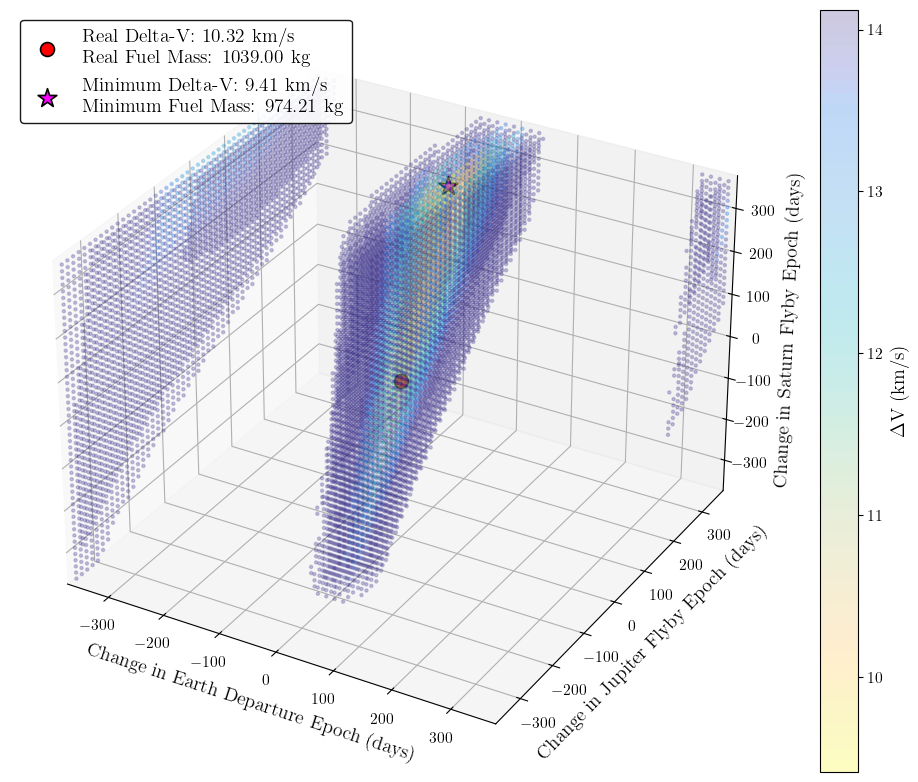

In [90]:
set_font_sizes(14)

# Filter out any extreme values
max_deltav_threshold = 20  # km/s (adjust as needed)
valid_indices = [
    i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold
]

# Extract valid data
valid_departure_mjd = [departure_mjd_change_in_time[i] for i in valid_indices]
valid_jupiter_mjd = [jupiter_flyby_mjd_change_in_time[i] for i in valid_indices]
valid_saturn_mjd = [saturn_flyby_mjd_change_in_time[i] for i in valid_indices]
valid_deltaV = [deltaV_values[i] for i in valid_indices]

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")


scatter = ax.scatter(
    valid_departure_mjd,
    valid_jupiter_mjd,
    valid_saturn_mjd,
    c=valid_deltaV,
    cmap=parula_map(True),
    s=5,
    alpha=0.25,
    norm=colors.Normalize(vmin=min(valid_deltaV), vmax=min(valid_deltaV) * 1.5),
)

# Highlight the REAL delta-V point
ax.scatter(
    [0],
    [0],
    [0],
    color="red",
    s=100,
    marker="o",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg",
)

# Highlight the Minimum Brute Force delta-V point
ax.scatter(
    [date_departure_mjd_BRUTE_MIN - date_departure_mjd],
    [date_flyby_jupiter_mjd_BRUTE_MIN - date_flyby_jupiter_mjd],
    [date_flyby_saturn_mjd_BRUTE_MIN - date_flyby_saturn_mjd],
    color="fuchsia",
    s=200,
    marker="*",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Minimum Delta-V: {deltaV_BRUTE_MIN:.2f} km/s\nMinimum Fuel Mass: {fuel_mass_BRUTE_MIN:.2f} kg",
)

cbar = plt.colorbar(scatter, ax=ax, label="$\Delta$V (km/s)")
cbar.ax.set_ylabel("$\Delta$V (km/s)")  # , fontsize=12)

ax.set_xlabel("Change in Earth Departure Epoch (days)", labelpad=5)  # , fontsize=12)
ax.set_ylabel("Change in Jupiter Flyby Epoch (days)", labelpad=5)  # , fontsize=12)
ax.set_zlabel("Change in Saturn Flyby Epoch (days)", labelpad=5)  # , fontsize=12)
# ax.set_title(r"\textbf{3D Visualisation of Brute Force Problem Space ($\pm$ 365 days bounds)}", fontsize=14)

limit = 375
ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)
ax.set_zlim(-limit, limit)

ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")

plt.tight_layout()
output_figures.save_file(
    "voyager_I_brute_force_contour_3D.png", dpi=500, bbox_inches="tight"
)
# output_figures.save_file("voyager_I_brute_force_contour_3D.svg", dpi=500, bbox_inches="tight")

# ax.view_init(elev=30, azim=45)  # Adjust elevation & azimuth for a better view
plt.show()

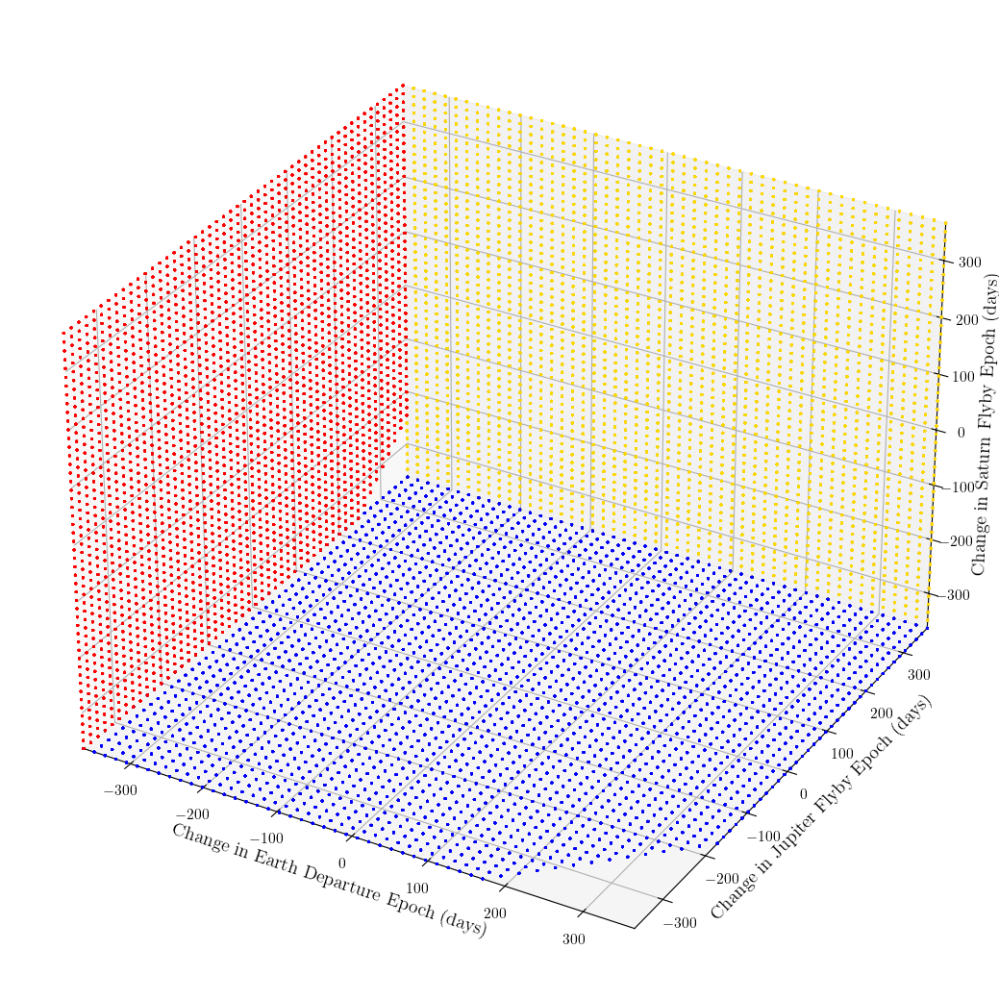

In [91]:
set_font_sizes(14)

valid_departure_mjd = np.array(departure_mjd_change_in_time)
valid_jupiter_mjd = np.array(jupiter_flyby_mjd_change_in_time)
valid_saturn_mjd = np.array(saturn_flyby_mjd_change_in_time)
limit = 365

plt.close("all")  # Close any existing plots
fig = plt.figure(figsize=(15, 12), constrained_layout=False)
plt.subplots_adjust(top=0.9, bottom=0.05)  # Adjust top and bottom margins


ax = fig.add_subplot(111, projection="3d")

# X-Y Plane (Blue) Scatter and Surface
ax.scatter(valid_departure_mjd, valid_jupiter_mjd, -limit, color="blue", s=1, alpha=0.4)
grid_x, grid_y = np.mgrid[
    min(valid_departure_mjd) : max(valid_departure_mjd) : 50j,
    min(valid_jupiter_mjd) : max(valid_jupiter_mjd) : 50j,
]
grid_z = np.full_like(grid_x, -limit)
# ax.plot_surface(grid_x, grid_y, grid_z, color='blue', alpha=0.2)

# Y-Z Plane (Red) Scatter and Surface
ax.scatter(-limit, valid_jupiter_mjd, valid_saturn_mjd, color="red", s=1, alpha=0.4)
grid_y, grid_z = np.mgrid[
    min(valid_jupiter_mjd) : max(valid_jupiter_mjd) : 50j,
    min(valid_saturn_mjd) : max(valid_saturn_mjd) : 50j,
]
grid_x = np.full_like(grid_y, -limit)
# ax.plot_surface(grid_x, grid_y, grid_z, color='red', alpha=0.2)

# X-Z Plane (Gold) Scatter and Surface
ax.scatter(valid_departure_mjd, limit, valid_saturn_mjd, color="gold", s=1, alpha=0.4)
grid_x, grid_z = np.mgrid[
    min(valid_departure_mjd) : max(valid_departure_mjd) : 50j,
    min(valid_saturn_mjd) : max(valid_saturn_mjd) : 50j,
]
grid_y = np.full_like(grid_x, limit)
# ax.plot_surface(grid_x, grid_y, grid_z, color='gold', alpha=0.2)

ax.set_xlabel("Change in Earth Departure Epoch (days)", labelpad=3)  # , fontsize=12)
ax.set_ylabel("Change in Jupiter Flyby Epoch (days)", labelpad=3)  # , fontsize=12)
ax.set_zlabel("Change in Saturn Flyby Epoch (days)", labelpad=2)  # , fontsize=12)
# ax.set_title(r'\textbf{3D Visualisation of Voyager I Brute Force Problem Space ($\pm$ 365 days bounds)}',
# fontsize=14, pad=10, y=1.02)  # Slight vertical adjustment

ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)
ax.set_zlim(-limit, limit)

# output_figures.save_file("voyager_I_brute_force_problem_space.png", dpi=500, bbox_inches="tight", pad_inches=0.2)
plt.show()

### 5) Fixing a Date for Problem Space 2D Contour

In [93]:
%%time


def optimise_trajectory(fix_parameter, spacing=50):

    # Validate input parameter
    if fix_parameter not in ["departure", "jupiter", "saturn"]:
        raise ValueError("Not vaild Input.")

    time_range_LIST = np.linspace(-change_in_time_days, change_in_time_days, spacing)

    # Lists to store results
    deltaV_list = []
    time_range_list_index = []
    dates_list = []

    # Start timing
    start_time = time.time()

    # Determine which loops to run based on fixed parameter
    if fix_parameter == "departure":
        # Fix departure date, vary Jupiter and Saturn
        for j in range(spacing):
            date_flyby_jupiter_mjd_BRUTE = date_flyby_jupiter_mjd + time_range_LIST[j]
            for k in range(spacing):
                date_flyby_saturn_mjd_BRUTE = date_flyby_saturn_mjd + time_range_LIST[k]
                time_range_list_index.append([0, j, k])
                try:
                    deltaV_mission = find_deltaV_mission(
                        date_departure_mjd,
                        date_flyby_jupiter_mjd_BRUTE,
                        date_flyby_saturn_mjd_BRUTE,
                    )
                    deltaV_list.append(deltaV_mission)
                    dates_list.append(
                        [
                            date_departure_mjd,
                            date_flyby_jupiter_mjd_BRUTE,
                            date_flyby_saturn_mjd_BRUTE,
                            deltaV_mission,
                        ]
                    )
                except Exception:
                    deltaV_list.append([1e99, 1e99, {"temp": 1e99}])

    elif fix_parameter == "jupiter":
        # Fix Jupiter flyby date, vary departure and Saturn
        for i in range(spacing):
            date_departure_mjd_BRUTE = date_departure_mjd + time_range_LIST[i]
            for k in range(spacing):
                date_flyby_saturn_mjd_BRUTE = date_flyby_saturn_mjd + time_range_LIST[k]
                time_range_list_index.append([i, 0, k])
                try:
                    deltaV_mission = find_deltaV_mission(
                        date_departure_mjd_BRUTE,
                        date_flyby_jupiter_mjd,
                        date_flyby_saturn_mjd_BRUTE,
                    )
                    deltaV_list.append(deltaV_mission)
                    dates_list.append(
                        [
                            date_departure_mjd_BRUTE,
                            date_flyby_jupiter_mjd,
                            date_flyby_saturn_mjd_BRUTE,
                            deltaV_mission,
                        ]
                    )
                except Exception:
                    deltaV_list.append([1e99, 1e99, {"temp": 1e99}])

    else:  # fix_parameter == 'saturn'
        # Fix Saturn flyby date, vary departure and Jupiter
        for i in range(spacing):
            date_departure_mjd_BRUTE = date_departure_mjd + time_range_LIST[i]
            for j in range(spacing):
                date_flyby_jupiter_mjd_BRUTE = (
                    date_flyby_jupiter_mjd + time_range_LIST[j]
                )
                time_range_list_index.append([i, j, 0])
                try:
                    deltaV_mission = find_deltaV_mission(
                        date_departure_mjd_BRUTE,
                        date_flyby_jupiter_mjd_BRUTE,
                        date_flyby_saturn_mjd,
                    )
                    deltaV_list.append(deltaV_mission)
                    dates_list.append(
                        [
                            date_departure_mjd_BRUTE,
                            date_flyby_jupiter_mjd_BRUTE,
                            date_flyby_saturn_mjd,
                            deltaV_mission,
                        ]
                    )
                except Exception:
                    deltaV_list.append([1e99, 1e99, {"temp": 1e99}])

    # End timing
    end_time = time.time()
    execution_time = end_time - start_time

    # Find minimum deltaV
    min_index = deltaV_list.index(min(deltaV_list, key=lambda x: x[0]))
    deltaV_BRUTE_MIN_2D, fuel_mass_BRUTE_MIN_2D, data_dict_BRUTE_MIN_2D = deltaV_list[
        min_index
    ]

    # Get the time changes that gave minimum deltaV
    change_in_time = time_range_list_index[min_index]

    # Calculate the actual dates for minimum deltaV
    best_dates_BRUTE_MIN_2D = [
        date_departure_mjd + time_range_LIST[change_in_time[0]],
        date_flyby_jupiter_mjd + time_range_LIST[change_in_time[1]],
        date_flyby_saturn_mjd + time_range_LIST[change_in_time[2]],
    ]

    # Prepare data for plotting
    plot_data = {
        "dates_list": dates_list,
        "time_range_LIST": time_range_LIST,
        "fix_parameter": fix_parameter,
    }

    return (
        best_dates_BRUTE_MIN_2D,
        deltaV_BRUTE_MIN_2D,
        fuel_mass_BRUTE_MIN_2D,
        data_dict_BRUTE_MIN_2D,
        execution_time,
        plot_data,
    )

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.2 µs


Figure saved to: Voyager 1 - Figures/voyager_1_brute_force_departure_fixed_2D.png


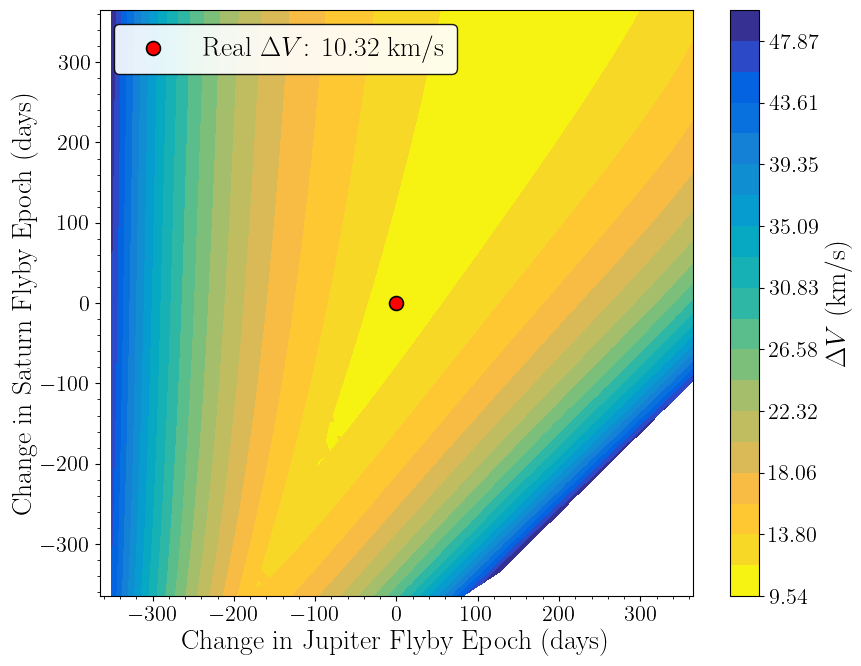

Figure saved to: Voyager 1 - Figures/voyager_1_brute_force_jupiter_fixed_2D.png


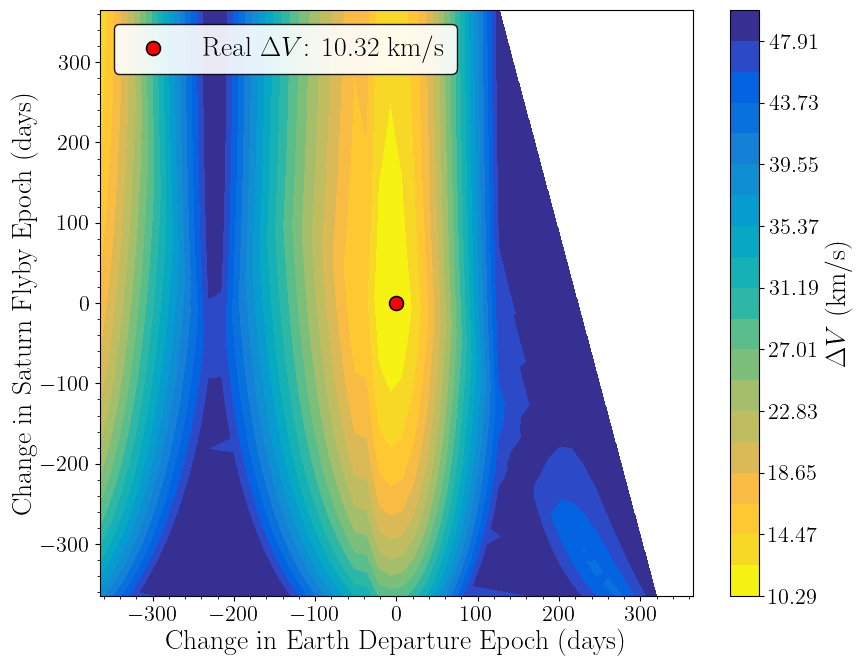

Figure saved to: Voyager 1 - Figures/voyager_1_brute_force_saturn_fixed_2D.png


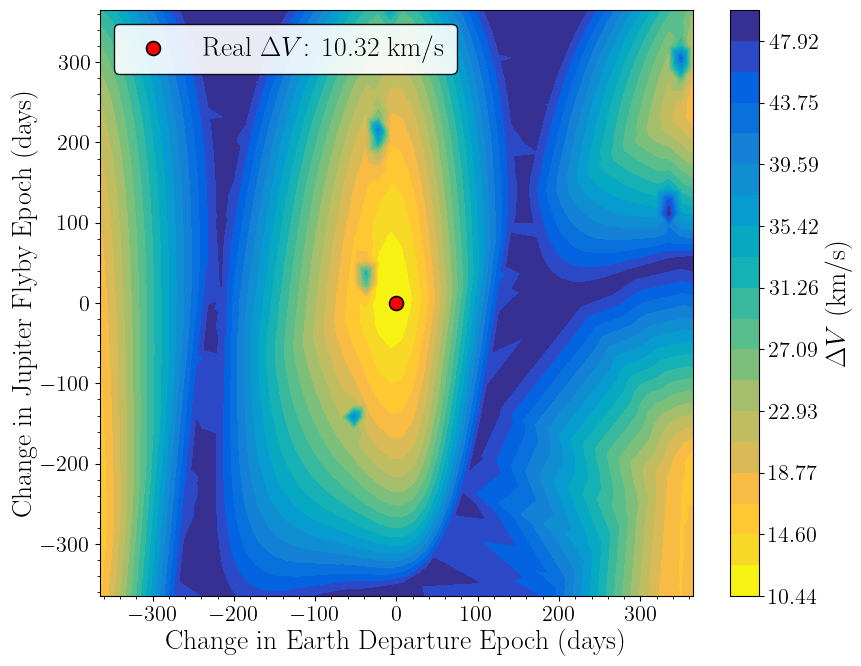

In [94]:
set_font_sizes(20)


def plot_optimisation_results(plot_data, max_deltav_threshold=15):

    dates_list = plot_data["dates_list"]
    fix_parameter = plot_data["fix_parameter"]

    # Determine the x and y axis parameters based on fixed parameter
    if fix_parameter == "departure":
        x_label = "Change in Jupiter Flyby Epoch (days)"
        y_label = "Change in Saturn Flyby Epoch (days)"
        title = r"\textbf{2D Contour Graph of Problem Space with Earth Departure Fixed ($\pm$365 days)}"
        x_mjd_ref = date_flyby_jupiter_mjd
        y_mjd_ref = date_flyby_saturn_mjd
        x_index = 1
        y_index = 2
    elif fix_parameter == "jupiter":
        x_label = "Change in Earth Departure Epoch (days)"
        y_label = "Change in Saturn Flyby Epoch (days)"
        title = r"\textbf{2D Contour Graph of Problem Space with Jupiter Flyby Fixed ($\pm$365 days)}"
        x_mjd_ref = date_departure_mjd
        y_mjd_ref = date_flyby_saturn_mjd
        x_index = 0
        y_index = 2
    else:  # fix_parameter == 'saturn'
        x_label = "Change in Earth Departure Epoch (days)"
        y_label = "Change in Jupiter Flyby Epoch (days)"
        title = r"\textbf{2D Contour Graph of Problem Space with Saturn Flyby Fixed ($\pm$365 days)}"
        x_mjd_ref = date_departure_mjd
        y_mjd_ref = date_flyby_jupiter_mjd
        x_index = 0
        y_index = 1

    # Extract x, y, and deltaV values
    x_mjd = [dates_list[num][x_index] for num in range(len(dates_list))]
    y_mjd = [dates_list[num][y_index] for num in range(len(dates_list))]
    deltaV_values = [dates_list[num][3][0] for num in range(len(dates_list))]

    # Convert to change in days
    x_mjd_change = [(element - x_mjd_ref) for element in x_mjd]
    y_mjd_change = [(element - y_mjd_ref) for element in y_mjd]

    # Filter out invalid values (too high deltaV)
    valid_indices = [
        i for i in range(len(deltaV_values)) if deltaV_values[i] < max_deltav_threshold
    ]

    # Extract valid data
    valid_x_mjd = [x_mjd_change[i] for i in valid_indices]
    valid_y_mjd = [y_mjd_change[i] for i in valid_indices]
    valid_deltaV = [deltaV_values[i] for i in valid_indices]

    # Grid sizes for interpolation
    x_range = np.linspace(min(valid_x_mjd), max(valid_x_mjd), 1000)
    y_range = np.linspace(min(valid_y_mjd), max(valid_y_mjd), 1000)

    # Create meshgrid
    X, Y = np.meshgrid(x_range, y_range)

    # Interpolate deltaV values to the grid using linear interpolation
    Z = griddata((valid_x_mjd, valid_y_mjd), valid_deltaV, (X, Y), method="linear")

    # Create the contour plot
    fig, ax = plt.subplots(figsize=(9, 7))

    plt.rc("text", usetex=True)
    plt.rc("font", family="serif")

    cmap = parula_map(True)

    # Define contour levels within the specified range
    min_deltav = np.nanmin(Z)
    levels = np.linspace(min_deltav, max_deltav_threshold, 20)

    # Create filled contour plot
    contour = ax.contourf(
        X,
        Y,
        Z,
        levels=levels,
        cmap=cmap,
        norm=colors.Normalize(vmin=min_deltav, vmax=max_deltav_threshold),
    )

    # Add colorbar
    cbar = plt.colorbar(contour, ax=ax, label=r"$\Delta V$ (km/s)")
    # cbar.ax.tick_params(labelsize=12)

    # Add contour lines
    # contour_lines = ax.contour(
    #     X, Y, Z, levels=20, colors="white", linewidths=0.5, alpha=0.7
    # )
    # ax.clabel(contour_lines, inline=True, fmt="%.2f")  # fontsize=8)

    # Find minimum deltaV point
    min_idx = valid_deltaV.index(min(valid_deltaV))
    min_x = valid_x_mjd[min_idx]
    min_y = valid_y_mjd[min_idx]
    min_dv = valid_deltaV[min_idx]

    # Plot original and minimum deltaV points
    ax.scatter(
        0,
        0,
        color="red",
        s=100,
        marker="o",
        edgecolors="black",
        linewidth=1.2,
        label=r"Real $\Delta V$: {:.2f} km/s".format(deltaV_REAL),
    )

    # ax.scatter(min_x, min_y, color='fuchsia', s=200, marker='*', edgecolors='black', linewidth=1.2,
    #          label=f'Minimum $\Delta V$: {min_dv:.2f} km/s')

    ax.set_xlabel(x_label, labelpad=2)  # , fontsize=12)
    ax.set_ylabel(y_label, labelpad=2)  # , fontsize=12)
    # ax.set_title(title, pad=15, fontsize=14)

    ax.minorticks_on()
    ax.tick_params(
        axis="both",
        which="major",
    )  # labelsize=12)
    ax.tick_params(
        axis="both",
        which="minor",
    )  # labelsize=10)

    plt.xlim(-365, 365)
    plt.ylim(-365, 365)

    plt.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")

    plt.tight_layout()

    output_figures.save_file(
        f"voyager_1_brute_force_{fix_parameter}_fixed_2D.png",
        dpi=500,
        bbox_inches="tight",
    )

    plt.show()


fix_parameter = "departure"

BRUTE_MIN_2D_fixed_departure = optimise_trajectory("departure", 50)
BRUTE_MIN_2D_fixed_jupiter = optimise_trajectory("jupiter", 50)
BRUTE_MIN_2D_fixed_saturn = optimise_trajectory("saturn", 50)

plot_optimisation_results(BRUTE_MIN_2D_fixed_departure[-1], 50)
plot_optimisation_results(BRUTE_MIN_2D_fixed_jupiter[-1], 50)
plot_optimisation_results(BRUTE_MIN_2D_fixed_saturn[-1], 50)

---
## Nelder-Mead Simplex Algorithm (Fmin)

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.fmin.html

https://jasoncantarella.com/downloads/NelderMeadProof.pdf

In [96]:
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

In [97]:
%%time

if global_flag:
    iterations = []
    iteration_count = []

    # Initial guess
    initial_guess = np.array(
        [date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd]
    )

    def objective_function(dates):
        # Ensure dates stay within ±365 days of the initial guess
        date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd = dates
        iteration_count.append(dates.copy())

        # Ensure dates stay within ±365 days of the initial guess
        lower_bound = initial_guess - 365
        upper_bound = initial_guess + 365

        # Check if any value is outside bounds
        if np.any(dates < lower_bound) or np.any(dates > upper_bound):
            deltaV = 1e99
        else:
            try:
                deltaV, fuel_mass, data_dict = find_deltaV_mission(
                    date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd
                )

                # Store the current iteration (dates)
                iterations.append(dates.copy())
            except Exception:
                deltaV = 1e99  # Assign a high penalty for invalid solutions

        return deltaV  # Minimise Delta-V

    # Start timing
    start_time = time.time()

    # Run optimisation using `fmin` with manual bounds enforcement
    optimal_dates = fmin(objective_function, initial_guess, disp=True)

    iteration_count = len(iteration_count)

    # Extract optimised dates
    date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN = (
        optimal_dates
    )

    # Compute Delta-V and fuel mass at optimised dates
    deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN = find_deltaV_mission(
        date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN
    )

    # Display results
    print(f"Minimum Delta-V: {deltaV_FMIN:.4f} km/s")
    print(f"Optimal Departure Date (MJD): {date_departure_mjd_FMIN:.2f}")
    print(f"Optimal Jupiter Flyby Date (MJD): {date_flyby_jupiter_mjd_FMIN:.2f}")
    print(f"Optimal Saturn Flyby Date (MJD): {date_flyby_saturn_mjd_FMIN:.2f}")

    # Convert to calendar dates
    print("\nIn calendar dates:")
    print(f"Departure: {MJD_to_TT_calander_date(date_departure_mjd_FMIN)}")
    print(f"Jupiter flyby: {MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN)}")
    print(f"Saturn flyby: {MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN)}")

    # End timing
    end_time = time.time()
    execution_time_FMIN = end_time - start_time
    print(f"\nExecution Time: {execution_time_FMIN:.4f} seconds")
    print(f"No. of Iterations: {iteration_count}")

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 9.06 µs


In [98]:
if global_flag:
    filename_brute = output_pickle.get_path("fmin_results_V1.pkl")

    results_brute = {
        "optimal_dates": optimal_dates,
        "execution_time_FMIN": execution_time_FMIN,
        "iterations": iterations,
        "iteration_count": iteration_count,
    }
    with open(filename_brute, "wb") as f:
        pickle.dump(results_brute, f)

In [99]:
filename_brute = output_pickle.get_path("fmin_results_V1.pkl")

with open(filename_brute, "rb") as f:
    data = pickle.load(f)

optimal_dates = data["optimal_dates"]
execution_time_FMIN = data["execution_time_FMIN"]
iterations = data["iterations"]
iteration_count = data["iteration_count"]

if not global_flag:
    # Extract optimised dates
    date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN = (
        optimal_dates
    )

    # Compute Delta-V and fuel mass at optimised dates
    deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN = find_deltaV_mission(
        date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN
    )

    # Display results
    print(f"Minimum Delta-V: {deltaV_FMIN:.4f} km/s")
    print(f"Optimal Departure Date (MJD): {date_departure_mjd_FMIN:.2f}")
    print(f"Optimal Jupiter Flyby Date (MJD): {date_flyby_jupiter_mjd_FMIN:.2f}")
    print(f"Optimal Saturn Flyby Date (MJD): {date_flyby_saturn_mjd_FMIN:.2f}")

    # Convert to calendar dates
    print("\nIn calendar dates:")
    print(f"Departure: {MJD_to_TT_calander_date(date_departure_mjd_FMIN)}")
    print(f"Jupiter flyby: {MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN)}")
    print(f"Saturn flyby: {MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN)}")

    print(f"\nExecution Time: {execution_time_FMIN:.4f} seconds")
    print(f"No. of Iterations: {iteration_count}")

Minimum Delta-V: 9.3880 km/s
Optimal Departure Date (MJD): 43388.37
Optimal Jupiter Flyby Date (MJD): 44099.45
Optimal Saturn Flyby Date (MJD): 44920.99

In calendar dates:
Departure: 1977-09-02 08:54:45.131
Jupiter flyby: 1979-08-14 10:52:57.199
Saturn flyby: 1981-11-12 23:45:59.991

Execution Time: 1.1930 seconds
No. of Iterations: 329


In [100]:
# iterations

In [101]:
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN = find_deltaV_mission(
    date_departure_mjd_FMIN, date_flyby_jupiter_mjd_FMIN, date_flyby_saturn_mjd_FMIN
)
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN

(9.38803007413873,
 972.2489748561145,
 {'deltaV_injection (km/s)': 9.388030073914551,
  'deltaV_jupiter (km/s)': 2.24178009489151e-10,
  'rp_jupiter (km)': 2584504.202308533,
  'vp_jupiter (km/s)': 12.313400192809324,
  'vp_esc_jupiter (km/s)': 9.902310866411128,
  'deflection_jupiter (deg)': 94.79802898045975,
  'tof (days)': 1532.6189219878652})

In [102]:
print("Earth-Jupiter:", date_flyby_jupiter_mjd_FMIN - date_departure_mjd_FMIN, "days")
print(
    "Jupiter-Saturn:", date_flyby_saturn_mjd_FMIN - date_flyby_jupiter_mjd_FMIN, "days"
)

Earth-Jupiter: 711.0820841265449 days
Jupiter-Saturn: 821.5368378613202 days


In [103]:
dates_list_FMIN = [
    date_departure_mjd_FMIN,
    date_flyby_jupiter_mjd_FMIN,
    date_flyby_saturn_mjd_FMIN,
]
dates_list_FMIN

[43388.37135568234, 44099.45343980889, 44920.99027767021]

In [104]:
change_in_dates_list_FMIN = [
    (date_departure_mjd_FMIN - date_departure_mjd),
    (date_flyby_jupiter_mjd_FMIN - date_flyby_jupiter_mjd),
    (date_flyby_saturn_mjd_FMIN - date_flyby_saturn_mjd),
]
change_in_dates_list_FMIN

[-6.009199873347825, 161.94996758687194, 364.9999998923158]

In [105]:
date_departure_FMIN = MJD_to_TT_calander_date(date_departure_mjd_FMIN)
date_flyby_jupiter_FMIN = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN)
date_flyby_saturn_FMIN = MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_FMIN))

print(
    "Date of Jupiter Flyby (Min):", MJD_to_TT_calander_date(date_flyby_jupiter_mjd_FMIN)
)

print(
    "Date of Saturn Flyby (Min):", MJD_to_TT_calander_date(date_flyby_saturn_mjd_FMIN)
)

Date of Departure (Min): 1977-09-02 08:54:45.131
Date of Jupiter Flyby (Min): 1979-08-14 10:52:57.199
Date of Saturn Flyby (Min): 1981-11-12 23:45:59.991


### Contour Graph of Problem Space

Figure saved to: Voyager 1 - Figures/voyager_I_fmin_contour_3D.png


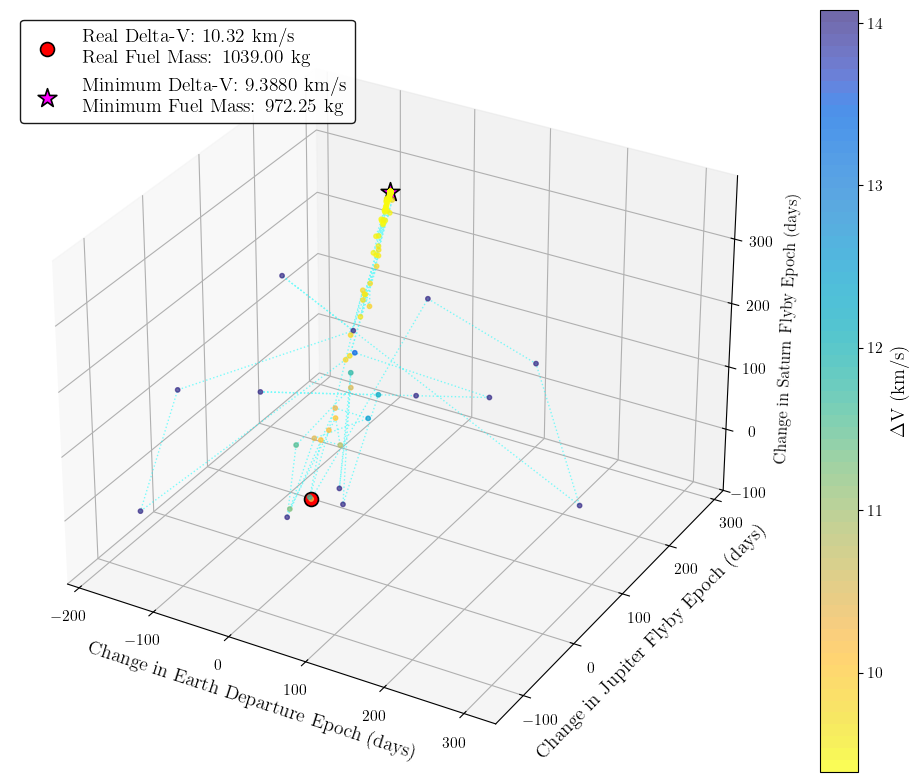

In [107]:
set_font_sizes(14)

# Extract the dates from the iterations list
departure_dates_FMIN = np.array([iter[0] for iter in iterations])
jupiter_flyby_dates_FMIN = np.array([iter[1] for iter in iterations])
saturn_flyby_dates_FMIN = np.array([iter[2] for iter in iterations])
# Calculate the corresponding deltaV values for the iterations
deltaV_values_FMIN = []
for dates in iterations:
    try:
        deltaV, _, _ = find_deltaV_mission(*dates)
    except Exception:
        deltaV_values_FMIN.append(1e99)
        continue
    deltaV_values_FMIN.append(deltaV)
# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")
# Scatter plot with color based on deltaV
scatter = ax.scatter(
    departure_dates_FMIN - date_departure_mjd,
    jupiter_flyby_dates_FMIN - date_flyby_jupiter_mjd,
    saturn_flyby_dates_FMIN - date_flyby_saturn_mjd,
    c=deltaV_values_FMIN,
    cmap=parula_map(True),
    s=10,
    alpha=0.7,
    norm=plt.Normalize(
        vmin=min(deltaV_values_FMIN), vmax=min(deltaV_values_FMIN) * 1.5
    ),
)
ax.plot(
    departure_dates_FMIN - date_departure_mjd,
    jupiter_flyby_dates_FMIN - date_flyby_jupiter_mjd,
    saturn_flyby_dates_FMIN - date_flyby_saturn_mjd,
    linestyle=":",
    color="cyan",
    markersize=6,
    linewidth=1,
    alpha=0.5,
)
ax.scatter(
    [0],
    [0],
    [0],
    color="red",
    s=100,
    marker="o",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg",
)
ax.scatter(
    date_departure_mjd_FMIN - date_departure_mjd,
    date_flyby_jupiter_mjd_FMIN - date_flyby_jupiter_mjd,
    date_flyby_saturn_mjd_FMIN - date_flyby_saturn_mjd,
    color="fuchsia",
    s=200,
    marker="*",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Minimum Delta-V: {deltaV_FMIN:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_FMIN:.2f} kg",
)
cbar = plt.colorbar(scatter, ax=ax, label="$\Delta$V (km/s)")
cbar.ax.set_ylabel(
    "$\Delta$V (km/s)",
)  # fontsize=12)
ax.set_xlabel(
    "Change in Earth Departure Epoch (days)",
)  # fontsize=12)
ax.set_ylabel(
    "Change in Jupiter Flyby Epoch (days)",
)  # fontsize=12)
ax.set_zlabel("Change in Saturn Flyby Epoch (days)", fontsize=12)
# ax.set_title(r'\textbf{3D Visualisation of Fmin Problem Space ($\pm$ 365 days bounds)}', fontsize=14)
ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")
# Set axis limits
# limit = 375
# ax.set_xlim(-limit, limit)
# ax.set_ylim(-limit, limit)
# ax.set_zlim(-limit, limit)
# Show the plot
plt.tight_layout()
output_figures.save_file("voyager_I_fmin_contour_3D.png", dpi=500, bbox_inches="tight")
plt.show()

In [108]:
# find_deltaV_mission(departure_dates[-1], jupiter_flyby_dates[-1], saturn_flyby_dates[-1])
change_in_dates_list_FMIN

[-6.009199873347825, 161.94996758687194, 364.9999998923158]

---
## Genetic Algorithm (GA)

In [110]:
min_departure_date = date_departure_mjd - change_in_time_days
max_departure_date = date_departure_mjd + change_in_time_days

min_flyby_jupiter = date_flyby_jupiter_mjd - change_in_time_days
max_flyby_jupiter = date_flyby_jupiter_mjd + change_in_time_days

min_flyby_saturn = date_flyby_saturn_mjd - change_in_time_days
max_flyby_saturn = date_flyby_saturn_mjd + change_in_time_days

### 1) Generate Initial Population

In [112]:
def initial_population(n_population):
    # Generates initial population within mission constraints.
    population = []
    population.append(dates_REAL)

    # Add interval to generate population
    for num in range(n_population - 1):
        date_departure_pop = random.uniform(min_departure_date, max_departure_date)
        date_flyby_jupiter_pop = random.uniform(min_flyby_jupiter, max_flyby_jupiter)
        date_flyby_saturn_pop = random.uniform(min_flyby_saturn, max_flyby_saturn)

        # Ensure chronological order of mission events
        date_flyby_jupiter_pop = max(date_flyby_jupiter_pop, date_departure_pop)
        date_flyby_saturn_pop = max(date_flyby_saturn_pop, date_flyby_jupiter_pop)

        population.append(
            [date_departure_pop, date_flyby_jupiter_pop, date_flyby_saturn_pop]
        )

    return population


# pop = initial_population(2000)

### 2) Evaluation to Get Fitness

In [114]:
def fitness(individual):
    # Evaluates fitness based on deltaV_total minimisation.
    try:
        date_departure_mjd, date_flyby_jupiter_mjd, date_flyby_saturn_mjd = individual
        deltaV, fuel_mass, data_dict = find_deltaV_mission(*individual)
    except Exception:
        deltaV = 1e6  # np.inf  # Assign a large penalty for infeasible solutions

    return 1 / (deltaV + 1e-6)  # Avoid division by zero


# np.array([fitness(ind) for ind in pop])

### 3) Sort Population by Fitness

In [116]:
def sort_population_by_fitness(population, fitness_scores, n_population):
    sorted_indices = np.argsort(fitness_scores)[::-1]  # Sort by highest fitness
    population = [
        population[i] for i in sorted_indices[:n_population]
    ]  # Ensures length population is 'n_population'
    return population

### 4) Elitism

https://algorithmafternoon.com/genetic/elitist_genetic_algorithm/

In [118]:
def elitism(population, n_elite):
    elite_individuals = population[:n_elite]
    return elite_individuals

### 5) Selection

#### Tournament Selection

In [121]:
def tournament_selection(population, fitness_scores, tournament_size=3):
    # Select random individuals for the tournament
    selected_indices = np.random.choice(len(population), tournament_size, replace=False)

    # Find the best individual in the tournament
    tournament_fitness = [fitness_scores[i] for i in selected_indices]
    winner_idx = selected_indices[np.argmax(tournament_fitness)]

    return population[winner_idx]

### 6) Crossover

#### Simulated Binary Crossover (SBX)

https://pymoo.org/operators/crossover.html

In [124]:
def sbx_crossover(parent_1, parent_2, eta):
    offspring_1 = parent_1[:]
    offspring_2 = parent_2[:]

    for i in range(len(parent_1)):
        u = random.random()
        if u <= 0.5:
            beta = (2 * u) ** (1 / (eta + 1))
        else:
            beta = (1 / (2 * (1 - u))) ** (1 / (eta + 1))

        # Generate offspring
        offspring_1[i] = 0.5 * ((1 + beta) * parent_1[i] + (1 - beta) * parent_2[i])
        offspring_2[i] = 0.5 * ((1 - beta) * parent_1[i] + (1 + beta) * parent_2[i])

    return offspring_1, offspring_2

### 7) Mutation (Random Perturbations)

In [126]:
def gaussian_mutation(individual):
    # Create a copy to avoid modifying the original
    mutated = individual.copy()

    # Define bounds for each parameter
    bounds = [
        (min_departure_date, max_departure_date),
        (min_flyby_jupiter, max_flyby_jupiter),
        (min_flyby_saturn, max_flyby_saturn),
    ]

    # Select random index to mutate
    index = random.randint(0, 2)

    # Calculate parameter range
    param_range = bounds[index][1] - bounds[index][0]

    # Apply Gaussian mutation with standard deviation proportional to parameter range
    sigma = 0.05 * param_range  # 5% of the parameter range
    delta = random.gauss(0, sigma)
    mutated[index] += delta

    # Ensure value stays within bounds
    mutated[index] = max(min(mutated[index], bounds[index][1]), bounds[index][0])

    return mutated

### 8) Running GA

1. Initialise population
2. Sort population
3. Start Loop
4. Evaluate fitness
5. Select parents (roulette wheel)
6. Crossover (SBX or copy)
7. Mutation
8. Combine Offspring & Elite Individuals
9. Filter for constraints
10. Sort & truncate population 
11. Elitism (store best individuals)
12. Does it satisfy termination condition
13. If NO, then repeat loop. If YES, end loop
14. Store best (optimal) individual solution

In [128]:
def run_genetic_algorithm(
    n_population,
    n_elite,
    crossover_per,
    mutation_per,
    n_generations,
    population_per_generation,
):
    # n_generations = n_generations + 1
    population = initial_population(n_population)  # Generate initial population

    # Evaluate fitness function
    fitness_scores_temp = np.array([fitness(ind) for ind in population])
    # Sorts population by fitness value
    population_temp = sort_population_by_fitness(
        population, fitness_scores_temp, n_population
    )

    population_per_generation.append(population_temp)
    elite_individuals = []

    for generation in range(0, n_generations):
        start_time = time.time()
        # Evaluate fitness function
        fitness_scores = np.array([fitness(ind) for ind in population])

        # Sorts population by fitness value
        population = sort_population_by_fitness(
            population, fitness_scores, n_population
        )

        # Print progress
        best_individual = population[0]
        best_deltaV, best_fuel_mass, _ = find_deltaV_mission(*best_individual)
        print(
            f"Generation {generation}: Best Delta-V = {best_deltaV:.6f} km/s, Fitness = {fitness(best_individual):.6f}"
        )

        # Apply elitism - preserve the best individuals
        if n_elite != 0:
            elite_individuals = elitism(population, n_elite)

        # Select parents for potential crossover - select enough for the whole population
        parents_list = []
        for i in range(n_population):
            parents_list.append(tournament_selection(population, fitness_scores))

        # Perform crossover with crossover probability
        offspring_list = []
        for i in range(0, len(parents_list) - 1, 2):
            # Apply crossover based on crossover probability
            if random.random() < crossover_per:
                offspring_1, offspring_2 = sbx_crossover(
                    parents_list[i], parents_list[i + 1], eta=1.5
                )
            else:
                # If no crossover, children are exact copies of parents
                offspring_1, offspring_2 = parents_list[i][:], parents_list[i + 1][:]

            offspring_list.extend([offspring_1, offspring_2])

        # Perform mutation
        for i in range(len(offspring_list)):
            if random.random() < mutation_per:
                offspring_list[i] = gaussian_mutation(offspring_list[i])

        # Combine elite individuals, parents and offspring
        mixed_population = offspring_list + elite_individuals

        # Filter solutions that meet the mission constraints
        mixed_population = [
            ind
            for ind in mixed_population
            if np.abs(ind[0] - date_departure_mjd) <= change_in_time_days
            and np.abs(ind[1] - date_flyby_jupiter_mjd) <= change_in_time_days
            and np.abs(ind[2] - date_flyby_saturn_mjd) <= change_in_time_days
        ]

        mixed_population = [ind for ind in mixed_population if ind[0] < ind[1] < ind[2]]

        # Ensure population is not empty (if all individuals were filtered out)
        if not mixed_population:
            mixed_population = (
                offspring_list + elite_individuals
            )  # Restore full population if filtering removed all

        # Ensure population size remains constant (selection 'n_population' best individuals)
        fitness_scores = np.array([fitness(ind) for ind in mixed_population])
        population = sort_population_by_fitness(
            mixed_population, fitness_scores, n_population
        )

        # Store current population
        population_per_generation.append(population)

        end_time = time.time()
        # print(end_time - start_time)

    # Return the best-found solution
    best_individual = population[0]
    best_list = best_deltaV, best_fuel_mass, best_data = find_deltaV_mission(
        *best_individual
    )
    print(
        f"Generation {n_generations}: Best Delta-V = {best_deltaV:.6f} km/s, Fitness = {fitness(best_individual):.6f}"
    )

    print("\nFinal Optimised Solution:")
    print(f"Departure Date (MJD): {best_individual[0]:.2f}")
    print(f"Jupiter Flyby Date (MJD): {best_individual[1]:.2f}")
    print(f"Saturn Flyby Date (MJD): {best_individual[2]:.2f}")
    print(f"Total deltaV: {best_deltaV:.6f} km/s")

    return best_individual, best_list, population_per_generation

In [129]:
# n_population = 2000
# n_elite = 10
# crossover_per = 0.9
# mutation_per = 0.3
# n_generations = 20

# n_population = 1500
# n_elite = 10
# crossover_per = 0.9
# mutation_per = 0.35
# n_generations = 70

# n_population = 300
# n_elite = 10
# crossover_per = 0.9
# mutation_per = 0.35
# n_generations = 50

n_population = 500
n_elite = 25
crossover_per = 0.9
mutation_per = 0.1
n_generations = 70

In [130]:
%%time

if global_flag:

    # Start timing
    start_time = time.time()

    # Run the Genetic Algorithm
    best_individual, best_mission_data, population_per_generation = (
        run_genetic_algorithm(
            n_population, n_elite, crossover_per, mutation_per, n_generations, []
        )
    )

    # End timing
    end_time = time.time()

    execution_time_GA = end_time - start_time

    print(f"\nExecution Time: {execution_time_GA:.4f} seconds\n")

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.01 µs


In [131]:
if global_flag:
    filename_GA = output_pickle.get_path("ga_results_V1.pkl")

    results_GA = {
        "Best Individual": best_individual,
        "Best Mission Data": best_mission_data,
        "Population Per Generation": population_per_generation,
        "execution_time_GA": execution_time_GA,
    }

    with open(filename_GA, "wb") as f:
        pickle.dump(results_GA, f)

In [132]:
filename_GA = output_pickle.get_path("ga_results_V1.pkl")

with open(filename_GA, "rb") as f:
    data = pickle.load(f)

best_individual = data["Best Individual"]
best_mission_data = data["Best Mission Data"]
population_per_generation = data["Population Per Generation"]
execution_time_GA = data["execution_time_GA"]

if not global_flag:
    for gen in range(len(population_per_generation)):
        best_individual = population_per_generation[gen][0]
        best_deltaV, best_fuel_mass, _ = find_deltaV_mission(*best_individual)
        print(
            f"Generation {gen}: Best Delta-V = {best_deltaV:.6f} km/s, Fitness = {fitness(best_individual):.6f}"
        )

    # Return the best-found solution
    best_individual = population_per_generation[-1][0]
    best_list = best_deltaV, best_fuel_mass, best_data = find_deltaV_mission(
        *best_individual
    )

    print("\nFinal Optimised Solution:")
    print(f"Departure Date (MJD): {best_individual[0]:.2f}")
    print(f"Jupiter Flyby Date (MJD): {best_individual[1]:.2f}")
    print(f"Saturn Flyby Date (MJD): {best_individual[2]:.2f}")
    print(f"Total deltaV: {best_deltaV:.6f} km/s")

    print(f"\nExecution Time: {execution_time_GA:.4f} seconds\n")

Generation 0: Best Delta-V = 10.043293 km/s, Fitness = 0.099569
Generation 1: Best Delta-V = 9.794174 km/s, Fitness = 0.102102
Generation 2: Best Delta-V = 9.794174 km/s, Fitness = 0.102102
Generation 3: Best Delta-V = 9.522760 km/s, Fitness = 0.105012
Generation 4: Best Delta-V = 9.522760 km/s, Fitness = 0.105012
Generation 5: Best Delta-V = 9.462443 km/s, Fitness = 0.105681
Generation 6: Best Delta-V = 9.462443 km/s, Fitness = 0.105681
Generation 7: Best Delta-V = 9.446120 km/s, Fitness = 0.105864
Generation 8: Best Delta-V = 9.429904 km/s, Fitness = 0.106046
Generation 9: Best Delta-V = 9.421919 km/s, Fitness = 0.106135
Generation 10: Best Delta-V = 9.417954 km/s, Fitness = 0.106180
Generation 11: Best Delta-V = 9.414412 km/s, Fitness = 0.106220
Generation 12: Best Delta-V = 9.406100 km/s, Fitness = 0.106314
Generation 13: Best Delta-V = 9.394794 km/s, Fitness = 0.106442
Generation 14: Best Delta-V = 9.393248 km/s, Fitness = 0.106459
Generation 15: Best Delta-V = 9.393248 km/s, Fitn

In [133]:
best_solutions_per_generation = [element[0] for element in population_per_generation]
best_solutions_per_generation, len(best_solutions_per_generation)

([[43387.745088354815, 44006.21245305325, 44740.28425157337],
  [43391.19929134049, 44072.659267221126, 44815.67997735821],
  [43391.19929134049, 44072.659267221126, 44815.67997735821],
  [43391.84989451345, 44070.21854001568, 44850.48573577571],
  [43391.84989451345, 44070.21854001568, 44850.48573577571],
  [43388.74211565522, 44069.83844509122, 44848.70277881373],
  [43388.74211565522, 44069.83844509122, 44848.70277881373],
  [43387.08366978521, 44079.521665315995, 44870.78380397384],
  [43390.08747405386, 44090.95114395746, 44897.697138256866],
  [43387.304703594426, 44090.858593189216, 44902.145681568996],
  [43389.92537982116, 44090.34102446379, 44897.96066248059],
  [43388.62758545715, 44088.30624964384, 44892.97048093891],
  [43388.992382092256, 44092.16757921139, 44902.98905119603],
  [43389.11293258359, 44099.872587046324, 44920.99027777789],
  [43389.20355813182, 44098.38878988047, 44918.19837711141],
  [43389.20355813182, 44098.38878988047, 44918.19837711141],
  [43388.65312

In [134]:
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

### 9) GA Result Analysis

In [136]:
deltaV_GA, fuel_mass_GA, data_dict_GA = find_deltaV_mission(*best_individual)
deltaV_GA, fuel_mass_GA, data_dict_GA

(9.388030090634013,
 972.2489760783692,
 {'deltaV_injection (km/s)': 9.388030089505241,
  'deltaV_jupiter (km/s)': 1.128771742742174e-09,
  'rp_jupiter (km)': 2584504.0014122305,
  'vp_jupiter (km/s)': 12.313401660031868,
  'vp_esc_jupiter (km/s)': 9.902311251269808,
  'deflection_jupiter (deg)': 94.79796238687835,
  'tof (days)': 1532.6170664711608})

In [137]:
date_departure_mjd_GA = best_individual[0]
date_flyby_jupiter_mjd_GA = best_individual[1]
date_flyby_saturn_mjd_GA = best_individual[2]

dates_list_GA = best_individual
dates_list_GA

[43388.3732065305, 44099.4536062653, 44920.99027300166]

In [138]:
print(f"Difference for date_departure: {date_departure_mjd - date_departure_mjd_GA}")
print(
    f"Difference for date_flyby_jupiter: {date_flyby_jupiter_mjd - date_flyby_jupiter_mjd_GA}"
)
print(
    f"Difference for date_flyby_saturn: {date_flyby_saturn_mjd - date_flyby_saturn_mjd_GA}\n"
)

change_in_dates_list_GA = [
    (date_departure_mjd_GA - date_departure_mjd),
    (date_flyby_jupiter_mjd_GA - date_flyby_jupiter_mjd),
    (date_flyby_saturn_mjd_GA - date_flyby_saturn_mjd),
]
change_in_dates_list_GA

Difference for date_departure: 6.007349025188887
Difference for date_flyby_jupiter: -161.95013404328347
Difference for date_flyby_saturn: -364.9999952237704



[-6.007349025188887, 161.95013404328347, 364.9999952237704]

In [139]:
print("Earth-Jupiter:", date_flyby_jupiter_mjd_GA - date_departure_mjd_GA, "days")
print("Jupiter-Saturn:", date_flyby_saturn_mjd_GA - date_flyby_jupiter_mjd_GA, "days")

Earth-Jupiter: 711.0803997347975 days
Jupiter-Saturn: 821.5366667363633 days


In [140]:
date_departure_GA = MJD_to_TT_calander_date(date_departure_mjd_GA)
date_flyby_jupiter_GA = MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA)
date_flyby_saturn_GA = MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA)

print("Date of Departure (Min):", MJD_to_TT_calander_date(date_departure_mjd_GA))

print(
    "Date of Jupiter Flyby (Min):", MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA)
)

print("Date of Saturn Flyby (Min):", MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA))

print([date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA])

Date of Departure (Min): 1977-09-02 08:57:25.044
Date of Jupiter Flyby (Min): 1979-08-14 10:53:11.581
Date of Saturn Flyby (Min): 1981-11-12 23:45:59.587
['1977-09-02 08:57:25.044', '1979-08-14 10:53:11.581', '1981-11-12 23:45:59.587']


#### Objective Function vs No. of Generations

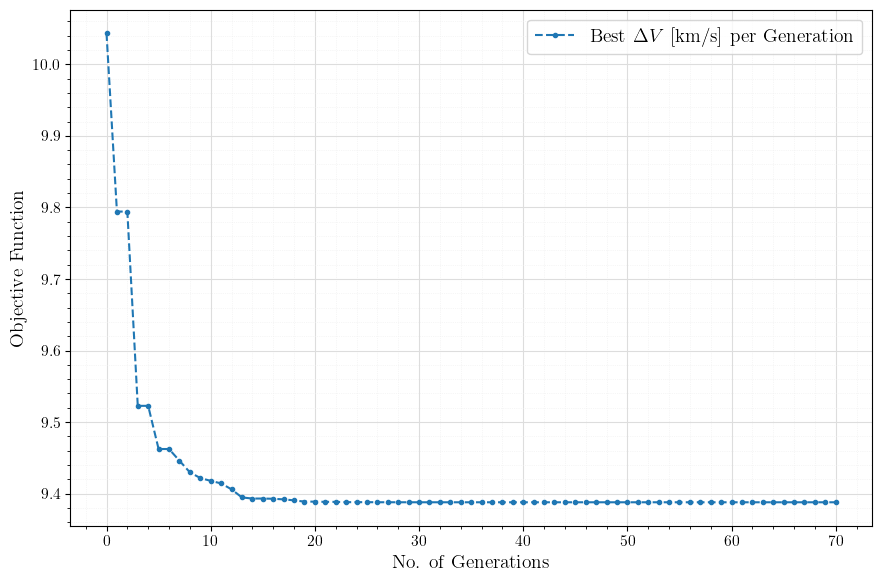

In [142]:
generations = list(
    range(len(best_solutions_per_generation))
)  # X-axis (Generation numbers)
deltaV_values_GA = []  # Y-axis (Best Delta V per generation)

for solution in best_solutions_per_generation:
    best_deltaV, best_fuel_mass, _ = find_deltaV_mission(
        *solution
    )  # Compute Delta V for each best solution
    deltaV_values_GA.append(best_deltaV)

# Plot the data
fig, ax = plt.subplots(figsize=(9, 6))

plt.plot(
    generations[:],
    deltaV_values_GA[:],
    marker=".",
    linestyle="--",
    label="Best $\Delta V$ [km/s] per Generation",
)

plt.xlabel("No. of Generations")
plt.ylabel("Objective Function")

# plt.title(r"\textbf{Objective Function vs No. of Generations}", pad=10, fontsize=14)

plt.legend(loc="best")

# Improve grid and ticks
ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax.minorticks_on()

# Customize tick parameters
ax.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)
ax.tick_params(
    axis="both",
    which="minor",
)  # labelsize=10)

plt.tight_layout()

# Show plot
plt.show()

#### Fitness Function vs No. of Generations

Figure saved to: Voyager 1 - Figures/voyager_I_GA_fitness_function.png


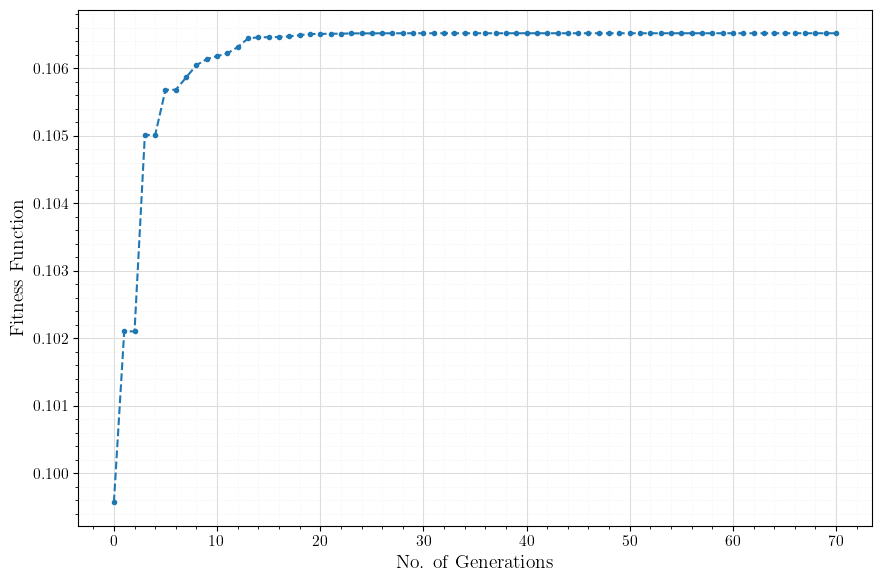

In [144]:
fitness_values_deltaV = 1 / np.array(deltaV_values_GA)

fig, ax = plt.subplots(figsize=(9, 6))

plt.plot(
    generations,
    fitness_values_deltaV,
    marker=".",
    linestyle="--",
    label="Fitness Function $(1/\Delta V)$ per Generation",
)

plt.xlabel(
    "No. of Generations",
)  # fontsize=12)
plt.ylabel(
    "Fitness Function",
)  # fontsize=12)

# plt.title(r"\textbf{Fitness Function vs No. of Generations}", pad=10, fontsize=14)

# Improve grid and ticks
ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax.minorticks_on()

# Customise tick parameters
ax.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)
ax.tick_params(
    axis="both",
    which="minor",
)  # labelsize=10)

plt.tight_layout()

output_figures.save_file(
    "voyager_I_GA_fitness_function.png", dpi=500, bbox_inches="tight"
)

# Show plot
plt.show()

#### Objective \& Fitness

Figure saved to: Voyager 1 - Figures/voyager_I_GA_fitness_objective.png


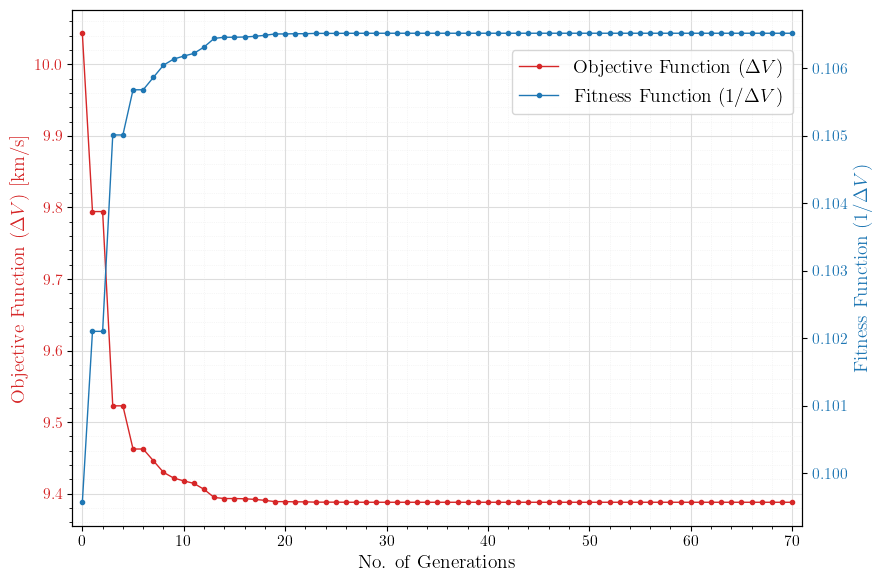

In [146]:
set_font_sizes(14)

fig, ax1 = plt.subplots(figsize=(9, 6))

# Plot objective value on primary axis (left)
color1 = "tab:red"
ax1.set_xlabel(
    "No. of Generations",
)  # fontsize=12)
ax1.set_ylabel("Objective Function $(\\Delta V)$ [km/s]", color=color1)  # fontsize=12,
line1 = ax1.plot(
    generations,
    deltaV_values_GA,
    marker=".",
    linestyle="-",
    linewidth=1,
    color=color1,
    label="Objective Function $(\\Delta V)$",
)
ax1.tick_params(axis="y", labelcolor=color1)

# Create secondary axis (right) for fitness value
ax2 = ax1.twinx()
color2 = "tab:blue"
ax2.set_ylabel("Fitness Function $(1/\\Delta V)$", color=color2)  # fontsize=12,
line2 = ax2.plot(
    generations,
    fitness_values_deltaV,
    marker=".",
    linestyle="-",
    linewidth=1,
    color=color2,
    label="Fitness Function $(1/\\Delta V)$",
)
ax2.tick_params(axis="y", labelcolor=color2)

lines = line1 + line2
labels = [l.get_label() for l in lines]
ax1.legend(
    lines,
    labels,
    loc="upper right",
    bbox_to_anchor=(1, 0.94),
)  # fontsize=11)

ax1.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax1.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax1.minorticks_on()

# plt.title(r'\textbf{Fitness \& Objective Functions vs No. of Generations}',
#          pad=10, fontsize=14)

# ax1.set_ylim(1/0.1068, 1/0.1028)  # For objective function (ΔV)
# ax2.set_ylim(0.103, 0.1072)  # For fitness function (1/ΔV)

ax1.set_xlim(-1, 71)

plt.tight_layout()
output_figures.save_file(
    "voyager_I_GA_fitness_objective.png", dpi=500, bbox_inches="tight"
)

# Show plot
plt.show()

In [147]:
GA_list = [date_departure_mjd_GA, date_flyby_jupiter_mjd_GA, date_flyby_saturn_mjd_GA]
GA_list_calendar = [date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA]
GA_list, GA_list_calendar

([43388.3732065305, 44099.4536062653, 44920.99027300166],
 ['1977-09-02 08:57:25.044',
  '1979-08-14 10:53:11.581',
  '1981-11-12 23:45:59.587'])

#### Contour Graph per Generation

Figure saved to: Voyager 1 - Figures/voyager_I_GA_per_generation_3D.png


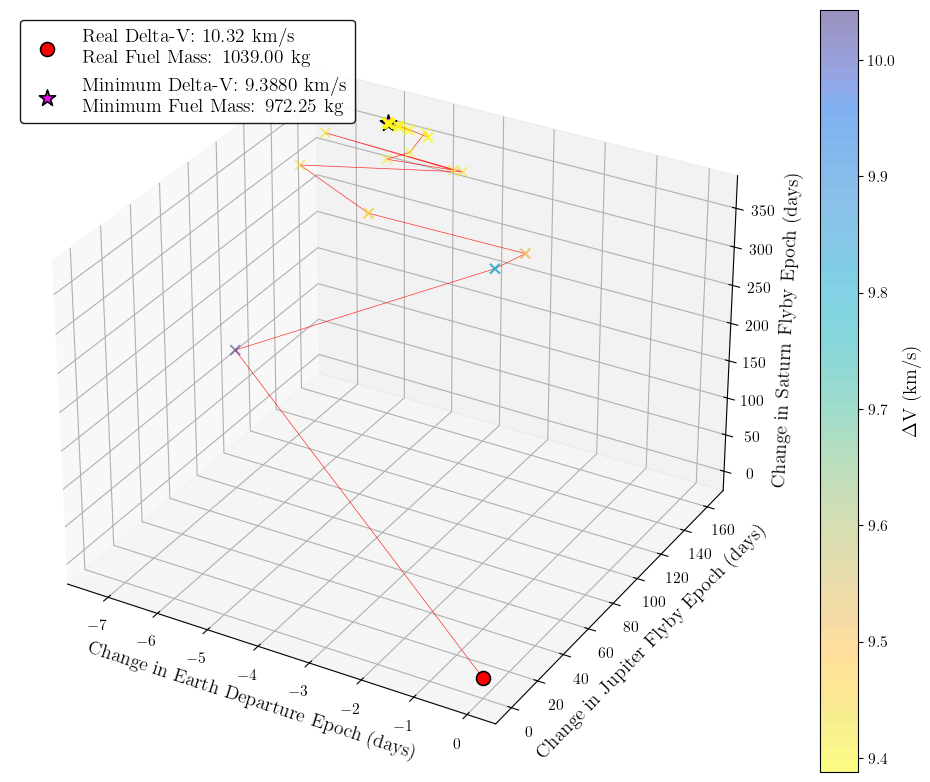

In [149]:
# Extract best solutions per generation
best_solutions = np.array(best_solutions_per_generation)

departure_dates = best_solutions[:, 0] - date_departure_mjd
jupiter_flyby_dates = best_solutions[:, 1] - date_flyby_jupiter_mjd
saturn_flyby_dates = best_solutions[:, 2] - date_flyby_saturn_mjd

# Compute deltaV for colour mapping
deltaV_values_GA = np.array([find_deltaV_mission(*sol)[0] for sol in best_solutions])

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")

# Scatter plot of best solutions per generation
scatter = ax.scatter(
    departure_dates,
    jupiter_flyby_dates,
    saturn_flyby_dates,
    c=deltaV_values_GA,
    cmap=parula_map(True),
    s=50,
    alpha=0.5,
    marker="x",
    norm=plt.Normalize(vmin=min(deltaV_values_GA), vmax=max(deltaV_values_GA)),
)

ax.scatter(
    [0],
    [0],
    [0],
    color="red",
    s=100,
    marker="o",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg",
)

ax.plot(
    [0, departure_dates[0]],
    [0, jupiter_flyby_dates[0]],
    [0, saturn_flyby_dates[0]],
    linestyle="-",
    color="r",
    markersize=6,
    linewidth=0.5,
    alpha=0.8,
)

ax.plot(
    departure_dates,
    jupiter_flyby_dates,
    saturn_flyby_dates,
    linestyle="-",
    color="r",
    markersize=6,
    linewidth=0.5,
    alpha=0.8,
)

ax.scatter(
    date_departure_mjd_GA - date_departure_mjd,
    date_flyby_jupiter_mjd_GA - date_flyby_jupiter_mjd,
    date_flyby_saturn_mjd_GA - date_flyby_saturn_mjd,
    color="fuchsia",
    s=150,
    marker="*",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Minimum Delta-V: {deltaV_GA:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_GA:.2f} kg",
)

# Colour bar
# cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, pad=0.1)
# cbar.set_label('Total Delta-V (km/s)')

cbar = plt.colorbar(scatter, ax=ax, label="$\Delta$V (km/s)")

# Set labels with increased padding
ax.set_xlabel("Change in Earth Departure Epoch (days)")
ax.set_ylabel("Change in Jupiter Flyby Epoch (days)")
ax.set_zlabel("Change in Saturn Flyby Epoch (days)")

# Title
# ax.set_title('3D Visualisation of Genetic Algorithm\'s Best Solutions per Generation ($\pm$ 365 days bounds)')

# Set axis limits
# limit = 365
# ax.set_xlim(-limit, limit)
# ax.set_ylim(-limit, limit)
# ax.set_zlim(-limit, limit)

ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")
plt.tight_layout()

output_figures.save_file(
    "voyager_I_GA_per_generation_3D.png", dpi=500, bbox_inches="tight"
)

# Show plot
plt.show()

In [150]:
best_solutions_per_generation = np.array(best_solutions_per_generation)
best_solutions_per_generation[:, 0]

array([43387.74508835, 43391.19929134, 43391.19929134, 43391.84989451,
       43391.84989451, 43388.74211566, 43388.74211566, 43387.08366979,
       43390.08747405, 43387.30470359, 43389.92537982, 43388.62758546,
       43388.99238209, 43389.11293258, 43389.20355813, 43389.20355813,
       43388.65312571, 43388.81045796, 43388.77586001, 43388.57071271,
       43388.57071271, 43388.58904893, 43388.58904893, 43388.41231489,
       43388.41231489, 43388.41231489, 43388.35513281, 43388.35513281,
       43388.35902069, 43388.34758846, 43388.36290807, 43388.3536473 ,
       43388.3536473 , 43388.3536473 , 43388.37007982, 43388.37203311,
       43388.36886631, 43388.37230202, 43388.36181319, 43388.37166523,
       43388.37730798, 43388.37730798, 43388.37730798, 43388.36314186,
       43388.36314186, 43388.36314186, 43388.36314186, 43388.37530901,
       43388.37530901, 43388.37516052, 43388.37516052, 43388.37516052,
       43388.37516052, 43388.37386255, 43388.37386255, 43388.37329407,
      

Figure saved to: Voyager 1 - Figures/voyager_I_GA_inital_pop_3D.png


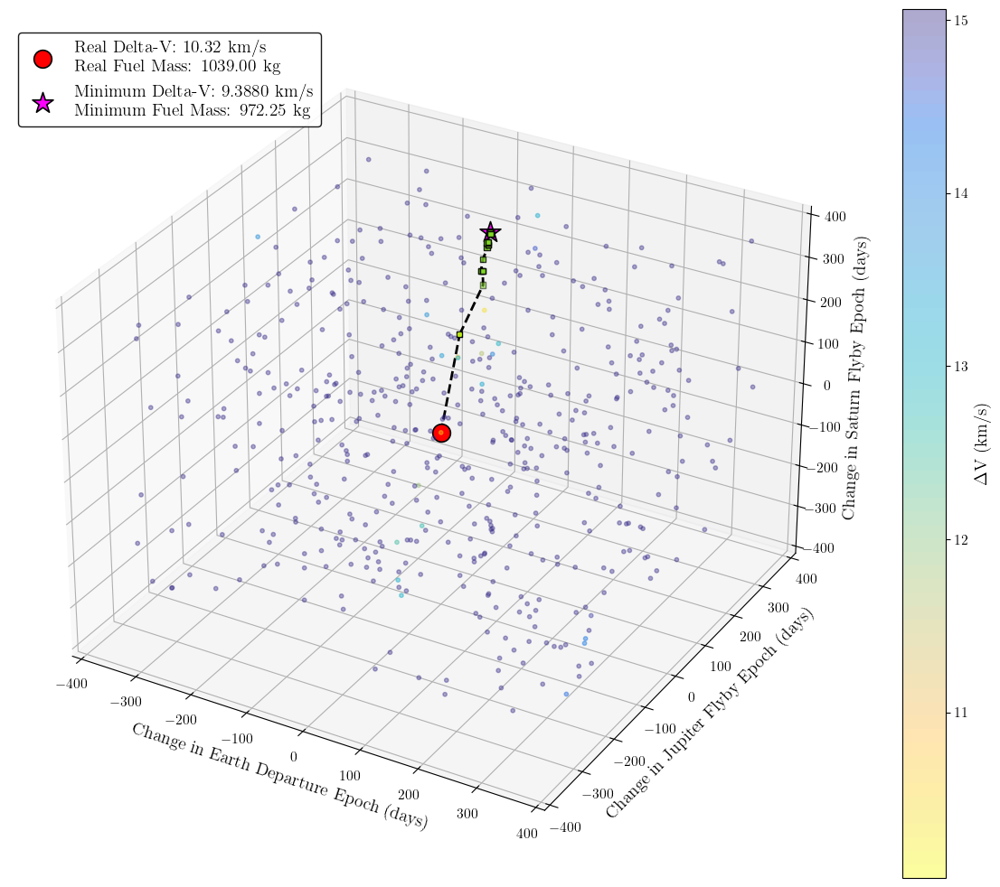

In [151]:
# Extract the population for the chosen generation
selected_population = population_per_generation[0]

# Extract dates and normalise relative to nominal mission dates
departure_dates_GA = (
    np.array([ind[0] for ind in selected_population]) - date_departure_mjd
)
jupiter_flyby_dates_GA = (
    np.array([ind[1] for ind in selected_population]) - date_flyby_jupiter_mjd
)
saturn_flyby_dates_GA = (
    np.array([ind[2] for ind in selected_population]) - date_flyby_saturn_mjd
)

# Compute deltaV for coloring
deltaV_values_GA = np.array(
    [find_deltaV_mission(*ind)[0] for ind in selected_population]
)

# Create 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection="3d")

scatter = ax.scatter(
    departure_dates_GA,
    jupiter_flyby_dates_GA,
    saturn_flyby_dates_GA,
    c=deltaV_values_GA,
    cmap=parula_map(True),
    s=10,
    alpha=0.4,
    norm=plt.Normalize(vmin=min(deltaV_values_GA), vmax=min(deltaV_values_GA) * 1.5),
)

ax.scatter(
    best_solutions_per_generation[:-6, 0] - date_departure_mjd,
    best_solutions_per_generation[:-6, 1] - date_flyby_jupiter_mjd,
    best_solutions_per_generation[:-6, 2] - date_flyby_saturn_mjd,
    color="#81DB24",
    s=20,
    marker="s",
    edgecolors="black",
    linewidth=1,
)

ax.scatter(
    [0],
    [0],
    [0],
    color="red",
    s=200,
    marker="o",
    edgecolors="black",
    linewidth=1.2,
    label=f"Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg",
)

ax.scatter(
    date_departure_mjd_GA - date_departure_mjd,
    date_flyby_jupiter_mjd_GA - date_flyby_jupiter_mjd,
    date_flyby_saturn_mjd_GA - date_flyby_saturn_mjd,
    color="fuchsia",
    s=300,
    marker="*",
    edgecolors="black",
    linewidth=1.2,
    label=f"Minimum Delta-V: {deltaV_GA:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_GA:.2f} kg",
)

ax.plot(
    [0, departure_dates[0]],
    [0, jupiter_flyby_dates[0]],
    [0, saturn_flyby_dates[0]],
    linestyle="--",
    color="black",
    markersize=6,
    linewidth=2,
    alpha=1,
)

ax.plot(
    departure_dates,
    jupiter_flyby_dates,
    saturn_flyby_dates,
    linestyle="--",
    color="black",
    markersize=6,
    linewidth=2,
    alpha=1,
)

# Set labels with increased padding
ax.set_xlabel(
    "Change in Earth Departure Epoch (days)",
    labelpad=5,
)  # fontsize=12)
ax.set_ylabel(
    "Change in Jupiter Flyby Epoch (days)",
    labelpad=5,
)  # fontsize=12)
ax.set_zlabel(
    "Change in Saturn Flyby Epoch (days)",
    labelpad=5,
)  # fontsize=12)

# Set title with increased padding
# ax.set_title(r'\textbf{3D Visualisation of Genetic Algorithm\'s Initial Population Problem Space ($\pm$ 365 days bounds)}',
#             fontsize=14)

# Format the scientific notation to be more readable
for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
    formatter = ScalarFormatter(useOffset=False)
    formatter.set_scientific(True)
    formatter.set_powerlimits(
        (-3, 3)
    )  # Only use scientific notation for exponents outside this range
    axis.set_major_formatter(formatter)

# Position the offset text for better visibility
ax.xaxis.get_offset_text().set_position((0, -0.1))
ax.yaxis.get_offset_text().set_position((0, -0.1))
ax.zaxis.get_offset_text().set_position((0, -0.1))

# Ensure the exponent text is horizontally aligned
ax.xaxis.get_offset_text().set_ha("left")
ax.yaxis.get_offset_text().set_ha("left")
ax.zaxis.get_offset_text().set_ha("left")

# Add colorbar with adjusted position
cbar = plt.colorbar(scatter, ax=ax, label="$\Delta$V (km/s)")
cbar.ax.set_ylabel(
    "$\Delta$V (km/s)",
)  # fontsize=12)

ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")
plt.tight_layout()

output_figures.save_file("voyager_I_GA_inital_pop_3D.png", dpi=500, bbox_inches="tight")

plt.show()

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_0.png


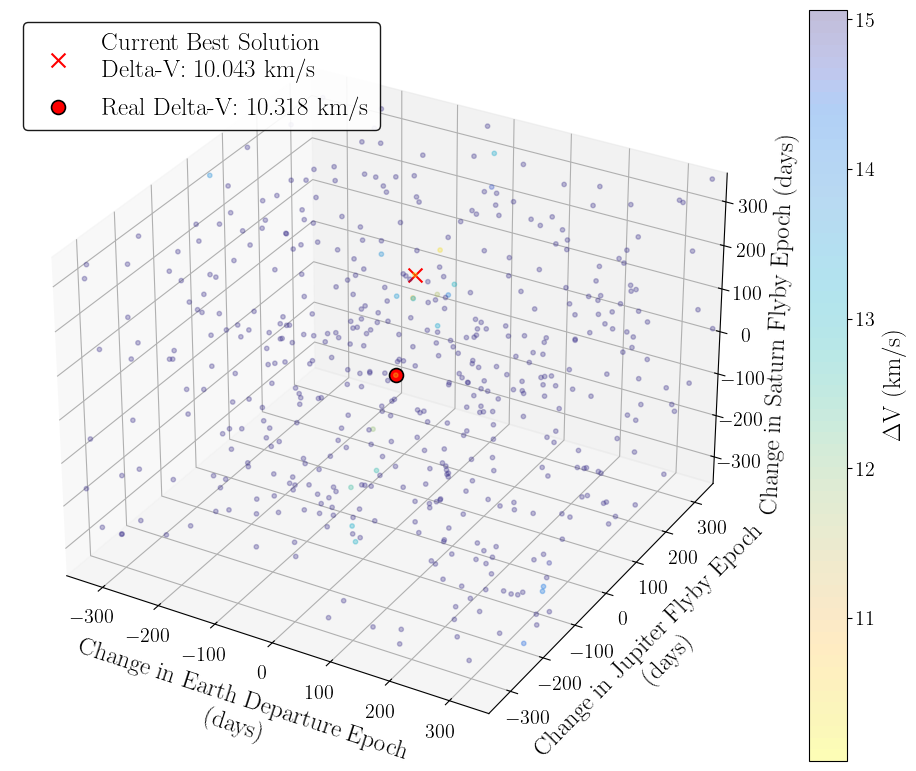

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_1.png


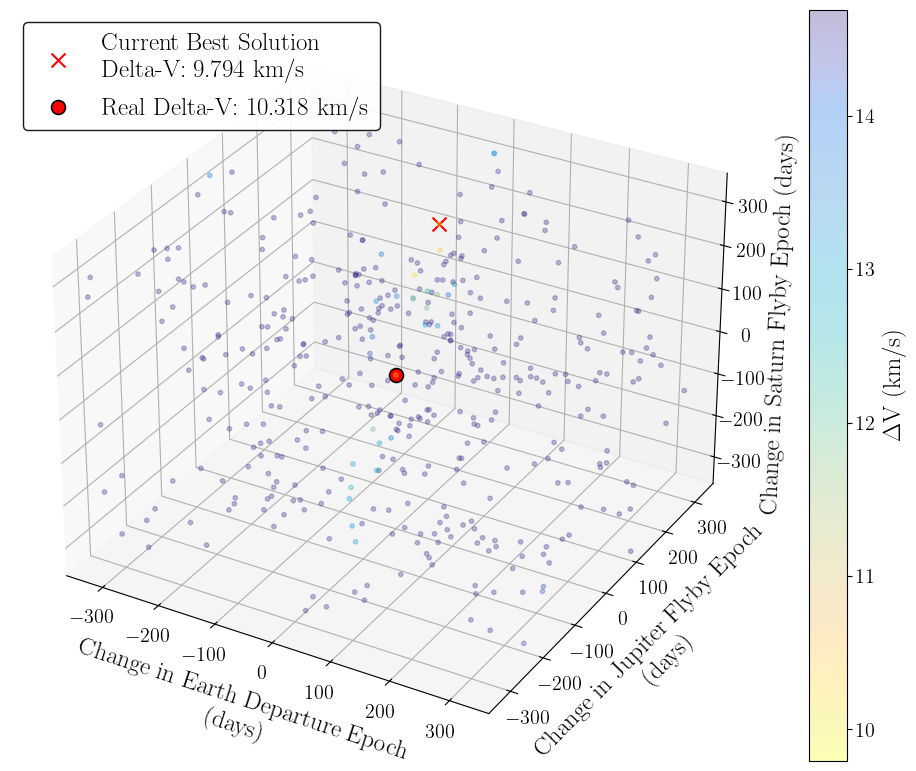

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_5.png


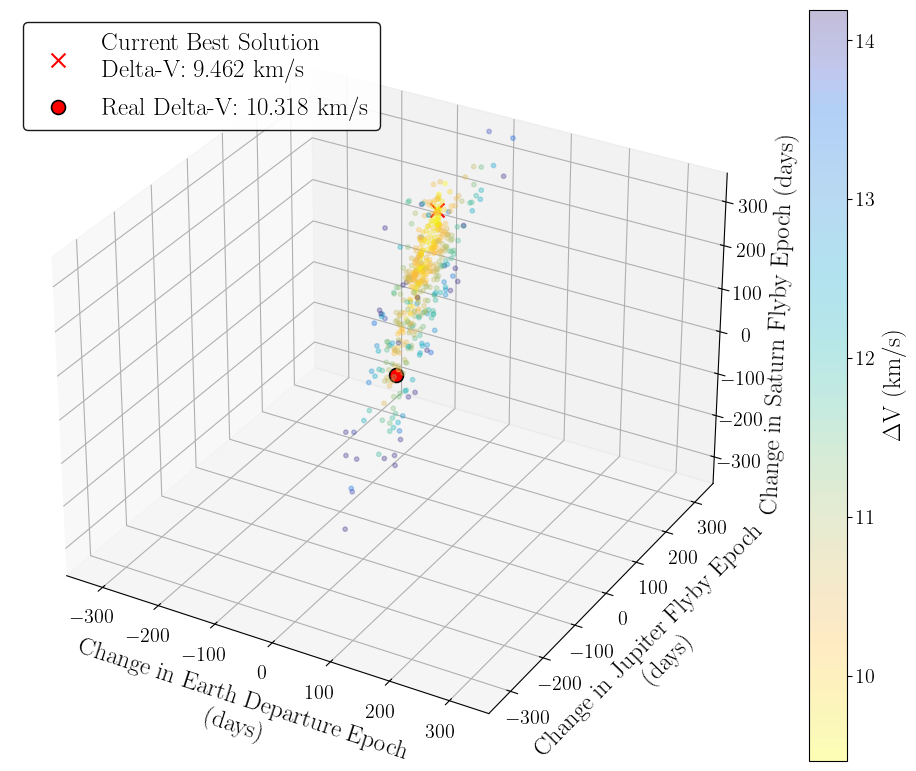

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_10.png


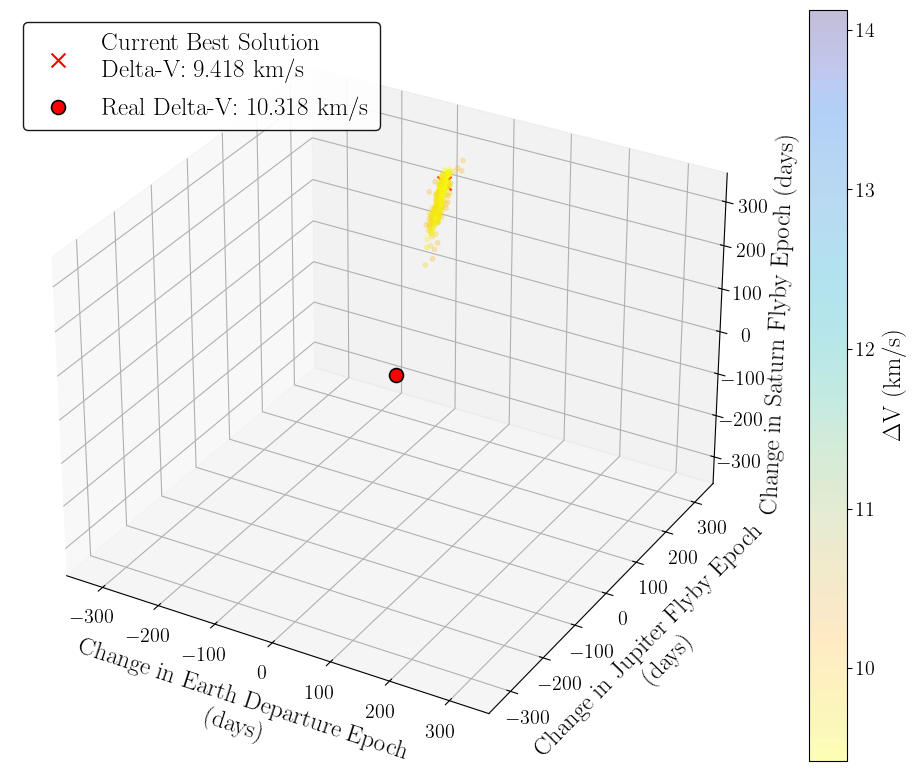

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_15.png


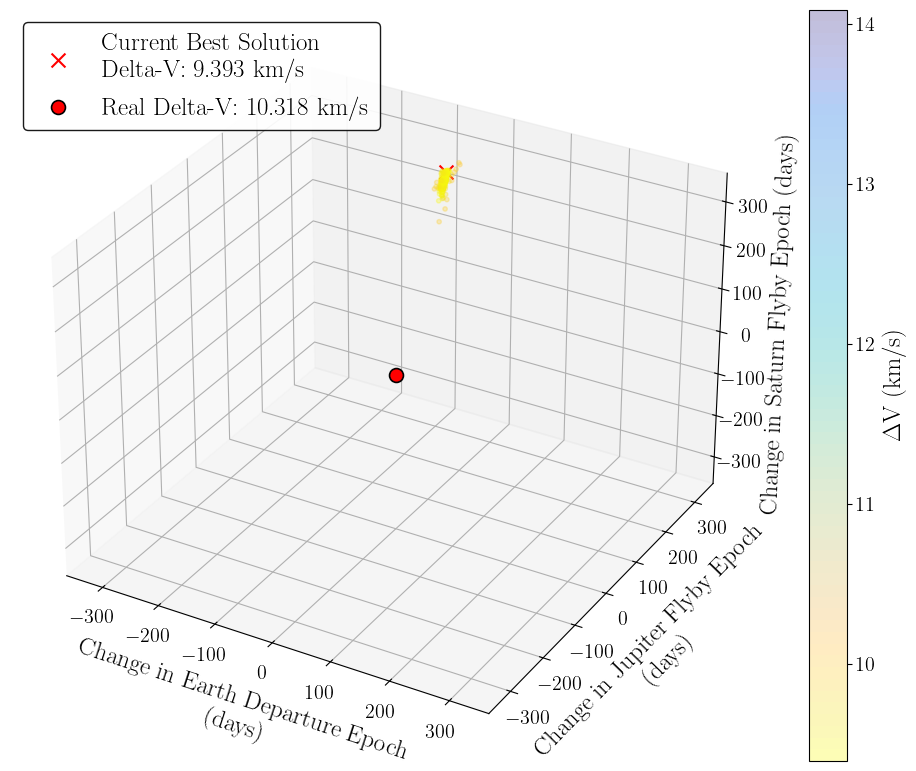

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_20.png


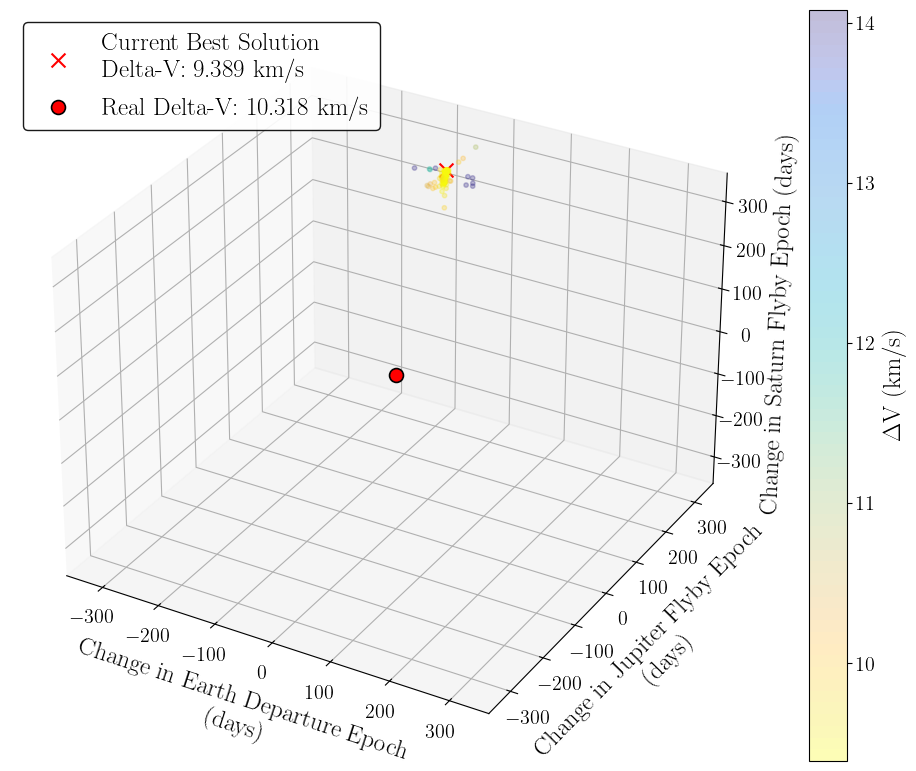

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_25.png


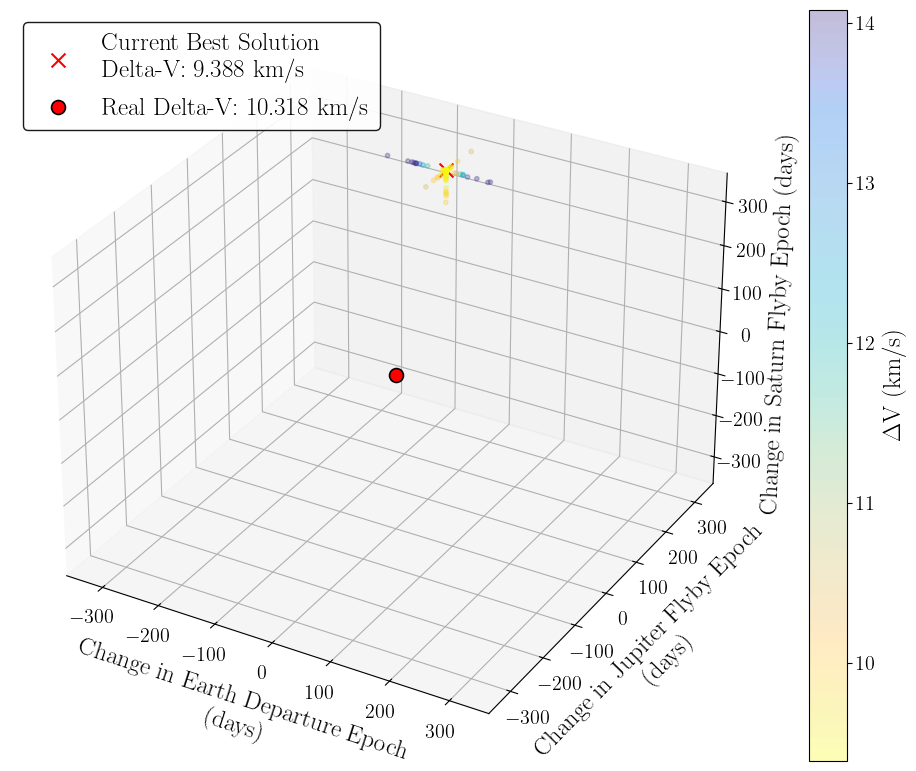

Figure saved to: Voyager 1 - Figures/voyager_I_GA_generation_70.png


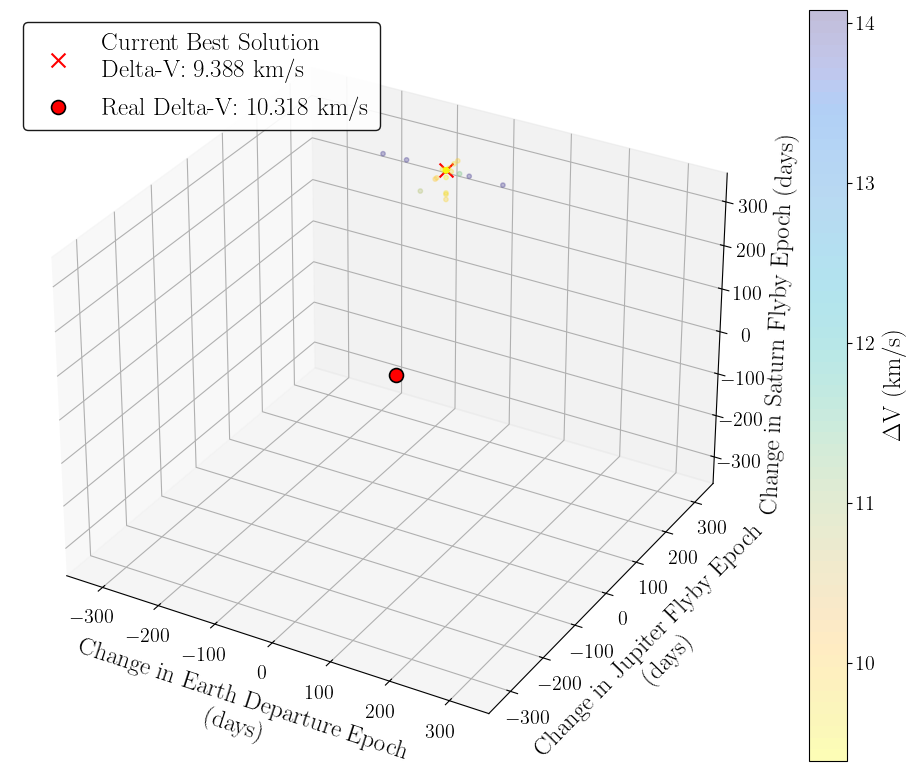

In [152]:
set_font_sizes(18)
plt.rc("axes", titlesize=14)


def plot_3d_ga_contour_generation(population_per_generation, generation_idx):
    # Make sure the generation index is valid
    if generation_idx < 0 or generation_idx >= len(population_per_generation):
        raise ValueError(
            f"Generation index must be between 0 and {len(population_per_generation)-1}"
        )

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection="3d")

    # Get the selected population
    selected_population = population_per_generation[generation_idx]

    # Extract dates and normalise relative to nominal mission dates
    departure_dates_GA = (
        np.array([ind[0] for ind in selected_population]) - date_departure_mjd
    )
    jupiter_flyby_dates_GA = (
        np.array([ind[1] for ind in selected_population]) - date_flyby_jupiter_mjd
    )
    saturn_flyby_dates_GA = (
        np.array([ind[2] for ind in selected_population]) - date_flyby_saturn_mjd
    )

    deltaV_values_GA = np.array(
        [find_deltaV_mission(*ind)[0] for ind in selected_population]
    )

    # Create scatter plot
    scatter = ax.scatter(
        departure_dates_GA,
        jupiter_flyby_dates_GA,
        saturn_flyby_dates_GA,
        c=deltaV_values_GA,
        cmap=parula_map(True),
        s=10,
        alpha=0.3,
        norm=plt.Normalize(
            vmin=min(deltaV_values_GA), vmax=min(deltaV_values_GA) * 1.5
        ),
    )

    # Mark the best solution for the current generation
    best_individual = selected_population[0]  # Best individual of the generation
    ax.scatter(
        best_individual[0] - date_departure_mjd,
        best_individual[1] - date_flyby_jupiter_mjd,
        best_individual[2] - date_flyby_saturn_mjd,
        color="red",
        s=100,
        marker="x",
        label=f"Current Best Solution\nDelta-V: {find_deltaV_mission(*best_individual)[0]:.3f} km/s",
    )

    # Mark the real solution
    ax.scatter(
        [0],
        [0],
        [0],
        color="red",
        s=100,
        marker="o",
        edgecolors="black",
        linewidth=1.2,
        label=f"Real Delta-V: {deltaV_REAL:.3f} km/s",
    )

    # Set labels with increased padding
    ax.set_xlabel(
        "Change in Earth Departure Epoch\n(days)",
        labelpad=15,
    )  # fontsize=12)
    ax.set_ylabel(
        "Change in Jupiter Flyby Epoch\n(days)",
        labelpad=15,
    )  # fontsize=12)
    ax.set_zlabel(
        "Change in Saturn Flyby Epoch (days)",
        labelpad=5,
    )  # fontsize=12)

    # Set title with increased padding
    title_text = f"\\textbf{{3D Visualisation of Genetic Algorithm Problem Space (Generation {generation_idx})}}"
    # ax.set_title(r'{}'.format(title_text), fontsize=14)

    # Format the scientific notation to be more readable
    for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
        formatter = ScalarFormatter(useOffset=False)
        formatter.set_scientific(True)
        formatter.set_powerlimits(
            (-3, 3)
        )  # Only use scientific notation for exponents outside this range
        axis.set_major_formatter(formatter)

    # Position the offset text for better visibility
    ax.xaxis.get_offset_text().set_position((0, -0.1))
    ax.yaxis.get_offset_text().set_position((0, -0.1))
    ax.zaxis.get_offset_text().set_position((0, -0.1))

    # Ensure the exponent text is horizontally aligned
    ax.xaxis.get_offset_text().set_ha("left")
    ax.yaxis.get_offset_text().set_ha("left")
    ax.zaxis.get_offset_text().set_ha("left")

    # Add legend
    ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")

    # Set axis limits
    limit = 365
    ax.set_xlim(-limit, limit)
    ax.set_ylim(-limit, limit)
    ax.set_zlim(-limit, limit)

    # Add colorbar
    ccbar = plt.colorbar(scatter, ax=ax, label="$\Delta$V (km/s)")
    cbar.ax.set_ylabel(
        "$\Delta$V (km/s)",
    )  # fontsize=12)

    plt.tight_layout()
    output_figures.save_file(
        f"voyager_I_GA_generation_{generation_idx}.png", dpi=500, bbox_inches="tight"
    )

    plt.show()

    return fig


fig = plot_3d_ga_contour_generation(population_per_generation, 0)
fig = plot_3d_ga_contour_generation(population_per_generation, 1)
fig = plot_3d_ga_contour_generation(population_per_generation, 5)
fig = plot_3d_ga_contour_generation(population_per_generation, 10)
fig = plot_3d_ga_contour_generation(population_per_generation, 15)
fig = plot_3d_ga_contour_generation(population_per_generation, 20)
fig = plot_3d_ga_contour_generation(population_per_generation, 25)
fig = plot_3d_ga_contour_generation(population_per_generation, 70)

In [153]:
deltaV_values_for_each_gen = [
    find_deltaV_mission(*solution)[0] for solution in best_solutions_per_generation
]
deltaV_values_for_each_gen

[10.043293392211153,
 9.794173869559321,
 9.794173869559321,
 9.52276021464777,
 9.52276021464777,
 9.462442839657472,
 9.462442839657472,
 9.446120445303913,
 9.429904059459039,
 9.421918761213618,
 9.41795444297052,
 9.414412029135452,
 9.406099969927013,
 9.394793709995286,
 9.39324821392115,
 9.39324821392115,
 9.392936372255992,
 9.392069950826091,
 9.390717240603868,
 9.388942041112996,
 9.388942041112996,
 9.38862167207836,
 9.38862167207836,
 9.388192381774578,
 9.388192381774578,
 9.388192381774578,
 9.388074070748623,
 9.388074070748623,
 9.388048280911075,
 9.388043747834027,
 9.388037156356544,
 9.388034950493026,
 9.388034950493026,
 9.388034950493026,
 9.388032523180364,
 9.388031973074225,
 9.38803192945523,
 9.388031643414005,
 9.388031113820345,
 9.388031041658556,
 9.38803085049523,
 9.38803085049523,
 9.38803085049523,
 9.388030465436369,
 9.388030465436369,
 9.388030465436369,
 9.388030465436369,
 9.388030336535108,
 9.388030336535108,
 9.388030251105326,
 9.3880302

## Hybrid GA (GA + Fmin)

Using GA optimal solution as the initial guess.

In [155]:
%%time
if global_flag:
    iterations = []
    iteration_count = []

    # Start timing
    start_time = time.time()

    # Run optimisation using `fmin` with manual bounds enforcement
    optimal_dates = fmin(objective_function, GA_list, disp=True)

    iteration_count = len(iteration_count)

    # Extract optimised dates
    (
        date_departure_mjd_GA_FMIN_COMBINED,
        date_flyby_jupiter_mjd_GA_FMIN_COMBINED,
        date_flyby_saturn_mjd_GA_FMIN_COMBINED,
    ) = optimal_dates

    # Compute Delta-V and fuel mass at optimised dates
    deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED = (
        find_deltaV_mission(
            date_departure_mjd_GA_FMIN_COMBINED,
            date_flyby_jupiter_mjd_GA_FMIN_COMBINED,
            date_flyby_saturn_mjd_GA_FMIN_COMBINED,
        )
    )

    # Display results
    print(f"Minimum Delta-V: {deltaV_GA_FMIN_COMBINED:.4f} km/s")
    print(f"Optimal Departure Date (MJD): {date_departure_mjd_GA_FMIN_COMBINED:.2f}")
    print(
        f"Optimal Jupiter Flyby Date (MJD): {date_flyby_jupiter_mjd_GA_FMIN_COMBINED:.2f}"
    )
    print(
        f"Optimal Saturn Flyby Date (MJD): {date_flyby_saturn_mjd_GA_FMIN_COMBINED:.2f}"
    )

    # Convert to calendar dates
    print("\nIn calendar dates:")
    print(f"Departure: {MJD_to_TT_calander_date(date_departure_mjd_GA_FMIN_COMBINED)}")
    print(
        f"Jupiter flyby: {MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA_FMIN_COMBINED)}"
    )
    print(
        f"Saturn flyby: {MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA_FMIN_COMBINED)}"
    )

    # End timing
    end_time = time.time()
    execution_time_GA_FMIN_COMBINED = end_time - start_time
    print(f"\nExecution Time: {execution_time_GA_FMIN_COMBINED:.4f} seconds")
    print(f"No. of Iterations: {iteration_count}")

CPU times: user 1e+03 ns, sys: 1e+03 ns, total: 2 µs
Wall time: 3.1 µs


In [156]:
if global_flag:
    filename_brute = output_pickle.get_path("ga_+_fmin_results_V1.pkl")

    results_brute = {
        "optimal_dates": optimal_dates,
        "execution_time_GA_FMIN_COMBINED": execution_time_GA_FMIN_COMBINED,
        "iterations": iterations,
        "iteration_count": iteration_count,
    }
    with open(filename_brute, "wb") as f:
        pickle.dump(results_brute, f)

In [157]:
filename_brute = output_pickle.get_path("ga_+_fmin_results_V1.pkl")

with open(filename_brute, "rb") as f:
    data = pickle.load(f)

optimal_dates = data["optimal_dates"]
execution_time_GA_FMIN_COMBINED = data["execution_time_GA_FMIN_COMBINED"]
iterations = data["iterations"]
iteration_count = data["iteration_count"]

if not global_flag:
    # Extract optimised dates
    (
        date_departure_mjd_GA_FMIN_COMBINED,
        date_flyby_jupiter_mjd_GA_FMIN_COMBINED,
        date_flyby_saturn_mjd_GA_FMIN_COMBINED,
    ) = optimal_dates

    # Compute Delta-V and fuel mass at optimised dates
    deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED = (
        find_deltaV_mission(
            date_departure_mjd_GA_FMIN_COMBINED,
            date_flyby_jupiter_mjd_GA_FMIN_COMBINED,
            date_flyby_saturn_mjd_GA_FMIN_COMBINED,
        )
    )

    # Display results
    print(f"Minimum Delta-V: {deltaV_GA_FMIN_COMBINED:.4f} km/s")
    print(f"Optimal Departure Date (MJD): {date_departure_mjd_GA_FMIN_COMBINED:.2f}")
    print(
        f"Optimal Jupiter Flyby Date (MJD): {date_flyby_jupiter_mjd_GA_FMIN_COMBINED:.2f}"
    )
    print(
        f"Optimal Saturn Flyby Date (MJD): {date_flyby_saturn_mjd_GA_FMIN_COMBINED:.2f}"
    )

    # Convert to calendar dates
    print("\nIn calendar dates:")
    print(f"Departure: {MJD_to_TT_calander_date(date_departure_mjd_GA_FMIN_COMBINED)}")
    print(
        f"Jupiter flyby: {MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA_FMIN_COMBINED)}"
    )
    print(
        f"Saturn flyby: {MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA_FMIN_COMBINED)}"
    )

    print(f"\nExecution Time: {execution_time_GA_FMIN_COMBINED:.4f} seconds")
    print(f"No. of Iterations: {iteration_count}")

Minimum Delta-V: 9.3880 km/s
Optimal Departure Date (MJD): 43388.37
Optimal Jupiter Flyby Date (MJD): 44099.45
Optimal Saturn Flyby Date (MJD): 44920.99

In calendar dates:
Departure: 1977-09-02 08:57:25.044
Jupiter flyby: 1979-08-14 10:53:11.581
Saturn flyby: 1981-11-12 23:45:59.587

Execution Time: 0.4036 seconds
No. of Iterations: 197


In [158]:
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED = (
    find_deltaV_mission(
        date_departure_mjd_GA_FMIN_COMBINED,
        date_flyby_jupiter_mjd_GA_FMIN_COMBINED,
        date_flyby_saturn_mjd_GA_FMIN_COMBINED,
    )
)
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED

(9.388030090634013,
 972.2489760783692,
 {'deltaV_injection (km/s)': 9.388030089505241,
  'deltaV_jupiter (km/s)': 1.128771742742174e-09,
  'rp_jupiter (km)': 2584504.0014122305,
  'vp_jupiter (km/s)': 12.313401660031868,
  'vp_esc_jupiter (km/s)': 9.902311251269808,
  'deflection_jupiter (deg)': 94.79796238687835,
  'tof (days)': 1532.6170664711608})

In [159]:
execution_time_GA_FMIN_COMBINED_total = (
    execution_time_GA + execution_time_GA_FMIN_COMBINED
)
execution_time_GA_FMIN_COMBINED_total

189.7529180973053

In [160]:
change_in_dates_list_GA_FMIN_COMBINED = [
    (date_departure_mjd_GA_FMIN_COMBINED - date_departure_mjd),
    (date_flyby_jupiter_mjd_GA_FMIN_COMBINED - date_flyby_jupiter_mjd),
    (date_flyby_saturn_mjd_GA_FMIN_COMBINED - date_flyby_saturn_mjd),
]
change_in_dates_list_GA_FMIN_COMBINED

[-6.007349025188887, 161.95013404328347, 364.9999952237704]

In [161]:
print(
    "Earth-Jupiter:",
    date_flyby_jupiter_mjd_GA_FMIN_COMBINED - date_departure_mjd_GA_FMIN_COMBINED,
    "days",
)
print(
    "Jupiter-Saturn:",
    date_flyby_saturn_mjd_GA_FMIN_COMBINED - date_flyby_jupiter_mjd_GA_FMIN_COMBINED,
    "days",
)

Earth-Jupiter: 711.0803997347975 days
Jupiter-Saturn: 821.5366667363633 days


In [162]:
date_departure_GA_FMIN_COMBINED = MJD_to_TT_calander_date(
    date_departure_mjd_GA_FMIN_COMBINED
)
date_flyby_jupiter_GA_FMIN_COMBINED = MJD_to_TT_calander_date(
    date_flyby_jupiter_mjd_GA_FMIN_COMBINED
)
date_flyby_saturn_GA_FMIN_COMBINED = MJD_to_TT_calander_date(
    date_flyby_saturn_mjd_GA_FMIN_COMBINED
)

print(
    "Date of Departure (Min):",
    MJD_to_TT_calander_date(date_departure_mjd_GA_FMIN_COMBINED),
)

print(
    "Date of Jupiter Flyby (Min):",
    MJD_to_TT_calander_date(date_flyby_jupiter_mjd_GA_FMIN_COMBINED),
)

print(
    "Date of Saturn Flyby (Min):",
    MJD_to_TT_calander_date(date_flyby_saturn_mjd_GA_FMIN_COMBINED),
)

Date of Departure (Min): 1977-09-02 08:57:25.044
Date of Jupiter Flyby (Min): 1979-08-14 10:53:11.581
Date of Saturn Flyby (Min): 1981-11-12 23:45:59.587


### Contour Graph of Problem Space

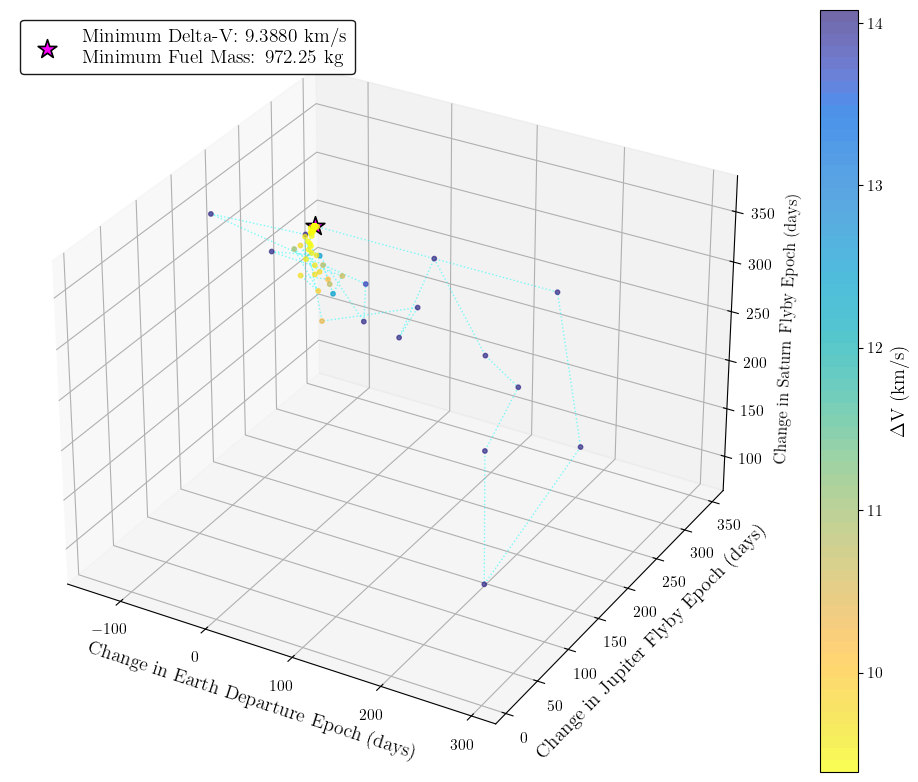

In [164]:
set_font_sizes(14)

# Extract the dates from the iterations list
departure_dates_GA_FMIN_COMBINED = np.array([iter[0] for iter in iterations])
jupiter_flyby_dates_GA_FMIN_COMBINED = np.array([iter[1] for iter in iterations])
saturn_flyby_dates_GA_FMIN_COMBINED = np.array([iter[2] for iter in iterations])
# Calculate the corresponding deltaV values for the iterations
deltaV_values_GA_FMIN_COMBINED = []
for dates in iterations:
    try:
        deltaV, _, _ = find_deltaV_mission(*dates)
    except Exception:
        deltaV_values_GA_FMIN_COMBINED.append(1e99)
        continue
    deltaV_values_GA_FMIN_COMBINED.append(deltaV)
# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")
# Scatter plot with color based on deltaV
scatter = ax.scatter(
    departure_dates_GA_FMIN_COMBINED - date_departure_mjd,
    jupiter_flyby_dates_GA_FMIN_COMBINED - date_flyby_jupiter_mjd,
    saturn_flyby_dates_GA_FMIN_COMBINED - date_flyby_saturn_mjd,
    c=deltaV_values_GA_FMIN_COMBINED,
    cmap=parula_map(True),
    s=10,
    alpha=0.7,
    norm=plt.Normalize(
        vmin=min(deltaV_values_GA_FMIN_COMBINED),
        vmax=min(deltaV_values_GA_FMIN_COMBINED) * 1.5,
    ),
)
ax.plot(
    departure_dates_GA_FMIN_COMBINED - date_departure_mjd,
    jupiter_flyby_dates_GA_FMIN_COMBINED - date_flyby_jupiter_mjd,
    saturn_flyby_dates_GA_FMIN_COMBINED - date_flyby_saturn_mjd,
    linestyle=":",
    color="cyan",
    markersize=6,
    linewidth=1,
    alpha=0.5,
)
# ax.scatter(
#     [0],
#     [0],
#     [0],
#     color="red",
#     s=100,
#     marker="o",
#     edgecolors="black",
#     linewidth=1.2,
#     zorder=3,  # Higher zorder brings it to the front
#     label=f"Real Delta-V: {deltaV_REAL:.2f} km/s\nReal Fuel Mass: {fuel_mass_REAL:.2f} kg",
# )
ax.scatter(
    date_departure_mjd_GA_FMIN_COMBINED - date_departure_mjd,
    date_flyby_jupiter_mjd_GA_FMIN_COMBINED - date_flyby_jupiter_mjd,
    date_flyby_saturn_mjd_GA_FMIN_COMBINED - date_flyby_saturn_mjd,
    color="fuchsia",
    s=200,
    marker="*",
    edgecolors="black",
    linewidth=1.2,
    zorder=3,  # Higher zorder brings it to the front
    label=f"Minimum Delta-V: {deltaV_GA_FMIN_COMBINED:.4f} km/s\nMinimum Fuel Mass: {fuel_mass_GA_FMIN_COMBINED:.2f} kg",
)
cbar = plt.colorbar(scatter, ax=ax, label="$\Delta$V (km/s)")
cbar.ax.set_ylabel(
    "$\Delta$V (km/s)",
)  # fontsize=12)
ax.set_xlabel(
    "Change in Earth Departure Epoch (days)",
)  # fontsize=12)
ax.set_ylabel(
    "Change in Jupiter Flyby Epoch (days)",
)  # fontsize=12)
ax.set_zlabel("Change in Saturn Flyby Epoch (days)", fontsize=12)
# ax.set_title(r'\textbf{3D Visualisation of Fmin Problem Space ($\pm$ 365 days bounds)}', fontsize=14)
ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")
# Set axis limits
# limit = 375
# ax.set_xlim(-limit, limit)
# ax.set_ylim(-limit, limit)
# ax.set_zlim(-limit, limit)
# Show the plot
plt.tight_layout()
# output_figures.save_file("voyager_I_hybrid_fmin_contour_3D.png", dpi=500, bbox_inches="tight")
plt.show()

## Save Dates

In [166]:
if not testing_flag:
    # Create a dictionary with all results for Voyager I (Earth-Jupiter-Saturn only)
    all_results = {
        "real": [
            date_departure,
            date_flyby_jupiter,
            date_flyby_saturn,
            deltaV_REAL,
            fuel_mass_REAL,
            data_dict_REAL,
        ],
        "brute_force": [
            date_departure_BRUTE_MIN,
            date_flyby_jupiter_BRUTE_MIN,
            date_flyby_saturn_BRUTE_MIN,
            deltaV_BRUTE_MIN,
            fuel_mass_BRUTE_MIN,
            data_dict_BRUTE_MIN,
            change_in_dates_list_BRUTE_MIN,
            execution_time_BRUTE_FORCE,
        ],
        "fmin": [
            date_departure_FMIN,
            date_flyby_jupiter_FMIN,
            date_flyby_saturn_FMIN,
            deltaV_FMIN,
            fuel_mass_FMIN,
            data_dict_FMIN,
            change_in_dates_list_FMIN,
            execution_time_FMIN,
        ],
        "ga": [
            date_departure_GA,
            date_flyby_jupiter_GA,
            date_flyby_saturn_GA,
            deltaV_GA,
            fuel_mass_GA,
            data_dict_GA,
            change_in_dates_list_GA,
            execution_time_GA,
        ],
        "ga_fmin_combined": [
            date_departure_GA_FMIN_COMBINED,
            date_flyby_jupiter_GA_FMIN_COMBINED,
            date_flyby_saturn_GA_FMIN_COMBINED,
            deltaV_GA_FMIN_COMBINED,
            fuel_mass_GA_FMIN_COMBINED,
            data_dict_GA_FMIN_COMBINED,
            change_in_dates_list_GA_FMIN_COMBINED,
            execution_time_GA_FMIN_COMBINED,
        ],
    }

    # Save all results to a single pickle file
    filename = output_pickle.get_path("voyager1_mission_dates.pkl")
    with open(filename, "wb") as f:
        pickle.dump(all_results, f)

    print(f"Saved all mission dates to {filename}")

Saved all mission dates to Raw Results/voyager1_mission_dates.pkl


In [167]:
filename = output_pickle.get_path("voyager1_mission_dates.pkl")
# Read the data back from the pickle file
with open(filename, "rb") as f:
    loaded_results = pickle.load(f)

print("\nLoaded data from pickle file:")
for method, data in loaded_results.items():
    print(f"\n{method.upper()} mission dates:")
    print(f"  Departure:     {data[0]}")
    print(f"  Jupiter flyby: {data[1]}")
    print(f"  Saturn flyby:  {data[2]}")
    print(f"  Delta V:       {data[3]:.6f} km/s")
    print(f"  Fuel Mass:     {data[4]:.3f} kg")
    if len(data) > 6:
        print(f"  Depature change in date:     {data[-2][0]}")
        print(f"  Jupiter change in date:     {data[-2][1]}")
        print(f"  Saturn change in date:     {data[-2][2]}")
        print(f"  Execution Time:     {data[-1]:.3f} s")
    print()
    for i in data[5]:
        print(f"  {i}: {data[5][i]}")

print()

for method, data in loaded_results.items():
    print(f"{method.upper()}:")
    print(f"  Delta V:       {data[3]:.6f} km/s")
    print(f"  Delta V:       {data[3]*1000:.3f} m/s")

# Real Mission dates and data
date_departure, date_flyby_jupiter, date_flyby_saturn = loaded_results["real"][:3]
deltaV_REAL, fuel_mass_REAL, data_dict_REAL = loaded_results["real"][3:]

# Brute Force Algorithm dates and data
date_departure_BRUTE_MIN, date_flyby_jupiter_BRUTE_MIN, date_flyby_saturn_BRUTE_MIN = (
    loaded_results["brute_force"][:3]
)
(
    deltaV_BRUTE_MIN,
    fuel_mass_BRUTE_MIN,
    data_dict_BRUTE_MIN,
    change_in_dates_list_BRUTE_MIN,
    execution_time_BRUTE_FORCE,
) = loaded_results["brute_force"][3:]

# FMIN Algorithm dates
date_departure_FMIN, date_flyby_jupiter_FMIN, date_flyby_saturn_FMIN = loaded_results[
    "fmin"
][:3]
(
    deltaV_FMIN,
    fuel_mass_FMIN,
    data_dict_FMIN,
    change_in_dates_list_FMIN,
    execution_time_FMIN,
) = loaded_results["fmin"][3:]

# Genetic Algorithm dates
date_departure_GA, date_flyby_jupiter_GA, date_flyby_saturn_GA = loaded_results["ga"][
    :3
]
deltaV_GA, fuel_mass_GA, data_dict_GA, change_in_dates_list_GA, execution_time_GA = (
    loaded_results["ga"][3:]
)

# Combined GA + FMIN dates
(
    date_departure_GA_FMIN_COMBINED,
    date_flyby_jupiter_GA_FMIN_COMBINED,
    date_flyby_saturn_GA_FMIN_COMBINED,
) = loaded_results["ga_fmin_combined"][:3]
(
    deltaV_GA_FMIN_COMBINED,
    fuel_mass_GA_FMIN_COMBINED,
    data_dict_GA_FMIN_COMBINED,
    change_in_dates_list_GA_FMIN_COMBINED,
    execution_time_GA_FMIN_COMBINED,
) = loaded_results["ga_fmin_combined"][3:]

execution_time_GA_FMIN_COMBINED_total = (
    execution_time_GA + execution_time_GA_FMIN_COMBINED
)
print(
    f"\n[GA + Fmin] Combined Execution Time:     {execution_time_GA_FMIN_COMBINED_total:.3f} s"
)


Loaded data from pickle file:

REAL mission dates:
  Departure:     1977-09-08 09:08
  Jupiter flyby: 1979-03-05 12:05
  Saturn flyby:  1980-11-12 23:46
  Delta V:       10.317549 km/s
  Fuel Mass:     1039.000 kg

  deltaV_injection (km/s): 10.303632164583048
  deltaV_jupiter (km/s): 0.013916787065500813
  rp_jupiter (km): 1128397.6009035972
  vp_jupiter (km/s): 18.563754373068818
  vp_esc_jupiter (km/s): 14.986288896889137
  deflection_jupiter (deg): 98.16024165269266
  tof (days): 1161.6097222222015

BRUTE_FORCE mission dates:
  Departure:     1977-08-31 22:21:28.163
  Jupiter flyby: 1979-08-08 22:22:08.571
  Saturn flyby:  1981-10-29 02:12:56.327
  Delta V:       9.414559 km/s
  Fuel Mass:     974.213 kg
  Depature change in date:     -7.448979591834359
  Jupiter change in date:     156.42857142857247
  Saturn change in date:     350.102040816324
  Execution Time:     315.442 s

  deltaV_injection (km/s): 9.40484890472681
  deltaV_jupiter (km/s): 0.00970983906492684
  rp_jupiter (

In [168]:
deltaV_BRUTE_MIN / deltaV_REAL * 100

91.24801624796235

In [169]:
(deltaV_GA_FMIN_COMBINED - deltaV_BRUTE_MIN) * 1000

-26.528653157724236

In [170]:
100 - (deltaV_GA_FMIN_COMBINED / deltaV_REAL * 100)

9.009105412250236

# Graphs

## Comparsion Graphs

In [173]:
def plot_VoyagerI(
    date_departure, date_flyby_jupiter, date_flyby_saturn, colour, label_suffix=""
):

    # Convert input dates to Astropy Time in TDB scale
    date_departure = Time(date_departure, scale="tt").tdb
    date_flyby_jupiter = Time(date_flyby_jupiter, scale="tt").tdb
    date_flyby_saturn = Time(date_flyby_saturn, scale="tt").tdb

    date_arrival = date_flyby_saturn

    # Define planetary ephemerides
    earth = Ephem.from_body(
        Earth, time_range(date_departure, end=date_arrival, periods=500)
    )
    ss_earth = Orbit.from_ephem(Sun, earth, date_departure)

    jupiter = Ephem.from_body(
        Jupiter, time_range(date_departure, end=date_arrival, periods=500)
    )
    ss_jupiter = Orbit.from_ephem(Sun, jupiter, date_flyby_jupiter)

    saturn = Ephem.from_body(
        Saturn, time_range(date_departure, end=date_arrival, periods=500)
    )
    ss_saturn = Orbit.from_ephem(Sun, saturn, date_arrival)

    # Solving for maneuver to Jupiter
    man_flyby_jupiter = Maneuver.lambert(ss_earth, ss_jupiter)
    ic1 = ss_earth.apply_maneuver(man_flyby_jupiter)
    ic1_end = ic1.propagate(date_flyby_jupiter)

    # Solving for maneuver to Saturn
    man_flyby_saturn = Maneuver.lambert(ic1_end, ss_saturn)
    ic2 = ic1_end.apply_maneuver(man_flyby_saturn)
    ic2_end = ic2.propagate(date_arrival)

    # Plot Earth's position at departure
    plotter.plot_body_orbit(
        Earth, date_departure, label=f"Earth Departure {label_suffix}", trail=True
    )

    # Plot cruise to Jupiter
    plotter.plot_maneuver(
        ss_earth,
        man_flyby_jupiter,
        label=f"Cruise to Jupiter {label_suffix}",
        color=colour,
    )

    # Plot Jupiter's position at flyby
    plotter.plot_body_orbit(
        Jupiter, date_flyby_jupiter, label=f"Jupiter Flyby {label_suffix}", trail=True
    )

    # Plot cruise to Saturn
    plotter.plot_maneuver(
        ic1_end,
        man_flyby_saturn,
        label=f"Cruise to Saturn {label_suffix}",
        color=colour,
    )

    # Plot Earth's position at departure
    plotter.plot_body_orbit(
        Earth, date_departure, label=f"Earth Departure {label_suffix}", trail=True
    )

    # Plot Jupiter's position at flyby
    plotter.plot_body_orbit(
        Jupiter, date_flyby_jupiter, label=f"Jupiter Flyby {label_suffix}", trail=True
    )

    # Plot Saturn's position at arrival
    plotter.plot_body_orbit(
        Saturn, date_flyby_saturn, label=f"Saturn Arrival {label_suffix}", trail=True
    )

### 2-Axis

Figure saved to: Voyager 1 - Figures/voyager_I_trajectory_km_AU.png


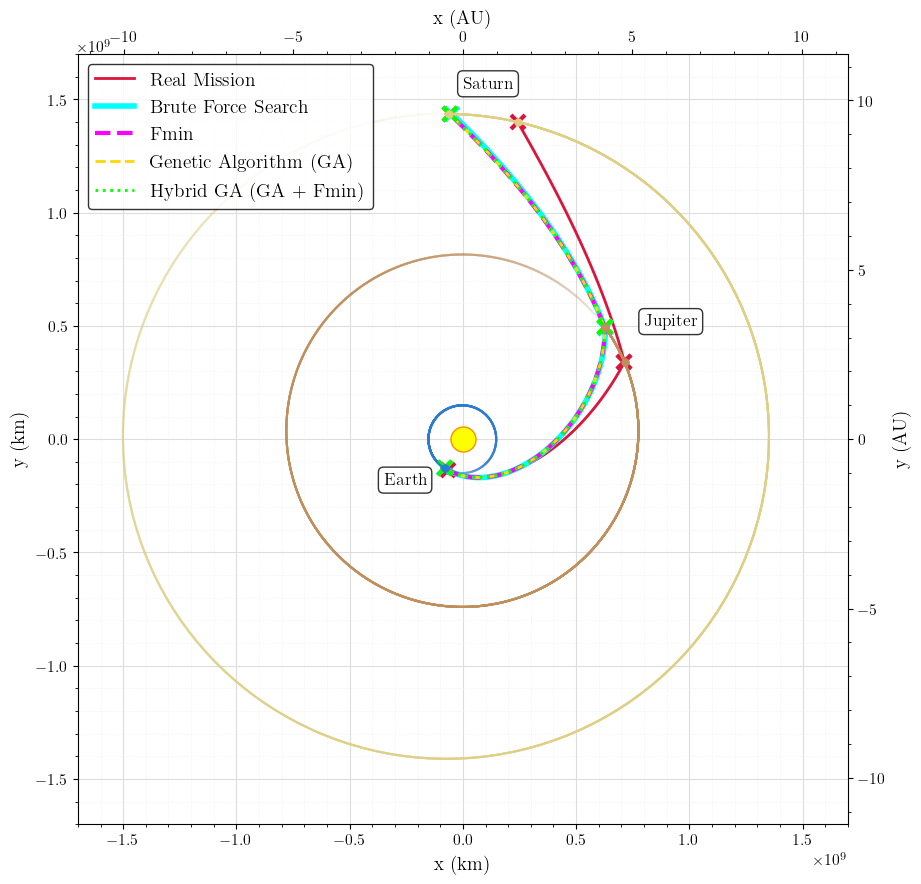

In [175]:
set_font_sizes(14)

colours = {
    "Real Mission": "crimson",
    "Brute Force Search": "cyan",
    "Fmin": "magenta",
    "Genetic Algorithm": "gold",
    "Hybrid GA": "lime",
}

# Distinct line styles to prevent visual merging
line_styles = {
    "Real Mission": "-",
    "Brute Force Search": "-",
    "Fmin": "--",
    "Genetic Algorithm": "--",  # (0, (5, 1)),
    "Hybrid GA": ":",
}

# Define different line widths for clarity
line_widths = {
    "Real Mission": 2,
    "Brute Force Search": 4,
    "Fmin": 3,
    "Genetic Algorithm": 2,
    "Hybrid GA": 2,
}

# Create figure and axis
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111)
plotter = StaticOrbitPlotter(ax)

# Plot missions
plot_VoyagerI(
    date_departure,
    date_flyby_jupiter,
    date_flyby_saturn,
    colours["Real Mission"],
    label_suffix="(Real Mission)",
)
plot_VoyagerI(
    date_departure_BRUTE_MIN,
    date_flyby_jupiter_BRUTE_MIN,
    date_flyby_saturn_BRUTE_MIN,
    colours["Brute Force Search"],
    label_suffix="(Brute Force Search)",
)
plot_VoyagerI(
    date_departure_FMIN,
    date_flyby_jupiter_FMIN,
    date_flyby_saturn_FMIN,
    colours["Fmin"],
    label_suffix="(Fmin)",
)
plot_VoyagerI(
    date_departure_GA,
    date_flyby_jupiter_GA,
    date_flyby_saturn_GA,
    colours["Genetic Algorithm"],
    label_suffix="(Genetic Algorithm)",
)
plot_VoyagerI(
    date_departure_GA_FMIN_COMBINED,
    date_flyby_jupiter_GA_FMIN_COMBINED,
    date_flyby_saturn_GA_FMIN_COMBINED,
    colours["Hybrid GA"],
    label_suffix="(Hybrid GA)",
)

# Set fixed limits for primary axis
limit = 1.7e9
ax.set_xlim(-limit, limit)
ax.set_ylim(-limit, limit)
ax.set_aspect("equal")  # Square aspect ratio

ax.set_xlabel("x (km)", labelpad=5)  # , fontsize=12)
ax.set_ylabel("y (km)", labelpad=5)  # , fontsize=12)

# Conversion factor (1 AU = 149,597,870.691 km)
km_to_AU = 1 / 149597870.691

# Create second set of axes for AU scale
# These won't be linked to the primary axes in the problematic way
ax_top = fig.add_axes(ax.get_position(), frameon=False)
ax_top.xaxis.tick_top()
ax_top.yaxis.tick_right()
ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
ax_top.set_xlabel("x (AU)", labelpad=5)  # , fontsize=12)
ax_top.set_ylabel("y (AU)", labelpad=5)  # , fontsize=12)
ax_top.xaxis.set_label_position("top")
ax_top.yaxis.set_label_position("right")

# # Add grid
ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax.minorticks_on()
# ax_top.grid(which='major', color='#DDDDDD', linewidth=0.8)
# ax_top.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax_top.minorticks_on()

# Customise tick parameters
ax.tick_params(
    axis="both",
    which="major",
)  # labelsize=10)
ax.tick_params(
    axis="both",
    which="minor",
)  # labelsize=8)
ax_top.tick_params(
    axis="both",
    which="major",
)  # labelsize=10)
ax_top.tick_params(
    axis="both",
    which="minor",
)  # labelsize=8)

# Add title
# plt.title(r"\textbf{Voyager I Mission Trajectory Optimisation}", pad=10, fontsize=14)


# Function to update AU axes when primary axes change
def update_au_axes(event=None):
    ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
    ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
    fig.canvas.draw_idle()


# Connect the update function to the 'xlim_changed' and 'ylim_changed' events
ax.callbacks.connect("xlim_changed", update_au_axes)
ax.callbacks.connect("ylim_changed", update_au_axes)

# Apply line styles
for line in ax.get_lines():
    label = line.get_label()
    for key in line_styles:
        if key in label:
            line.set_linestyle(line_styles[key])
            line.set_linewidth(line_widths[key])

# Create custom legend
handles = [
    Line2D(
        [0],
        [0],
        color=colours["Real Mission"],
        ls=line_styles["Real Mission"],
        lw=line_widths["Real Mission"],
        label="Real Mission",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Brute Force Search"],
        ls=line_styles["Brute Force Search"],
        lw=line_widths["Brute Force Search"],
        label="Brute Force Search",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Fmin"],
        ls=line_styles["Fmin"],
        lw=line_widths["Fmin"],
        label="Fmin",  # r"\texttt{fmin}",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Genetic Algorithm"],
        ls=line_styles["Genetic Algorithm"],
        lw=line_widths["Genetic Algorithm"],
        label="Genetic Algorithm (GA)",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Hybrid GA"],
        ls=line_styles["Hybrid GA"],
        lw=line_widths["Hybrid GA"],
        label=r"Hybrid GA (GA + Fmin)",
    ),
]


ax.plot(
    0,
    0,
    "o",
    markersize=18,
    markerfacecolor="#FFFF00",
    markeredgecolor="#FF8C00",
    markeredgewidth=1,
    zorder=100,
)

# Add legend
ax.legend(
    handles=handles, loc="upper left", ncol=1, frameon=True, edgecolor="black"
)  # , fontsize = 11)

# Planet colors
planet_colors = {
    "Earth": "#3366FF",  # Blue
    "Jupiter": "#FF9933",  # Orange
    "Saturn": "#FFCC33",  # Yellow
}

# Use the new label positions provided
planet_label_positions = {
    "Earth": (-0.35e9, -0.2e9),
    "Jupiter": (0.8e9, 0.5e9),
    "Saturn": (0e9, 1.55e9),
}

# Add each planet marker and label
for planet, position in planet_label_positions.items():
    x, y = position

    # Use the absolute positions for labels instead of offsets
    label_x, label_y = planet_label_positions[planet]

    bbox_props = dict(boxstyle="round,pad=0.3", fc="white", ec="black", alpha=0.8)
    ax.annotate(
        planet,
        xy=(x, y),  # Position of the planet
        xytext=(label_x, label_y),  # Absolute position for the label
        textcoords="data",  # Changed from 'offset points' to 'data'
        bbox=bbox_props,
        # fontsize=12,
        fontweight="bold",
        zorder=101,  # Ensure labels appear on top of everything
    )  # Add arrow connecting label to planet

# Save figure with padding
output_figures.save_file("voyager_I_trajectory_km_AU.png", dpi=500, bbox_inches="tight")

# Show plot
plt.show()

In [176]:
dates_REAL

[43394.38055555569, 43937.503472222015, 44555.99027777789]

### 2-Axis Zoomed

Figure saved to: Voyager 1 - Figures/voyager_I_trajectory_zoom.png


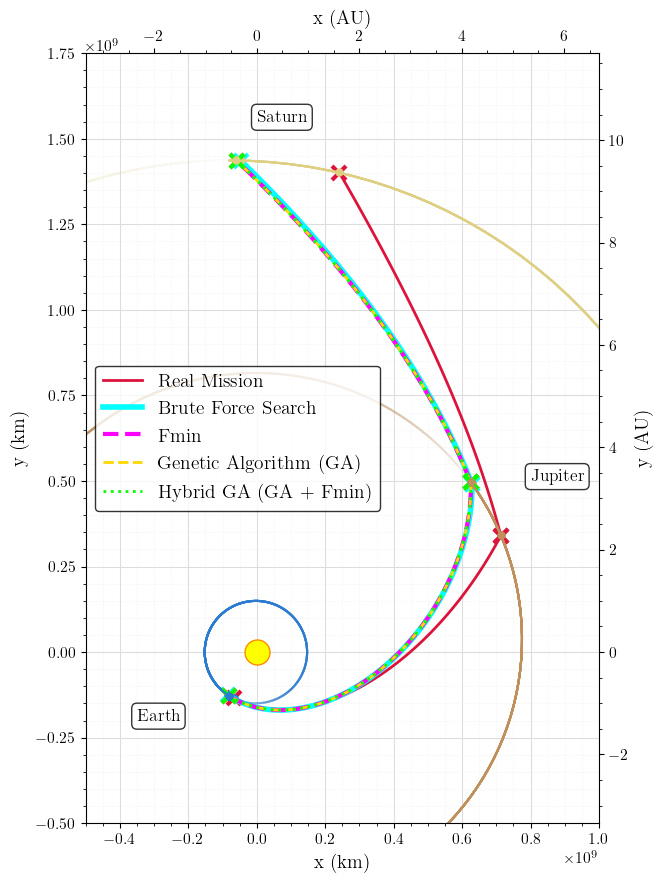

In [178]:
set_font_sizes(14)

fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111)
plotter = StaticOrbitPlotter(ax)

# Plot missions
plot_VoyagerI(
    date_departure,
    date_flyby_jupiter,
    date_flyby_saturn,
    colours["Real Mission"],
    label_suffix="(Real Mission)",
)
plot_VoyagerI(
    date_departure_BRUTE_MIN,
    date_flyby_jupiter_BRUTE_MIN,
    date_flyby_saturn_BRUTE_MIN,
    colours["Brute Force Search"],
    label_suffix="(Brute Force Search)",
)
plot_VoyagerI(
    date_departure_FMIN,
    date_flyby_jupiter_FMIN,
    date_flyby_saturn_FMIN,
    colours["Fmin"],
    label_suffix="(Fmin)",
)
plot_VoyagerI(
    date_departure_GA,
    date_flyby_jupiter_GA,
    date_flyby_saturn_GA,
    colours["Genetic Algorithm"],
    label_suffix="(Genetic Algorithm)",
)
plot_VoyagerI(
    date_departure_GA_FMIN_COMBINED,
    date_flyby_jupiter_GA_FMIN_COMBINED,
    date_flyby_saturn_GA_FMIN_COMBINED,
    colours["Hybrid GA"],
    label_suffix="(Hybrid GA)",
)

# Set fixed limits for primary axis
ax.set_xlim(-0.5e9, 1e9)
ax.set_ylim(-0.5e9, 1.75e9)
ax.set_aspect("equal")  # Square aspect ratio

ax.set_xlabel("x (km)", labelpad=5)  # , fontsize=12)
ax.set_ylabel("y (km)", labelpad=5)  # , fontsize=12)

# Conversion factor (1 AU = 149,597,870.691 km)
km_to_AU = 1 / 149597870.691

# Create second set of axes for AU scale
ax_top = fig.add_axes(ax.get_position(), frameon=False)
ax_top.xaxis.tick_top()
ax_top.yaxis.tick_right()
ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
ax_top.set_xlabel("x (AU)")  # , fontsize=12)
ax_top.set_ylabel("y (AU)")  # , fontsize=12)
ax_top.xaxis.set_label_position("top")
ax_top.yaxis.set_label_position("right")

# Add grid
ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax.minorticks_on()
# ax_top.grid(which='major', color='#DDDDDD', linewidth=0.8)
# ax_top.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)
ax_top.minorticks_on()

# Customize tick parameters
ax.tick_params(
    axis="both",
    which="major",
)  # labelsize=10)
ax.tick_params(
    axis="both",
    which="minor",
)  # labelsize=8)
ax_top.tick_params(
    axis="both",
    which="major",
)  # labelsize=10)
ax_top.tick_params(
    axis="both",
    which="minor",
)  # labelsize=8)

# Add title
# plt.title(r"\textbf{Voyager I Mission Trajectory Optimisation}", pad=10)


# Function to update AU axes when primary axes change
def update_au_axes(event=None):
    ax_top.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
    ax_top.set_ylim(ax.get_ylim()[0] * km_to_AU, ax.get_ylim()[1] * km_to_AU)
    fig.canvas.draw_idle()


# Connect the update function to the 'xlim_changed' and 'ylim_changed' events
ax.callbacks.connect("xlim_changed", update_au_axes)
ax.callbacks.connect("ylim_changed", update_au_axes)

# Apply line styles
for line in ax.get_lines():
    label = line.get_label()
    for key in line_styles:
        if key in label:
            line.set_linestyle(line_styles[key])
            line.set_linewidth(line_widths[key])

# Create custom legend
handles = [
    Line2D(
        [0],
        [0],
        color=colours["Real Mission"],
        ls=line_styles["Real Mission"],
        lw=line_widths["Real Mission"],
        label="Real Mission",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Brute Force Search"],
        ls=line_styles["Brute Force Search"],
        lw=line_widths["Brute Force Search"],
        label="Brute Force Search",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Fmin"],
        ls=line_styles["Fmin"],
        lw=line_widths["Fmin"],
        label="Fmin",  # r"\texttt{fmin}",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Genetic Algorithm"],
        ls=line_styles["Genetic Algorithm"],
        lw=line_widths["Genetic Algorithm"],
        label="Genetic Algorithm (GA)",
    ),
    Line2D(
        [0],
        [0],
        color=colours["Hybrid GA"],
        ls=line_styles["Hybrid GA"],
        lw=line_widths["Hybrid GA"],
        label=r"Hybrid GA (GA + Fmin)",
    ),
]


ax.plot(
    0,
    0,
    "o",
    markersize=18,
    markerfacecolor="#FFFF00",
    markeredgecolor="#FF8C00",
    markeredgewidth=1,
    zorder=100,
)

# Add legend
ax.legend(handles=handles, loc="best", ncol=1, frameon=True, edgecolor="black")

# Add each planet marker and label
for planet, position in planet_label_positions.items():
    x, y = position

    # Use the absolute positions for labels instead of offsets
    label_x, label_y = planet_label_positions[planet]

    bbox_props = dict(boxstyle="round,pad=0.3", fc="white", ec="black", alpha=0.8)
    ax.annotate(
        planet,
        xy=(x, y),  # Position of the planet
        xytext=(label_x, label_y),  # Absolute position for the label
        textcoords="data",  # Changed from 'offset points' to 'data'
        bbox=bbox_props,
        # fontsize=12,
        fontweight="bold",
        zorder=101,  # Ensure labels appear on top of everything
    )  # Add arrow connecting label to planet

output_figures.save_file("voyager_I_trajectory_zoom.png", dpi=500, bbox_inches="tight")

# Show plot
plt.show()

## Genetic Algorithm (GA) Animation

### Orbital Trajectory per Generation

In [181]:
if not testing_flag:
    # Ensure real mission is first in the best solutions list
    best_solutions_per_generation, len(best_solutions_per_generation)

In [182]:
if not testing_flag:
    fig, ax = plt.subplots(figsize=(9, 7))
    plt.close(fig)  # This prevents the initial empty figure from showing

    plotter = StaticOrbitPlotter(ax)

    # Store previously plotted trajectories
    plotted_trajectories = []

    # Select a colour map (viridis, plasma, coolwarm, rainbow, etc.)
    cmap = plt.cm.rainbow  # Change this for different color gradients

    # Flag to track if we've plotted the real mission trajectory
    real_mission_plotted = False

    # Function to update the plot at each generation
    def update(frame):
        global real_mission_plotted

        # Plot the real mission trajectory only once at the first frame
        if frame == 0:
            # Plot real mission in red
            real_traj = plot_VoyagerI(
                date_departure,
                date_flyby_jupiter,
                date_flyby_saturn,
                "red",
                label_suffix="(Real Mission)",
            )
            plotted_trajectories.append(real_traj)
            real_mission_plotted = True
        else:
            # Get best trajectory for this generation
            best_traj = best_solutions_per_generation[frame - 1]
            date_departure_gen, date_flyby_jupiter_gen, date_flyby_saturn_gen = (
                best_traj
            )

            # Convert MJD to calendar date
            date_departure_gen = MJD_to_TT_calander_date(date_departure_gen)
            date_flyby_jupiter_gen = MJD_to_TT_calander_date(date_flyby_jupiter_gen)
            date_flyby_saturn_gen = MJD_to_TT_calander_date(date_flyby_saturn_gen)

            # Normalise color based on generation number
            norm_color = cmap(frame / len(best_solutions_per_generation))

            # Plot new trajectory with gradient color
            traj_plot = plot_VoyagerI(
                date_departure_gen,
                date_flyby_jupiter_gen,
                date_flyby_saturn_gen,
                norm_color,
                label_suffix=f"(Gen {frame-1})",
            )

            # Store the trajectory plot for reference
            plotted_trajectories.append(traj_plot)

        # Hide the legend during animation to prevent clutter
        ax.legend().set_visible(False)

        if frame == 0:
            ax.set_title(r"\textbf{Voyager I GA Optimisation - Real Mission}")
        else:
            # Set title dynamically
            ax.set_title(
                rf"\textbf{{Voyager I GA Optimisation - Generation {frame-1}}}"
            )

        return plotted_trajectories

    # Improve grid and ticks
    ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
    ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
    ax.minorticks_on()

    # Customise tick parameters
    ax.tick_params(
        axis="both",
        which="major",
    )  # labelsize=12)
    ax.tick_params(
        axis="both",
        which="minor",
    )  # labelsize=10)

    plt.tight_layout()

    # Create the animation
    ani = animation.FuncAnimation(
        fig,
        update,
        frames=len(best_solutions_per_generation) + 1,
        repeat=False,
        blit=False,
    )

    # Save the animation as a GIF or MP4
    # ani.save("voyager_I_GA_optimisation.mp4", writer="ffmpeg", fps=5)#, dpi=200, bitrate=-1)
    # ani.save("voyager_I_GA_optimisation.gif", writer="pillow", fps=10, dpi=200)  # Save as GIF

<Figure size 640x480 with 0 Axes>

In [183]:
if not testing_flag:
    # Convert animation to HTML
    html_video = ani.to_jshtml()

    # Display animation inline
    display(HTML(html_video))

In [184]:
if not testing_flag:
    fig, ax = plt.subplots(figsize=(9, 7))
    plt.close(fig)  # This prevents the initial empty figure from showing

    plotter = StaticOrbitPlotter(ax)

    # Store previously plotted trajectories
    plotted_trajectories = []

    # Select a colour map (viridis, plasma, coolwarm, rainbow, etc.)
    cmap = plt.cm.rainbow  # Change this for different color gradients

    # Flag to track if we've plotted the real mission trajectory
    real_mission_plotted = False

    # Improve grid and ticks
    ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
    ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
    ax.minorticks_on()

    # Customise tick parameters
    ax.tick_params(
        axis="both",
        which="major",
    )  # labelsize=12)
    ax.tick_params(
        axis="both",
        which="minor",
    )  # labelsize=10)

    plt.tight_layout()

    # Create the animation
    ani = animation.FuncAnimation(
        fig,
        update,
        frames=len(best_solutions_per_generation) + 1,
        repeat=False,
        blit=False,
    )

    filename_GA_trajectory_per_gen = output_ani.get_path(
        "voyager_I_GA_trajectory_per_gen.gif"
    )

    ani.save(filename_GA_trajectory_per_gen, writer="pillow", fps=10, dpi=200)

<Figure size 640x480 with 0 Axes>


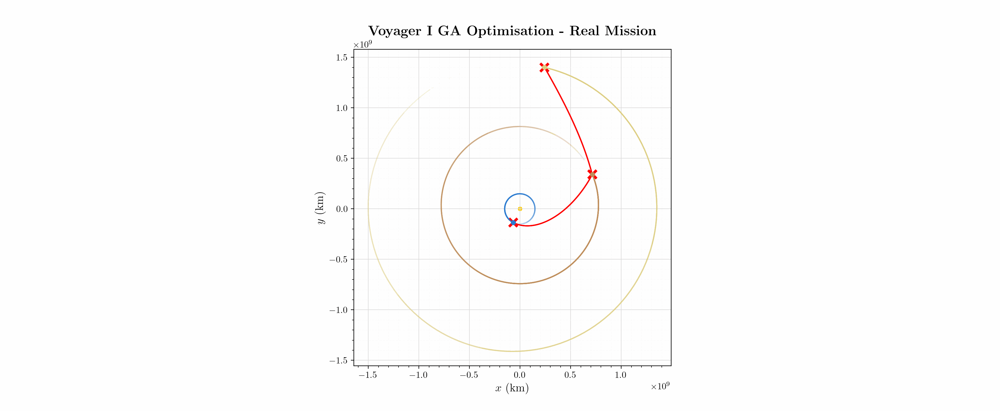

In [185]:
filename_GA_trajectory_per_gen = output_ani.get_path(
    "voyager_I_GA_trajectory_per_gen.gif"
)


def display_saved_gif(filename):
    with open(filename, "rb") as file:
        gif_data = file.read()
    encoded = b64encode(gif_data).decode("ascii")
    html = f'<img src="data:image/gif;base64,{encoded}">'
    return HTML(html)


display(display_saved_gif(filename_GA_trajectory_per_gen))

### GA Problem Space per Generation

In [187]:
if not testing_flag:
    set_font_sizes(12)

    # Function to animate the evolution of the genetic algorithm
    def animate_3d_ga_contour(population_per_generation):
        fig = plt.figure(figsize=(10, 8))
        plt.close(fig)  # This prevents the initial empty figure from showing
        ax = fig.add_subplot(111, projection="3d")
        cmap = plt.cm.viridis_r  # Color map for deltaV values
        cbar = None  # Initialise colorbar variable

        def update(frame):
            nonlocal cbar
            ax.clear()
            generation_idx = frame
            selected_population = population_per_generation[generation_idx]

            # Extract dates and normalise relative to nominal mission dates
            departure_dates_GA = (
                np.array([ind[0] for ind in selected_population]) - date_departure_mjd
            )
            jupiter_flyby_dates_GA = (
                np.array([ind[1] for ind in selected_population])
                - date_flyby_jupiter_mjd
            )
            saturn_flyby_dates_GA = (
                np.array([ind[2] for ind in selected_population])
                - date_flyby_saturn_mjd
            )

            # Compute deltaV for coloring
            deltaV_values_GA = np.array(
                [find_deltaV_mission(*ind)[0] for ind in selected_population]
            )

            scatter = ax.scatter(
                departure_dates_GA,
                jupiter_flyby_dates_GA,
                saturn_flyby_dates_GA,
                c=deltaV_values_GA,
                cmap=parula_map(True),
                s=10,
                alpha=0.3,
                norm=plt.Normalize(
                    vmin=min(deltaV_values_GA), vmax=min(deltaV_values_GA) * 1.5
                ),
            )

            # Mark the best solution for the current generation
            best_individual = selected_population[
                0
            ]  # Best individual of the generation
            ax.scatter(
                best_individual[0] - date_departure_mjd,
                best_individual[1] - date_flyby_jupiter_mjd,
                best_individual[2] - date_flyby_saturn_mjd,
                color="red",
                s=100,
                marker="x",
                label=f"Current Best Solution\nDelta-V: {find_deltaV_mission(*best_individual)[0]:.3f} km/s",
            )

            # Mark the real solution
            ax.scatter(
                [0],
                [0],
                [0],
                color="red",
                s=100,
                marker="o",
                edgecolors="black",
                linewidth=1.2,
                label=f"Real Delta-V: {deltaV_REAL:.3f} km/s",
            )

            # Set labels with increased padding
            ax.set_xlabel(
                "Change in Earth Departure Epoch (days)",
                labelpad=5,
                # fontsize=11
            )
            ax.set_ylabel(
                "Change in Jupiter Flyby Epoch (days)",
                labelpad=5,
                # fontsize=11
            )
            ax.set_zlabel(
                "Change in Saturn Flyby Epoch (days)",
                labelpad=5,
                # fontsize=11
            )

            # Set title with increased padding
            title_text = f"\\textbf{{3D Visualisation of GA Problem Space (Generation {generation_idx})}}"
            ax.set_title(
                r"{}".format(title_text),
            )  # fontsize=14)

            # Format the scientific notation to be more readable
            for axis in [ax.xaxis, ax.yaxis, ax.zaxis]:
                formatter = ScalarFormatter(useOffset=False)
                formatter.set_scientific(True)
                formatter.set_powerlimits(
                    (-3, 3)
                )  # Only use scientific notation for exponents outside this range
                axis.set_major_formatter(formatter)

            # Position the offset text for better visibility
            ax.xaxis.get_offset_text().set_position((0, -0.1))
            ax.yaxis.get_offset_text().set_position((0, -0.1))
            ax.zaxis.get_offset_text().set_position((0, -0.1))

            # Ensure the exponent text is horizontally aligned
            ax.xaxis.get_offset_text().set_ha("left")
            ax.yaxis.get_offset_text().set_ha("left")
            ax.zaxis.get_offset_text().set_ha("left")

            ax.legend(loc="upper left", frameon=True, framealpha=0.9, edgecolor="black")

            limit = 365
            ax.set_xlim(-limit, limit)
            ax.set_ylim(-limit, limit)
            ax.set_zlim(-limit, limit)

            # Add colorbar only once
            if cbar is None:
                cbar = plt.colorbar(
                    scatter, ax=ax, label="$\Delta$V (km/s)", pad=0.1
                )  # Increase padding between plot and colorbar
                cbar.set_label(
                    "$\Delta$V (km/s)",
                    # fontsize=12,
                    labelpad=10,
                )

        ani = animation.FuncAnimation(
            fig, update, frames=len(population_per_generation), repeat=False
        )
        plt.show()
        return ani

    # Example Usage
    ani = animate_3d_ga_contour(population_per_generation)

In [188]:
if not testing_flag:
    # Convert animation to HTML
    html_video = ani.to_jshtml()

    # Display animation inline
    display(HTML(html_video))

<Figure size 640x480 with 0 Axes>

In [189]:
if not testing_flag:
    filename_GA_PS_per_gen = output_ani.get_path(
        "voyager_I_GA_problem_space_per_gen.gif"
    )
    ani.save(filename_GA_PS_per_gen, writer="pillow", fps=10, dpi=200)


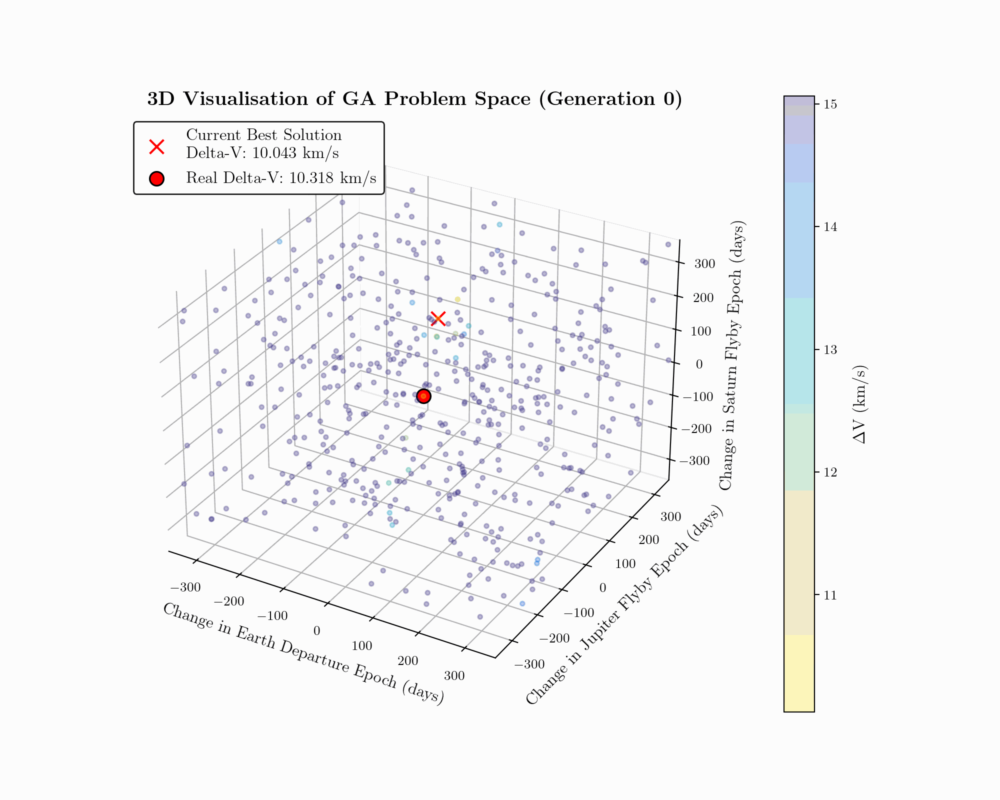

In [190]:
filename_GA_PS_per_gen = output_ani.get_path("voyager_I_GA_problem_space_per_gen.gif")


def display_saved_gif(filename):
    with open(filename, "rb") as file:
        gif_data = file.read()
    encoded = b64encode(gif_data).decode("ascii")
    html = f'<img src="data:image/gif;base64,{encoded}">'
    return HTML(html)


display(display_saved_gif(filename_GA_PS_per_gen))

## Final DeltaV \& Fuel Mass

In [192]:
deltaV_REAL, fuel_mass_REAL, data_dict_REAL

(10.317548951648549,
 1039.0,
 {'deltaV_injection (km/s)': 10.303632164583048,
  'deltaV_jupiter (km/s)': 0.013916787065500813,
  'rp_jupiter (km)': 1128397.6009035972,
  'vp_jupiter (km/s)': 18.563754373068818,
  'vp_esc_jupiter (km/s)': 14.986288896889137,
  'deflection_jupiter (deg)': 98.16024165269266,
  'tof (days)': 1161.6097222222015})

In [193]:
deltaV_BRUTE_MIN, fuel_mass_BRUTE_MIN, data_dict_BRUTE_MIN

(9.414558743791737,
 974.2129105251216,
 {'deltaV_injection (km/s)': 9.40484890472681,
  'deltaV_jupiter (km/s)': 0.00970983906492684,
  'rp_jupiter (km)': 2524164.458046279,
  'vp_jupiter (km/s)': 12.454829104716957,
  'vp_esc_jupiter (km/s)': 10.019968444803236,
  'deflection_jupiter (deg)': 95.05313271987167,
  'tof (days)': 1519.1607426303601})

In [194]:
deltaV_FMIN, fuel_mass_FMIN, data_dict_FMIN

(9.38803007413873,
 972.2489748561145,
 {'deltaV_injection (km/s)': 9.388030073914551,
  'deltaV_jupiter (km/s)': 2.24178009489151e-10,
  'rp_jupiter (km)': 2584504.202308533,
  'vp_jupiter (km/s)': 12.313400192809324,
  'vp_esc_jupiter (km/s)': 9.902310866411128,
  'deflection_jupiter (deg)': 94.79802898045975,
  'tof (days)': 1532.6189219878652})

In [195]:
deltaV_GA, fuel_mass_GA, data_dict_GA

(9.388030090634013,
 972.2489760783692,
 {'deltaV_injection (km/s)': 9.388030089505241,
  'deltaV_jupiter (km/s)': 1.128771742742174e-09,
  'rp_jupiter (km)': 2584504.0014122305,
  'vp_jupiter (km/s)': 12.313401660031868,
  'vp_esc_jupiter (km/s)': 9.902311251269808,
  'deflection_jupiter (deg)': 94.79796238687835,
  'tof (days)': 1532.6170664711608})

In [196]:
deltaV_GA_FMIN_COMBINED, fuel_mass_GA_FMIN_COMBINED, data_dict_GA_FMIN_COMBINED

(9.388030090634013,
 972.2489760783692,
 {'deltaV_injection (km/s)': 9.388030089505241,
  'deltaV_jupiter (km/s)': 1.128771742742174e-09,
  'rp_jupiter (km)': 2584504.0014122305,
  'vp_jupiter (km/s)': 12.313401660031868,
  'vp_esc_jupiter (km/s)': 9.902311251269808,
  'deflection_jupiter (deg)': 94.79796238687835,
  'tof (days)': 1532.6170664711608})

In [197]:
deltaVs = {
    "Real Mission": deltaV_REAL,
    "Brute Force Search": deltaV_BRUTE_MIN,
    "Fmin": deltaV_FMIN,
    "Genetic Algorithm": deltaV_GA,
    "Hybrid GA": deltaV_GA_FMIN_COMBINED,
}

for method in deltaVs:
    print(f"{method}: {deltaVs[method]:.4f} km/s")

Real Mission: 10.3175 km/s
Brute Force Search: 9.4146 km/s
Fmin: 9.3880 km/s
Genetic Algorithm: 9.3880 km/s
Hybrid GA: 9.3880 km/s


In [198]:
data_dict_REAL

{'deltaV_injection (km/s)': 10.303632164583048,
 'deltaV_jupiter (km/s)': 0.013916787065500813,
 'rp_jupiter (km)': 1128397.6009035972,
 'vp_jupiter (km/s)': 18.563754373068818,
 'vp_esc_jupiter (km/s)': 14.986288896889137,
 'deflection_jupiter (deg)': 98.16024165269266,
 'tof (days)': 1161.6097222222015}

In [199]:
deltaV_injection_list = {
    "Real Mission": data_dict_REAL["deltaV_injection (km/s)"],
    "Brute Force Search": data_dict_BRUTE_MIN["deltaV_injection (km/s)"],
    "Fmin": data_dict_FMIN["deltaV_injection (km/s)"],
    "Genetic Algorithm": data_dict_GA["deltaV_injection (km/s)"],
    "Hybrid GA": data_dict_GA_FMIN_COMBINED["deltaV_injection (km/s)"],
}

for method in deltaV_injection_list:
    print(f"{method}: {deltaV_injection_list[method]:.4f} km/s")

Real Mission: 10.3036 km/s
Brute Force Search: 9.4048 km/s
Fmin: 9.3880 km/s
Genetic Algorithm: 9.3880 km/s
Hybrid GA: 9.3880 km/s


In [200]:
deltaV_jupiter_flyby_list = {
    "Real Mission": data_dict_REAL["deltaV_jupiter (km/s)"],
    "Brute Force Search": data_dict_BRUTE_MIN["deltaV_jupiter (km/s)"],
    "Fmin": data_dict_FMIN["deltaV_jupiter (km/s)"],
    "Genetic Algorithm": data_dict_GA["deltaV_jupiter (km/s)"],
    "Hybrid GA": data_dict_GA_FMIN_COMBINED["deltaV_jupiter (km/s)"],
}

for method in deltaV_jupiter_flyby_list:
    print(f"{method}: {deltaV_jupiter_flyby_list[method]} km/s")

Real Mission: 0.013916787065500813 km/s
Brute Force Search: 0.00970983906492684 km/s
Fmin: 2.24178009489151e-10 km/s
Genetic Algorithm: 1.128771742742174e-09 km/s
Hybrid GA: 1.128771742742174e-09 km/s


In [201]:
tof_list = {
    "Real Mission": data_dict_REAL["tof (days)"],
    "Brute Force Search": data_dict_BRUTE_MIN["tof (days)"],
    "Fmin": data_dict_FMIN["tof (days)"],
    "Genetic Algorithm": data_dict_GA["tof (days)"],
    "Hybrid GA": data_dict_GA_FMIN_COMBINED["tof (days)"],
}

for method in tof_list:
    print(f"{method}: {tof_list[method]:.2f} days")

Real Mission: 1161.61 days
Brute Force Search: 1519.16 days
Fmin: 1532.62 days
Genetic Algorithm: 1532.62 days
Hybrid GA: 1532.62 days


In [202]:
fuel_mass_values = {
    "Real Mission": fuel_mass_REAL,
    "Brute Force Search": fuel_mass_BRUTE_MIN,
    "Fmin": fuel_mass_FMIN,
    "Genetic Algorithm": fuel_mass_GA,
    "Hybrid GA": fuel_mass_GA_FMIN_COMBINED,
}

for method in fuel_mass_values:
    print(f"{method}: {fuel_mass_values[method]:.2f} kg")

Real Mission: 1039.00 kg
Brute Force Search: 974.21 kg
Fmin: 972.25 kg
Genetic Algorithm: 972.25 kg
Hybrid GA: 972.25 kg


In [203]:
execution_time_dict = {
    "Brute Force Search": execution_time_BRUTE_FORCE,
    "Fmin": execution_time_FMIN,
    "Genetic Algorithm": execution_time_GA,
    "Hybrid GA": execution_time_GA_FMIN_COMBINED_total,
}

for method, time in execution_time_dict.items():
    print(f"{method}: {time:.2f} seconds")

Brute Force Search: 315.44 seconds
Fmin: 1.19 seconds
Genetic Algorithm: 189.35 seconds
Hybrid GA: 189.75 seconds


In [204]:
from datetime import datetime


def format_dates_to_standard(date_list):
    formatted_dates = {}

    for method in date_list:
        # Check if the date is already a datetime object
        if isinstance(date_list[method], datetime):
            formatted_date = date_list[method].strftime("%d/%m/%Y %H:%M:%S")
        else:
            try:
                # Try to parse the string into a datetime object
                format_string = (
                    "%Y-%m-%d %H:%M:%S.%f"
                    if "." in str(date_list[method])
                    else "%Y-%m-%d %H:%M"
                )
                dt = datetime.strptime(str(date_list[method]), format_string)
                formatted_date = dt.strftime("%d/%m/%Y %H:%M:%S")
            except ValueError:
                # If parsing fails, keep the original value
                formatted_date = str(date_list[method])
                print(
                    f"Warning: Could not parse date for {method}: {date_list[method]}"
                )

        formatted_dates[method] = formatted_date

    return formatted_dates

In [205]:
date_departure_list = {
    "Real Mission": date_departure,
    "Brute Force Search": date_departure_BRUTE_MIN,
    "Fmin": date_departure_FMIN,
    "Genetic Algorithm": date_departure_GA,
    "Hybrid GA": date_departure_GA_FMIN_COMBINED,
}

for method in date_departure_list:
    print(f"{method}: {date_departure_list[method]}")

print()

format_dates_to_standard(date_departure_list)

Real Mission: 1977-09-08 09:08
Brute Force Search: 1977-08-31 22:21:28.163
Fmin: 1977-09-02 08:54:45.131
Genetic Algorithm: 1977-09-02 08:57:25.044
Hybrid GA: 1977-09-02 08:57:25.044



{'Real Mission': '08/09/1977 09:08:00',
 'Brute Force Search': '31/08/1977 22:21:28',
 'Fmin': '02/09/1977 08:54:45',
 'Genetic Algorithm': '02/09/1977 08:57:25',
 'Hybrid GA': '02/09/1977 08:57:25'}

In [206]:
from datetime import datetime

date_flyby_jupiter_list = {
    "Real Mission": date_flyby_jupiter,
    "Brute Force Search": date_flyby_jupiter_BRUTE_MIN,
    "Fmin": date_flyby_jupiter_FMIN,
    "Genetic Algorithm": date_flyby_jupiter_GA,
    "Hybrid GA": date_flyby_jupiter_GA_FMIN_COMBINED,
}

for method in date_flyby_jupiter_list:
    print(f"{method}: {date_flyby_jupiter_list[method]}")

print()

format_dates_to_standard(date_flyby_jupiter_list)

Real Mission: 1979-03-05 12:05
Brute Force Search: 1979-08-08 22:22:08.571
Fmin: 1979-08-14 10:52:57.199
Genetic Algorithm: 1979-08-14 10:53:11.581
Hybrid GA: 1979-08-14 10:53:11.581



{'Real Mission': '05/03/1979 12:05:00',
 'Brute Force Search': '08/08/1979 22:22:08',
 'Fmin': '14/08/1979 10:52:57',
 'Genetic Algorithm': '14/08/1979 10:53:11',
 'Hybrid GA': '14/08/1979 10:53:11'}

In [207]:
from datetime import datetime

date_flyby_saturn_list = {
    "Real Mission": date_flyby_saturn,
    "Brute Force Search": date_flyby_saturn_BRUTE_MIN,
    "Fmin": date_flyby_saturn_FMIN,
    "Genetic Algorithm": date_flyby_saturn_GA,
    "Hybrid GA": date_flyby_saturn_GA_FMIN_COMBINED,
}

for method in date_flyby_saturn_list:
    print(f"{method}: {date_flyby_saturn_list[method]}")

print()

format_dates_to_standard(date_flyby_saturn_list)

Real Mission: 1980-11-12 23:46
Brute Force Search: 1981-10-29 02:12:56.327
Fmin: 1981-11-12 23:45:59.991
Genetic Algorithm: 1981-11-12 23:45:59.587
Hybrid GA: 1981-11-12 23:45:59.587



{'Real Mission': '12/11/1980 23:46:00',
 'Brute Force Search': '29/10/1981 02:12:56',
 'Fmin': '12/11/1981 23:45:59',
 'Genetic Algorithm': '12/11/1981 23:45:59',
 'Hybrid GA': '12/11/1981 23:45:59'}

### Comparsion Table

In [209]:
methods = [
    "Real Mission",
    "Brute Force Search",
    "Fmin",
    "Genetic Algorithm",
    "Hybrid GA",
]

In [210]:
data = {
    "Total Delta-V (km/s)": [deltaVs[method] for method in methods],
    "Injection Delta-V (km/s)": [deltaV_injection_list[method] for method in methods],
    "Jupiter Flyby Delta-V (km/s)": [
        deltaV_jupiter_flyby_list[method] for method in methods
    ],
    "Total Fuel Mass (kg)": [fuel_mass_values[method] for method in methods],
    "TOF (days)": [tof_list[method] for method in methods],
    "Departure Change (days)": np.array(
        [
            0,
            change_in_dates_list_BRUTE_MIN[0],
            change_in_dates_list_FMIN[0],
            change_in_dates_list_GA[0],
            change_in_dates_list_GA_FMIN_COMBINED[0],
        ]
    ),
    "Jupiter Flyby Change (days)": np.array(
        [
            0,
            change_in_dates_list_BRUTE_MIN[1],
            change_in_dates_list_FMIN[1],
            change_in_dates_list_GA[1],
            change_in_dates_list_GA_FMIN_COMBINED[1],
        ]
    ),
    "Saturn Flyby Change (days)": np.array(
        [
            0,
            change_in_dates_list_BRUTE_MIN[2],
            change_in_dates_list_FMIN[2],
            change_in_dates_list_GA[2],
            change_in_dates_list_GA_FMIN_COMBINED[2],
        ]
    ),
    "Execution Time (s)": [execution_time_dict.get(method, None) for method in methods],
}

df = pd.DataFrame(data, index=methods)
display(df)

,Total Delta-V (km/s),Injection Delta-V (km/s),Jupiter Flyby Delta-V (km/s),Total Fuel Mass (kg),TOF (days),Departure Change (days),Jupiter Flyby Change (days),Saturn Flyby Change (days),Execution Time (s)
Real Mission,10.317549,10.303632,1.391679e-02,1039.000000,1161.609722,0.000000,0.000000,0.000000,NaN
Brute Force Search,9.414559,9.404849,9.709839e-03,974.212911,1519.160743,-7.448980,156.428571,350.102041,315.442079
Fmin,9.388030,9.388030,2.241780e-10,972.248975,1532.618922,-6.009200,161.949968,365.000000,1.193000
Genetic Algorithm,9.388030,9.388030,1.128772e-09,972.248976,1532.617066,-6.007349,161.950134,364.999995,189.349300
Hybrid GA,9.388030,9.388030,1.128772e-09,972.248976,1532.617066,-6.007349,161.950134,364.999995,189.752918


In [211]:
df = pd.DataFrame(data, index=methods)
df_transposed = df.transpose()
# df_transposed.to_csv('voyager_mission_comparison.csv')
display(df_transposed)

,Real Mission,Brute Force Search,Fmin,Genetic Algorithm,Hybrid GA
Total Delta-V (km/s),10.317549,9.414559,9.388030e+00,9.388030e+00,9.388030e+00
Injection Delta-V (km/s),10.303632,9.404849,9.388030e+00,9.388030e+00,9.388030e+00
Jupiter Flyby Delta-V (km/s),0.013917,0.009710,2.241780e-10,1.128772e-09,1.128772e-09
Total Fuel Mass (kg),1039.000000,974.212911,9.722490e+02,9.722490e+02,9.722490e+02
TOF (days),1161.609722,1519.160743,1.532619e+03,1.532617e+03,1.532617e+03
Departure Change (days),0.000000,-7.448980,-6.009200e+00,-6.007349e+00,-6.007349e+00
Jupiter Flyby Change (days),0.000000,156.428571,1.619500e+02,1.619501e+02,1.619501e+02
Saturn Flyby Change (days),0.000000,350.102041,3.650000e+02,3.650000e+02,3.650000e+02
Execution Time (s),NaN,315.442079,1.193000e+00,1.893493e+02,1.897529e+02


## Time Execution

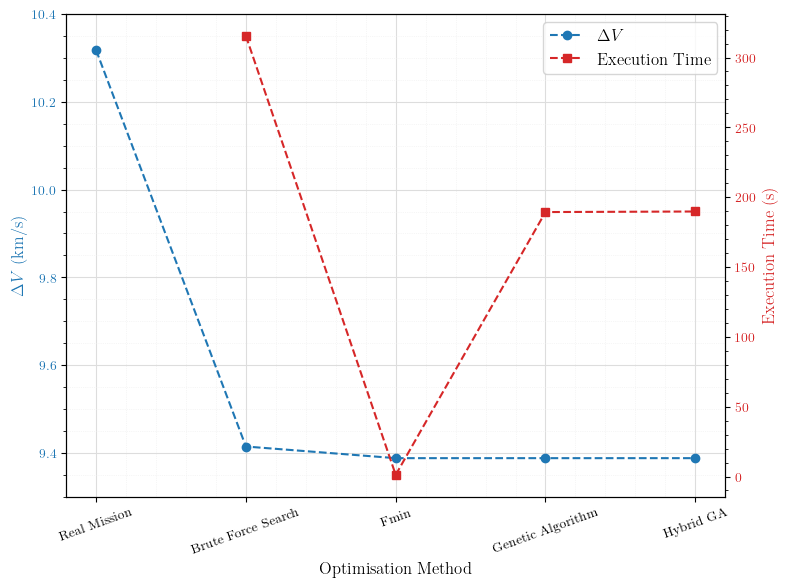

In [213]:
deltaV_values_method = [deltaVs[name] for name in methods]
execution_methods = [
    m for m in methods if m in execution_time_dict
]  # ["Brute Force Search", r"\textt{fmin}", "Genetic Algorithm", r"GA + \textt{fmin}"]
execution_times = [execution_time_dict[name] for name in execution_time_dict]

# Convert to numpy arrays for plotting
deltaV_values_method = np.array(deltaV_values_method, dtype=float)
execution_times = np.array(execution_times, dtype=float)

fig, ax1 = plt.subplots(figsize=(8, 6))

# Plot delta-V
ax1.set_xlabel("Optimisation Method")
ax1.set_ylabel("$\Delta V$ (km/s)", color="tab:blue")
ax1.plot(
    methods,
    deltaV_values_method,
    marker="o",
    linestyle="--",
    color="tab:blue",
    label="$\Delta V$",
)
ax1.tick_params(axis="y", labelcolor="tab:blue")
ax1.set_xticks(range(len(methods)))
ax1.set_xticklabels(
    methods,
    ha="center",
    rotation=20,
)  # fontsize=12)

# Secondary axis for execution time
ax2 = ax1.twinx()
ax2.set_ylabel("Execution Time (s)", color="tab:red")
ax2.plot(
    execution_methods,
    execution_times,
    marker="s",
    linestyle="--",
    color="tab:red",
    label="Execution Time",
)
ax2.tick_params(axis="y", labelcolor="tab:red")

# Add legends
ax1.legend(
    loc="upper right",
    handles=ax1.lines + ax2.lines,
    labels=["$\Delta V$", "Execution Time"],
)

# Improve grid and ticks
ax1.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax1.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)

ax1.minorticks_on()
ax2.minorticks_on()
ax1.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)
ax2.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)

ax1.tick_params(axis="x", which="minor", length=0)

ax1.set_ylim(9.3, 10.4)
# ax2.set_ylim(0,500)

# Show title
# plt.title("$\Delta V$ and Execution Time")
plt.tight_layout()
plt.show()

Figure saved to: Voyager 1 - Figures/voyager_I_time_execution_comparison.png


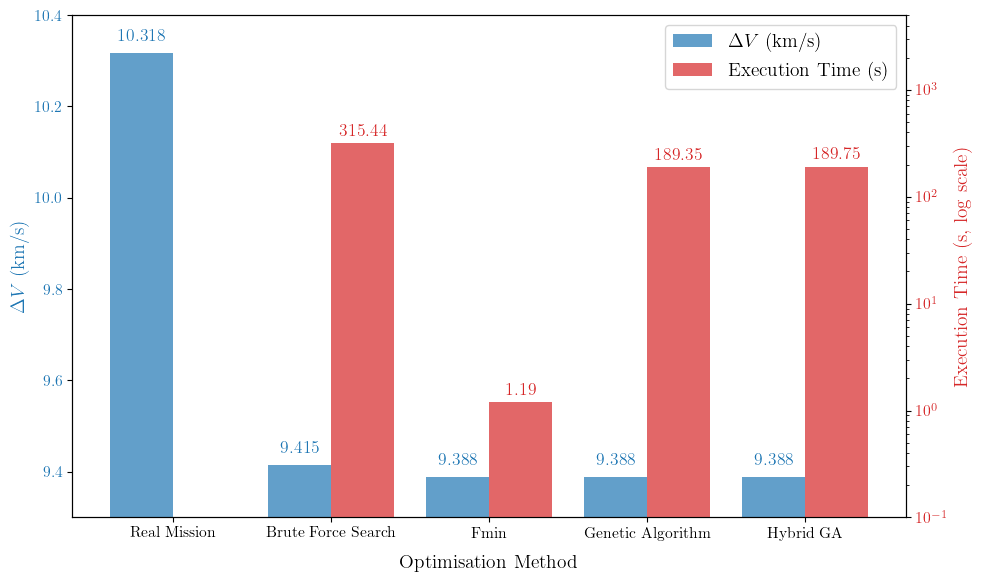

In [214]:
set_font_sizes(14)

execution_methods = [m for m in methods if m in execution_time_dict]
execution_times = [execution_time_dict[name] for name in execution_methods]

# Get all methods for deltaV plotting
deltaV_values_method = [deltaVs[name] for name in methods]

deltaV_values_method = np.array(deltaV_values_method, dtype=float)
execution_times = np.array(execution_times, dtype=float)

fig, ax1 = plt.subplots(figsize=(10, 6))

ax1.set_xlabel("Optimisation Method", labelpad=10)  # , fontsize=12)
ax1.set_ylabel("$\Delta V$ (km/s)", color="tab:blue")  # , fontsize=12)
bars1 = ax1.bar(
    np.arange(len(methods)) - 0.2,
    deltaV_values_method,
    width=0.4,
    color="tab:blue",
    alpha=0.7,
    label="$\Delta V$",
)
ax1.tick_params(axis="y", labelcolor="tab:blue")
ax1.set_xticks(range(len(methods)))
ax1.set_xticklabels(methods, ha="center")  # , fontsize=12)
ax1.set_ylim(9.3, 10.4)

for i, bar in enumerate(bars1):
    height = bar.get_height()
    ax1.text(
        bar.get_x() + bar.get_width() / 2.0,
        height + 0.02,
        f"{deltaV_values_method[i]:.3f}",
        ha="center",
        va="bottom",
        color="tab:blue",
    )  # , fontsize=10)

# Secondary axis for execution time (logarithmic scale)
ax2 = ax1.twinx()
ax2.set_ylabel("Execution Time (s, log scale)", color="tab:red")  # , fontsize=12)

# Find the indices of execution methods in the original methods list
exec_indices = [methods.index(m) for m in execution_methods]
bars2 = ax2.bar(
    np.array(exec_indices) + 0.2,
    execution_times,
    width=0.4,
    color="tab:red",
    alpha=0.7,
    label="Execution Time",
)
ax2.set_yscale("log")  # Use logarithmic scale
ax2.tick_params(axis="y", labelcolor="tab:red")

# Add data labels to execution time bars
for i, bar in enumerate(bars2):
    height = bar.get_height()
    ax2.text(
        bar.get_x() + bar.get_width() / 2.0,
        height * 1.1,
        f"{execution_times[i]:.2f}",
        ha="center",
        va="bottom",
        color="tab:red",
    )  # , fontsize=10)

handles = [bars1[0], bars2[0]]  # Get the first bar from each set
labels = ["$\Delta V$ (km/s)", "Execution Time (s)"]
ax1.legend(handles, labels, loc="upper right")  # , fontsize=12)

# ax1.grid(which='major', axis='y', color='#DDDDDD', linewidth=0.8, alpha=0.5)
ax1.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)
ax2.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)

ax1.set_ylim(9.3, 10.4)
ax2.set_ylim(1e-1, 5 * 10**3)

# Show title
# plt.title(r"\textbf{Voyager I: $\Delta V$ \& Execution Time}", fontsize=14, pad=10)
plt.tight_layout()

output_figures.save_file(
    "voyager_I_time_execution_comparison.png", dpi=800, bbox_inches="tight"
)
plt.show()

In [215]:
# math.factorial(20)

## Variation in Heliocentric Velocity along Voyager I Trajectory

### Voyager I NASA Mission Data

Using, https://plotdigitizer.com/app on the real mission NASA data presented in textbook **Hahn-A-Basic-Calculus-of-Planetary-Orbits-and-Interplanetary-Flight-2020-pdf**.

In [218]:
file_path = output_pickle.get_path("V1.csv")
data1 = pd.read_csv(file_path)

data1["x_km"] = data1["x"] * 149597870.691

V1_NASA_distance_from_Sun_km = data1["x_km"]
V1_NASA_distance_from_Sun_AU = data1["x"]  # in AU where 1 AU = 149597870.691 km
V1_NASA_velocity = data1[" y"]

# data1

In [219]:
r_esc = np.linspace(1e-99, 6e9, 1000)
v_esc = np.sqrt(2 * mu_sun / r_esc)

### Comparison with Algorithms

In [221]:
# Known parameters K = [e,a,i,Omega,w,M]
mu = 1.327e11  # Sun's gravitational parameter (km³/s²)


# Compute true anomaly (theta) for 0<e<1 (elliptical orbit)
def elliptic_theta(M, e):
    def find_E(E):
        return E - e * np.sin(E) - M

    E = fsolve(find_E, 0.01)[0]  # Eccentric Anomaly
    theta = 2 * np.arctan(np.tan(E / 2) * np.sqrt((1 + e) / (1 - e)))
    return theta


# Compute true anomaly (theta)  for e=1 (parabolic orbit)
def parabolic_theta(M):
    var = 3 * M + np.sqrt(9 * M**2 + 1)
    B = var ** (1 / 3) - var ** (-1 / 3)  # Barker Parameter
    theta = 2 * np.arctan(B)
    return theta


# Compute true anomaly (theta)  for e>1 (hyperbolic orbit)
def hyperbolic_theta(M, e):
    def find_F(F):
        return e * np.sinh(F) - F - M

    F = fsolve(find_F, 0.01)[0]  # Hyperbolic Eccentric Anomaly
    theta = 2 * np.arctan(np.tanh(F / 2) * np.sqrt((e + 1) / (e - 1)))
    return theta


def forwardTransformation(e, a, i, Omega, w, M, mu, p=None):
    # Compute semi-latus rectum p if not provided
    if p is None:
        if e < 1:
            p = a * (1 - e**2)
        elif e == 1:
            p = 2 * a  # For parabolic orbits, p = 2q where q is periapsis distance
        else:  # e > 1
            p = a * (e**2 - 1)  # For hyperbolic orbits

    # Verify that p is positive
    if p <= 0:
        raise ValueError(f"Semi-latus rectum p must be positive, got {p}")

    # Compute specific angular momentum h
    h = np.sqrt(mu * p)

    # Compute true anomaly from mean anomaly based on orbit type
    if e < 1:
        theta = elliptic_theta(M, e)
    elif e == 1:
        theta = parabolic_theta(M)
    else:
        theta = hyperbolic_theta(M, e)

    # Compute radius
    r = p / (1 + e * np.cos(theta))

    # Compute position and velocity in perifocal coordinates
    r_perifocal = np.array([r * np.cos(theta), r * np.sin(theta), 0])
    v_perifocal = (mu / h) * np.array([-np.sin(theta), e + np.cos(theta), 0])

    # Compute transformation matrix Q
    cos_Omega, sin_Omega = np.cos(Omega), np.sin(Omega)
    cos_w, sin_w = np.cos(w), np.sin(w)
    cos_i, sin_i = np.cos(i), np.sin(i)

    Q = np.array(
        [
            [
                cos_Omega * cos_w - sin_Omega * sin_w * cos_i,
                -cos_Omega * sin_w - sin_Omega * cos_i * cos_w,
                sin_Omega * sin_i,
            ],
            [
                sin_Omega * cos_w + cos_Omega * cos_i * sin_w,
                -sin_Omega * sin_w + cos_Omega * cos_i * cos_w,
                -cos_Omega * sin_i,
            ],
            [sin_i * sin_w, sin_i * cos_w, cos_i],
        ]
    )

    # Transform to reference frame
    r_reference = np.dot(Q, r_perifocal)
    v_reference = np.dot(Q, v_perifocal)

    return r_reference, v_reference

In [222]:
def backwardTransformation(r, v, mu):
    # Ensure inputs are numpy arrays
    r = np.array(r)
    v = np.array(v)

    # Compute magnitude of position vector
    r_mag = np.linalg.norm(r)

    # 1. Compute angular momentum vector h
    h_vec = np.cross(r, v)
    h_mag = np.linalg.norm(h_vec)

    # 2. Compute eccentricity vector
    e_vec = np.cross(v, h_vec) / mu - r / r_mag
    e_mag = np.linalg.norm(e_vec)

    # 3. Compute semi-latus rectum (parameter)
    p = h_mag**2 / mu

    # 4. Compute semi-major axis
    a = p / (1 - e_mag**2)

    # 5. Compute inclination using arccos(h_z/h)
    i = np.arccos(h_vec[2] / h_mag)

    # 6. Compute longitude of ascending node using atan2(h_x, -h_y)
    Omega = np.arctan2(h_vec[0], -h_vec[1]) % (2 * np.pi)

    # 7. Compute the argument of periapsis
    w = np.arctan2(
        e_vec[2] / np.sin(i), e_vec[1] * np.sin(Omega) + e_vec[0] * np.cos(Omega)
    ) % (
        2 * np.pi
    )  # Use atan2 for quadrant disambiguation

    # 8. Compute true anomaly
    # Compute cos(theta) = r⋅e/(r*e)
    cos_theta = np.dot(r, e_vec) / (r_mag * e_mag)

    # Calculate theta and handle quadrant ambiguity
    theta = np.arccos(cos_theta)

    # Apply correction: 2π - θ if r⋅v < 0
    if np.dot(r, v) < 0:
        theta = 2 * np.pi - theta

    return p, e_mag, i, Omega, w, theta

In [223]:
import numpy as np
from scipy.optimize import fsolve
from poliastro.core.elements import rv2coe, coe2rv


def position_velocity_at_time(r1, v1, mu, t):

    # Function to convert true anomaly to mean anomaly (elliptical case)
    def true_to_mean_elliptic(theta, e):
        # First convert true anomaly to eccentric anomaly
        E = 2 * np.arctan(np.sqrt((1 - e) / (1 + e)) * np.tan(theta / 2))
        # Then convert eccentric anomaly to mean anomaly
        M = E - e * np.sin(E)
        return M

    # Function to convert true anomaly to mean anomaly (parabolic case)
    def true_to_mean_parabolic(theta):
        # Convert true anomaly to parabolic anomaly (Barker's parameter)
        B = np.tan(theta / 2)
        # Convert to mean anomaly equivalent
        M = (1 / 3) * B**3 + B
        return M

    # Function to convert true anomaly to mean anomaly (hyperbolic case)
    def true_to_mean_hyperbolic(theta, e):
        # Convert true anomaly to hyperbolic eccentric anomaly
        F = 2 * np.arctanh(np.sqrt((e - 1) / (e + 1)) * np.tan(theta / 2))
        # Convert hyperbolic eccentric anomaly to mean anomaly
        M = e * np.sinh(F) - F
        return M

    # Convert state vectors to orbital elements
    # Using standard notation: [p, e, i, Omega, w, theta]
    p, e, i, Omega, w, theta = backwardTransformation(r1, v1, mu)  # rv2coe(mu, r1, v1)

    # Calculate semi-major axis
    if e < 1.0:  # Elliptical orbit
        a = p / (1 - e**2)

        # Convert true anomaly to mean anomaly
        M0 = true_to_mean_elliptic(theta, e)

        # Calculate mean motion
        n = np.sqrt(mu / a**3)

        # Propagate mean anomaly
        M = M0 + n * t

        # Convert back to true anomaly using provided function
        theta_new = elliptic_theta(M, e)

    elif abs(e - 1.0) < 1e-10:  # Parabolic case
        # For parabolic orbits, use Barker's equation
        # Parameter for parabolic orbit mean motion
        D = np.sqrt(mu / (2 * p**3))

        # Calculate the initial mean anomaly equivalent
        M0 = true_to_mean_parabolic(theta)

        # Propagate to new mean anomaly equivalent
        M = M0 + D * t

        # Convert back to true anomaly using provided function
        theta_new = parabolic_theta(M)

    else:  # Hyperbolic orbit
        a = p / (e**2 - 1)  # Negative for hyperbolic orbits

        # Convert true anomaly to mean anomaly for hyperbolic case
        M0 = true_to_mean_hyperbolic(theta, e)

        # Calculate mean motion
        n = np.sqrt(mu / abs(a) ** 3)

        # Propagate mean anomaly
        M = M0 + n * t

        # Convert back to true anomaly using provided function
        theta_new = hyperbolic_theta(M, e)

    # Convert orbital elements back to position and velocity vectors
    # r, v = coe2rv(mu, p, e, i, Omega, w, theta_new)
    r, v = forwardTransformation(e, a, i, Omega, w, M, mu, p)

    return r, v

In [224]:
def get_body_from_name(body_name):
    # Get poliastro body object from name
    bodies = {
        "sun": Sun,
        "mercury": Mercury,
        "venus": Venus,
        "earth": Earth,
        "mars": Mars,
        "jupiter": Jupiter,
        "saturn": Saturn,
        "uranus": Uranus,
        "neptune": Neptune,
    }
    body_name = body_name.lower()

    return bodies[body_name]


def plot_transfer_velocity(
    date1,
    date2,
    planet1,
    planet2,
    current_tof,
    show_plot,
    num_points,
    prev_final_pos=None,
):

    # Convert dates to Time objects
    t0 = Time(Time(date1, scale="tt").tdb)
    tf = Time(Time(date2, scale="tt").tdb)

    # Get planet bodies
    body1 = get_body_from_name(planet1)
    body2 = get_body_from_name(planet2)

    # Calculate positions of planets at departure and arrival
    body1_ephem = Ephem.from_body(
        body1, time_range(t0, end=tf, periods=500)
    )  # , plane=Planes.EARTH_ECLIPTIC)
    body2_ephem = Ephem.from_body(
        body2, time_range(t0, end=tf, periods=500)
    )  # , plane=Planes.EARTH_ECLIPTIC)

    r1 = body1_ephem.rv(t0)[0].to(u.km).value
    r2 = body2_ephem.rv(tf)[0].to(u.km).value

    v1_p = body1_ephem.rv(t0)[1].to(u.km / u.s).value
    v2_p = body2_ephem.rv(tf)[1].to(u.km / u.s).value
    v1_p_norm = np.linalg.norm(body1_ephem.rv(t0)[1].to(u.km / u.s).value)
    v2_p_norm = np.linalg.norm(body2_ephem.rv(tf)[1].to(u.km / u.s).value)

    # Time of flight in seconds
    tof = (tf - t0).to(u.s).value

    # Calculate initial and final velocities using Lambert's problem
    v1, v2 = lambert(r1, r2, tof)

    v1_p_sc = np.linalg.norm(v1 + v1_p)
    v2_p_sc = np.linalg.norm(v2 + v2_p)

    # Time points for the trajectory
    times = np.linspace(0, tof, num_points)

    # Calculate velocity magnitude at each time point
    velocities = []
    positions = []
    for t in times:
        r, v = position_velocity_at_time(r1, v1, mu_sun, t)
        positions.append(r)
        velocities.append(np.linalg.norm(v))

    times = np.linspace(0 + current_tof, tof + current_tof, num_points)
    # if planet1 == "jupiter":
    #    positions = np.array(positions) + 15028472.596829772

    # Convert to days
    days = times / (24 * 3600)
    positions_norm_km = np.array([np.linalg.norm(pos) for pos in positions])
    positions_norm_AU = (
        np.array([np.linalg.norm(pos) for pos in positions]) / 149597870.691
    )

    return days, positions, velocities, v1, v2, tof, r1, r2, v1_p_sc, v2_p_sc

### Graph

Method: Brute Force Search
[earth to jupiter] Initial velocity: 38.79 km/s
[earth to jupiter] Final velocity: 9.25 km/s
[earth to jupiter] Initial Sun Distance: 1.52e+08 km
[earth to jupiter] Final Sun Distance: 7.98e+08 km

[jupiter to saturn] Initial velocity: 19.03 km/s
[jupiter to saturn] Final velocity: 14.63 km/s
[jupiter to saturn] Initial Sun Distance: 7.98e+08 km
[jupiter to saturn] Final Sun Distance: 1.44e+09 km
--------------------------------------------------------
Method: Fmin
[earth to jupiter] Initial velocity: 38.78 km/s
[earth to jupiter] Final velocity: 9.17 km/s
[earth to jupiter] Initial Sun Distance: 1.51e+08 km
[earth to jupiter] Final Sun Distance: 7.98e+08 km

[jupiter to saturn] Initial velocity: 18.89 km/s
[jupiter to saturn] Final velocity: 14.45 km/s
[jupiter to saturn] Initial Sun Distance: 7.98e+08 km
[jupiter to saturn] Final Sun Distance: 1.44e+09 km
--------------------------------------------------------
Method: Genetic Algorithm
[earth to jupiter] I

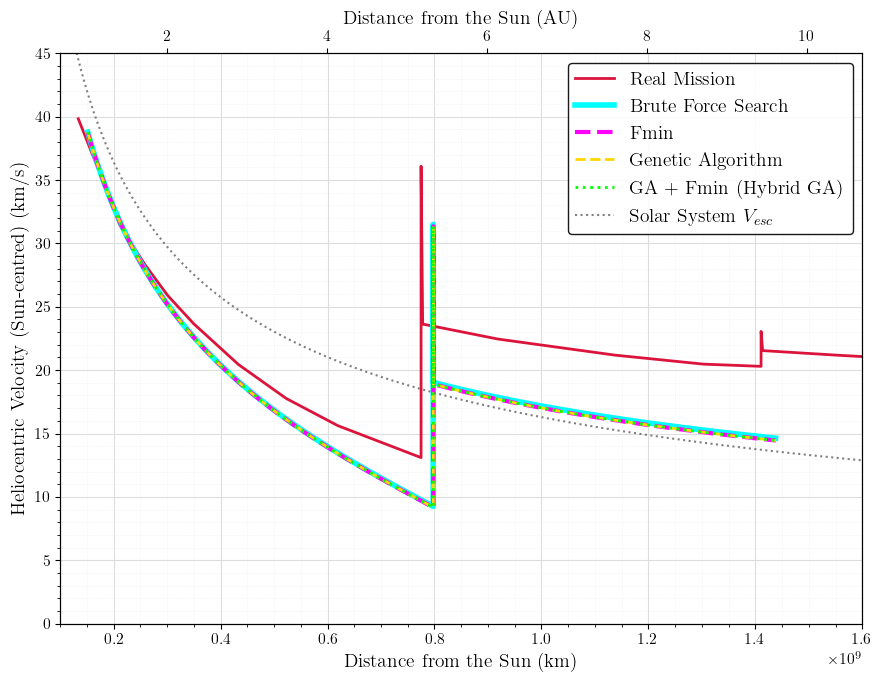

In [226]:
colours = {
    "Real Mission": "crimson",
    "Brute Force Search": "cyan",
    "Fmin": "magenta",
    "Genetic Algorithm": "gold",
    "Hybrid GA": "lime",
}

# Distinct line styles to prevent visual merging
line_styles = {
    "Real Mission": "-",
    "Brute Force Search": "-",
    "Fmin": "--",
    "Genetic Algorithm": "--",  # (0, (5, 1)),
    "Hybrid GA": ":",
}

# Define different line widths for clarity
line_widths = {
    "Real Mission": 2,
    "Brute Force Search": 4,
    "Fmin": 3,
    "Genetic Algorithm": 2,
    "Hybrid GA": 2,
}

# Setup LaTeX rendering
plt.rc("text", usetex=True)
plt.rc("font", family="serif")

# Create figure with primary axis
fig, ax1 = plt.subplots(figsize=(9, 7))


def plot_voyager_trajectory_vs_distance(
    date_departure, date_flyby_jupiter, date_flyby_saturn, method, plotlabel
):
    flag = False  # Don't show individual plots
    print("Method:", method)

    planet1 = "earth"
    planet2 = "jupiter"

    days1, positions1, velocities1, v1, v2, tof_to_jupiter, r1, r2, v1_p_sc, v2_p_sc = (
        plot_transfer_velocity(
            date1=date_departure,
            date2=date_flyby_jupiter,
            planet1="earth",
            planet2="jupiter",
            current_tof=0,
            show_plot=flag,
            num_points=100,
        )
    )

    print(f"[{planet1} to {planet2}] Initial velocity: {np.linalg.norm(v1):.2f} km/s")
    print(f"[{planet1} to {planet2}] Final velocity: {np.linalg.norm(v2):.2f} km/s")
    print(f"[{planet1} to {planet2}] Initial Sun Distance: {np.linalg.norm(r1):.2e} km")
    print(f"[{planet1} to {planet2}] Final Sun Distance: {np.linalg.norm(r2):.2e} km")

    planet1 = "jupiter"
    planet2 = "saturn"

    (
        days2,
        positions2,
        velocities2,
        v1,
        v2,
        tof_to_saturn,
        r1,
        r2,
        v1_p_sc_jupiter,
        v2_p_sc_jupiter,
    ) = plot_transfer_velocity(
        date1=date_flyby_jupiter,
        date2=date_flyby_saturn,
        planet1="jupiter",
        planet2="saturn",
        current_tof=tof_to_jupiter,
        show_plot=flag,
        num_points=100,
    )

    print(f"\n[{planet1} to {planet2}] Initial velocity: {np.linalg.norm(v1):.2f} km/s")
    print(f"[{planet1} to {planet2}] Final velocity: {np.linalg.norm(v2):.2f} km/s")
    print(f"[{planet1} to {planet2}] Initial Sun Distance: {np.linalg.norm(r1):.2e} km")
    print(f"[{planet1} to {planet2}] Final Sun Distance: {np.linalg.norm(r2):.2e} km")
    print("--------------------------------------------------------")

    # Calculate distances from the Sun in km
    distances1_km = np.array([np.linalg.norm(pos) for pos in positions1])
    distances2_km = np.array([np.linalg.norm(pos) for pos in positions2])

    # Concatenate distances and velocities - in km
    distances_final = (
        distances1_km.tolist()
        + [np.linalg.norm(positions1[-1])]
        + distances2_km.tolist()
    )
    velocities_final = velocities1 + [v1_p_sc_jupiter] + velocities2

    # Plot velocity vs distance
    ax1.plot(
        distances_final,
        velocities_final,
        color=colours[method],
        label=plotlabel,
        linestyle=line_styles[method],
        linewidth=line_widths[method],
    )

    # Return for potential further use
    return distances_final, velocities_final


# Execute plotting for each mission
# plot_voyager_trajectory_vs_distance(
#     date_departure,
#     date_flyby_jupiter,
#     date_flyby_saturn,
#     method="Real Mission",
#     plotlabel="Real Mission"
# )

ax1.plot(
    V1_NASA_distance_from_Sun_km,
    V1_NASA_velocity,
    color=colours["Real Mission"],
    label="Real Mission",
    linestyle=line_styles["Real Mission"],
    linewidth=line_widths["Real Mission"],
)

plot_voyager_trajectory_vs_distance(
    date_departure_BRUTE_MIN,
    date_flyby_jupiter_BRUTE_MIN,
    date_flyby_saturn_BRUTE_MIN,
    method="Brute Force Search",
    plotlabel="Brute Force Search",
)

plot_voyager_trajectory_vs_distance(
    date_departure_FMIN,
    date_flyby_jupiter_FMIN,
    date_flyby_saturn_FMIN,
    method="Fmin",
    plotlabel="Fmin",
)

plot_voyager_trajectory_vs_distance(
    date_departure_GA,
    date_flyby_jupiter_GA,
    date_flyby_saturn_GA,
    method="Genetic Algorithm",
    plotlabel="Genetic Algorithm",
)

plot_voyager_trajectory_vs_distance(
    date_departure_GA_FMIN_COMBINED,
    date_flyby_jupiter_GA_FMIN_COMBINED,
    date_flyby_saturn_GA_FMIN_COMBINED,
    method="Hybrid GA",
    plotlabel="GA + Fmin (Hybrid GA)",
)

# Add Solar System escape velocity if available
ax1.plot(r_esc, v_esc, ":", label="Solar System $V_{esc}$", color="gray", linewidth=1.5)

# Primary x-axis (Distance in km)
ax1.set_xlabel("Distance from the Sun (km)")
ax1.set_ylabel("Heliocentric Velocity (Sun-centred) (km/s)")
ax1.set_ylim(0, 45)

# Adjust the x-axis limits to show relevant range
ax1.set_xlim(1e8, 1.6e9)  # This covers Earth to slightly beyond Saturn

# Create secondary x-axis (Distance in AU)
ax2 = ax1.twiny()
ax2.set_xlabel("Distance from the Sun (AU)")

# Set tick positions based on AU
km_to_AU = 1 / 149597870.691  # Conversion factor
ax2.set_xlim(ax1.get_xlim()[0] * km_to_AU, ax1.get_xlim()[1] * km_to_AU)

# Improve legend
ax1.legend(
    loc="best",
    # fontsize=12,
    frameon=True,
    framealpha=0.9,
    edgecolor="black",
)

# Improve grid and ticks
ax1.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax1.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax1.minorticks_on()

# Customize tick parameters
ax1.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)
ax1.tick_params(
    axis="both",
    which="minor",
)  # labelsize=10)
ax2.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)

# plt.title(r'\textbf{Voyager I: Heliocentric Velocity vs Distance from the Sun}', fontsize=14, pad=10)
plt.tight_layout()

output_figures.save_file(
    "Voyager_I_Heliocentric_Velocity_vs_Distance.png", dpi=500, bbox_inches="tight"
)

plt.show()

Figure saved to: Voyager 1 - Figures/Voyager_I_Brute_Force_Search_Comparison.png


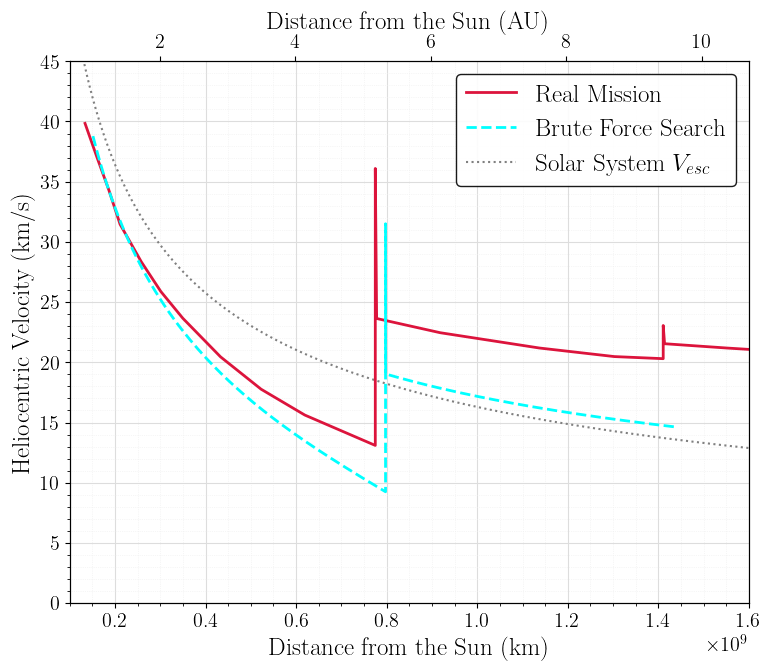

Figure saved to: Voyager 1 - Figures/Voyager_I_Fmin_Comparison.png


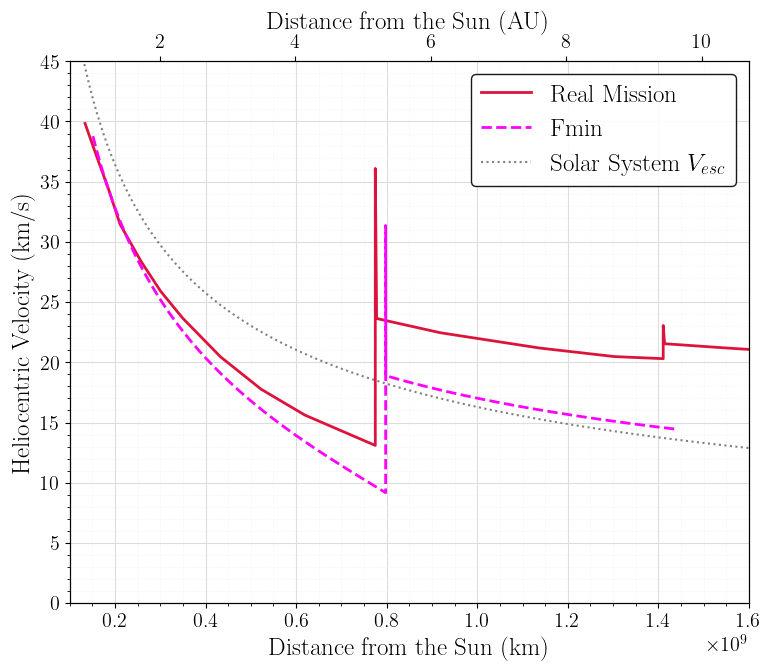

Figure saved to: Voyager 1 - Figures/Voyager_I_Genetic_Algorithm_Comparison.png


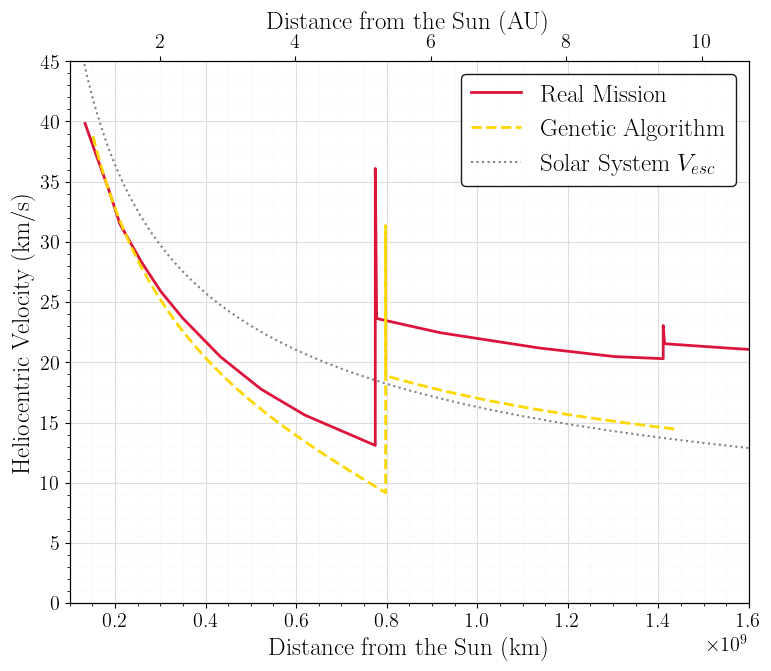

Figure saved to: Voyager 1 - Figures/Voyager_I_Hybrid_GA_Comparison.png


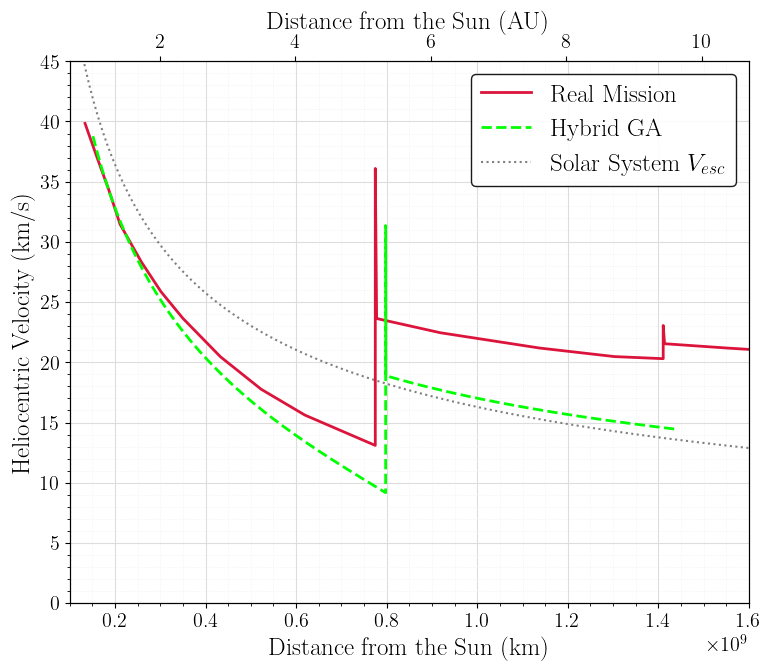

All four Voyager I figures have been created and saved.


In [227]:
set_font_sizes(18)

colours = {
    "Real Mission": "crimson",
    "Brute Force Search": "cyan",
    "Fmin": "magenta",
    "Genetic Algorithm": "gold",
    "Hybrid GA": "lime",
}

line_styles = {
    "Real Mission": "-",
    "Brute Force Search": "--",
    "Fmin": "--",
    "Genetic Algorithm": "--",
    "Hybrid GA": "--",
}

line_widths = {
    "Real Mission": 2,
    "Brute Force Search": 2,
    "Fmin": 2,
    "Genetic Algorithm": 2,
    "Hybrid GA": 2,
}

plt.rc("text", usetex=True)
plt.rc("font", family="serif")

figure_titles = [
    r"\textbf{Voyager I: Brute Force Search Optimisation Comparison}",
    r"\textbf{Voyager I: Fmin Optimisation Comparison}",
    r"\textbf{Voyager I: Genetic Algorithm Optimisation Comparison}",
    r"\textbf{Voyager I: GA + Fmin (Hybrid GA) Optimisation Comparison}",
]

# Methods and their labels for each figure
methods = ["Brute Force Search", "Fmin", "Genetic Algorithm", "Hybrid GA"]
method_labels = ["Brute Force Search", "Fmin", "Genetic Algorithm", "Hybrid GA"]


def plot_voyager_trajectory_vs_distance(
    ax, date_departure, date_flyby_jupiter, date_flyby_saturn, method, plotlabel
):
    flag = False  # Don't show individual plots

    # Earth to Jupiter
    planet1 = "earth"
    planet2 = "jupiter"
    days1, positions1, velocities1, v1, v2, tof_to_jupiter, r1, r2, v1_p_sc, v2_p_sc = (
        plot_transfer_velocity(
            date1=date_departure,
            date2=date_flyby_jupiter,
            planet1="earth",
            planet2="jupiter",
            current_tof=0,
            show_plot=flag,
            num_points=100,
        )
    )

    # Jupiter to Saturn
    planet1 = "jupiter"
    planet2 = "saturn"
    (
        days2,
        positions2,
        velocities2,
        v1,
        v2,
        tof_to_saturn,
        r1,
        r2,
        v1_p_sc_jupiter,
        v2_p_sc_jupiter,
    ) = plot_transfer_velocity(
        date1=date_flyby_jupiter,
        date2=date_flyby_saturn,
        planet1="jupiter",
        planet2="saturn",
        current_tof=tof_to_jupiter,
        show_plot=flag,
        num_points=100,
    )

    # Calculate distances from the Sun in km
    distances1_km = np.array([np.linalg.norm(pos) for pos in positions1])
    distances2_km = np.array([np.linalg.norm(pos) for pos in positions2])

    # Concatenate distances and velocities - in km
    distances_final = (
        distances1_km.tolist()
        + [np.linalg.norm(positions1[-1])]
        + distances2_km.tolist()
    )
    velocities_final = velocities1 + [v1_p_sc_jupiter] + velocities2

    # Plot velocity vs distance for this method
    ax.plot(
        distances_final,
        velocities_final,
        color=colours[method],
        label=plotlabel,
        linestyle=line_styles[method],
        linewidth=line_widths[method],
    )

    # Return for potential further use
    return distances_final, velocities_final


# Create and configure each figure separately
for i, (method, label, title) in enumerate(zip(methods, method_labels, figure_titles)):
    # Create a new figure for each method
    fig = plt.figure(figsize=(8, 7))
    ax = fig.add_subplot(111)

    # Plot escape velocity curve if available
    try:
        ax.plot(
            r_esc,
            v_esc,
            ":",
            label="Solar System $V_{esc}$",
            color="gray",
            linewidth=1.5,
        )
    except NameError:
        pass

    # Plot real mission data for Voyager I
    ax.plot(
        V1_NASA_distance_from_Sun_km,
        V1_NASA_velocity,
        color=colours["Real Mission"],
        label="Real Mission",
        linestyle=line_styles["Real Mission"],
        linewidth=line_widths["Real Mission"],
    )

    # Plot the specific optimization method
    if method == "Brute Force Search":
        plot_voyager_trajectory_vs_distance(
            ax,
            date_departure_BRUTE_MIN,
            date_flyby_jupiter_BRUTE_MIN,
            date_flyby_saturn_BRUTE_MIN,
            method=method,
            plotlabel=label,
        )
    elif method == "Fmin":
        plot_voyager_trajectory_vs_distance(
            ax,
            date_departure_FMIN,
            date_flyby_jupiter_FMIN,
            date_flyby_saturn_FMIN,
            method=method,
            plotlabel=label,
        )
    elif method == "Genetic Algorithm":
        plot_voyager_trajectory_vs_distance(
            ax,
            date_departure_GA,
            date_flyby_jupiter_GA,
            date_flyby_saturn_GA,
            method=method,
            plotlabel=label,
        )
    elif method == "Hybrid GA":
        plot_voyager_trajectory_vs_distance(
            ax,
            date_departure_GA_FMIN_COMBINED,
            date_flyby_jupiter_GA_FMIN_COMBINED,
            date_flyby_saturn_GA_FMIN_COMBINED,
            method=method,
            plotlabel=label,
        )

    # Configure axes and labels
    ax.set_xlim(1e8, 1.6e9)  # Range from Earth to slightly beyond Saturn
    ax.set_ylim(0, 45)  # Based on Voyager I example
    ax.set_xlabel(
        "Distance from the Sun (km)",
    )  # fontsize=12)
    ax.set_ylabel(
        "Heliocentric Velocity (km/s)",
    )  # fontsize=12)

    # Create secondary x-axis (Distance in AU)
    ax2 = ax.twiny()
    ax2.set_xlabel(
        "Distance from the Sun (AU)",
    )  # fontsize=12)
    km_to_AU = 1 / 149597870.691  # Conversion factor
    ax2.set_xlim(ax.get_xlim()[0] * km_to_AU, ax.get_xlim()[1] * km_to_AU)
    ax2.tick_params(
        axis="x",
        which="major",
    )  # labelsize=12)

    # Improve grid and ticks
    ax.grid(which="major", color="#DDDDDD", linewidth=0.8)
    ax.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
    ax.minorticks_on()
    ax.tick_params(
        axis="both",
        which="major",
    )  # labelsize=12)
    ax.tick_params(
        axis="both",
        which="minor",
    )  # labelsize=10)

    # Reorder legend to put Real Mission first
    handles, labels = ax.get_legend_handles_labels()
    if len(handles) > 2:  # Make sure we have all three expected curves
        new_order = [1, 2, 0]  # Real Mission, Method, Escape Velocity
        handles = [handles[i] for i in new_order]
        labels = [labels[i] for i in new_order]
    ax.legend(
        handles,
        labels,
        loc="best",  # fontsize=12,
        frameon=True,
        framealpha=0.9,
        edgecolor="black",
    )

    # Set the figure title
    # plt.title(title, fontsize=14, pad=10)

    plt.tight_layout()

    # Save each figure with high resolution
    filename = (
        f"Voyager_I_{method.replace(' ', '_').replace('-->', 'to')}_Comparison.png"
    )
    output_figures.save_file(filename, dpi=500, bbox_inches="tight")

    plt.show()
    plt.close(fig)

print("All four Voyager I figures have been created and saved.")

## DeltaV to Fuel Mass

In [229]:
def compute_fuel_mass(M0, Vex, deltaV):
    Mf = M0 * (1 - np.exp(-deltaV / Vex))
    return Mf


def mission_fuel_mass(deltaV_injection, deltaV_jupiter):
    M0_1 = M0
    Mf_1 = compute_fuel_mass(M0_1, Vex, deltaV_injection)
    # print(Mf_1)
    M0_2 = M0_1 - Mf_1
    # print(M0_2)
    Mf_2 = compute_fuel_mass(M0_2, Vex, deltaV_jupiter)

    Mf_total = Mf_1 + Mf_2

    return Mf_total


deltaV_injection_values = {
    "Real Mission": data_dict_REAL["deltaV_injection (km/s)"],
    "Brute Force Search": data_dict_BRUTE_MIN["deltaV_injection (km/s)"],
    "Fmin": data_dict_FMIN["deltaV_injection (km/s)"],
    "Genetic Algorithm": data_dict_GA["deltaV_injection (km/s)"],
}

deltaV_jupiter_values = {
    "Real Mission": data_dict_REAL["deltaV_jupiter (km/s)"],
    "Brute Force Search": data_dict_BRUTE_MIN["deltaV_jupiter (km/s)"],
    "Fmin": data_dict_FMIN["deltaV_jupiter (km/s)"],
    "Genetic Algorithm": data_dict_GA["deltaV_jupiter (km/s)"],
}

# Compute and print fuel masses for each method
fuel_masses = {}
for method in deltaV_injection_values:
    fuel_masses[method] = mission_fuel_mass(
        deltaV_injection_values[method], deltaV_jupiter_values[method]
    )
    print(f"{method}: {fuel_masses[method]:.2f} kg of fuel used")

Real Mission: 1039.00 kg of fuel used
Brute Force Search: 974.21 kg of fuel used
Fmin: 972.25 kg of fuel used
Genetic Algorithm: 972.25 kg of fuel used


In [230]:
# Given deltaVs
deltaVss = {
    "Real Mission": deltaV_REAL,
    "Brute Force Search": deltaV_BRUTE_MIN,
    "Fmin": deltaV_FMIN,
    "Genetic Algorithm": deltaV_GA,
}

fuel_masses = {}
for method in deltaVss:
    fuel_masses[method] = compute_fuel_mass(M0, Vex, deltaVss[method])

# Print results
for method, fuel_mass in fuel_masses.items():
    print(f"{method}: {fuel_mass:.2f} kg of fuel used")

Real Mission: 1039.00 kg of fuel used
Brute Force Search: 974.21 kg of fuel used
Fmin: 972.25 kg of fuel used
Genetic Algorithm: 972.25 kg of fuel used


In [231]:
deltaVss  # in km/s

{'Real Mission': 10.317548951648549,
 'Brute Force Search': 9.414558743791737,
 'Fmin': 9.38803007413873,
 'Genetic Algorithm': 9.388030090634013}

# Voyager I \& II NASA Mission Data

In [233]:
file_path = output_pickle.get_path("V1.csv")
data1 = pd.read_csv(file_path)

data1["x_km"] = data1["x"] * 149597870.691

V1_NASA_distance_from_Sun_km = data1["x_km"]
V1_NASA_distance_from_Sun_AU = data1["x"]  # in AU where 1 AU = 149597870.691 km
V1_NASA_velocity = data1[" y"]

data1

,x,y,x_km
0,0.895445,39.838746,1.339567e+08
1,1.073111,37.004831,1.605351e+08
2,1.243803,34.356325,1.860703e+08
3,1.412753,31.459340,2.113448e+08
4,1.726100,28.346305,2.582209e+08
5,2.014462,25.878735,3.013592e+08
6,2.338850,23.657631,3.498870e+08
7,2.895525,20.453570,4.331644e+08
8,3.494765,17.764582,5.228094e+08
9,4.139764,15.619520,6.192999e+08


In [234]:
file_path = output_pickle.get_path("V2.csv")
data2 = pd.read_csv(file_path)

data2["x_km"] = data2["x"] * 149597870.691

V2_NASA_distance_from_Sun_km = data2["x_km"]
V2_NASA_distance_from_Sun_AU = data2["x"]  # in AU where 1 AU = 149597870.691 km
V2_NASA_velocity = data2[" y"]

data2

,x,y,x_km
0,0.982667,39.034907,1.470049e+08
1,1.106842,36.829962,1.655812e+08
2,1.281253,34.222948,1.916728e+08
3,1.459839,31.694050,2.183888e+08
4,1.671518,28.857742,2.500555e+08
5,1.922849,26.352738,2.876541e+08
6,2.232168,23.640037,3.339277e+08
7,2.719179,20.187530,4.067834e+08
8,3.326190,17.032554,4.975910e+08
9,3.962270,14.320542,5.927472e+08


In [235]:
r_esc = np.linspace(1e-99, 6e9, 1000)
v_esc = np.sqrt(2 * mu_sun / r_esc)

Figure saved to: Voyager 1 - Figures/Voyager_1_and_2_VvsDistance.png


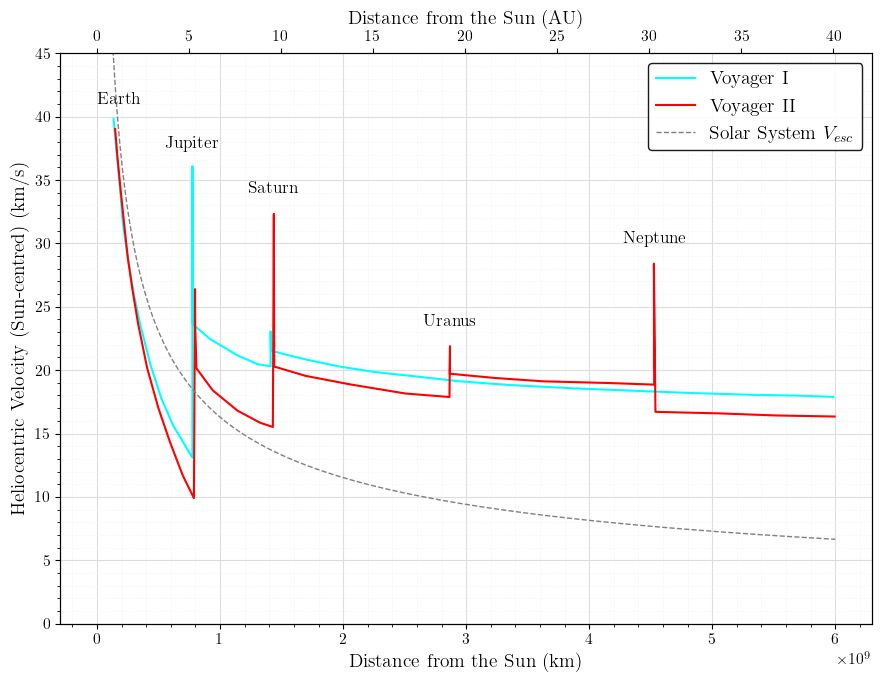

In [236]:
set_font_sizes(14)

fig, ax1 = plt.subplots(figsize=(9, 7))

# Plot Voyager I and II trajectories
ax1.plot(
    V1_NASA_distance_from_Sun_km,
    V1_NASA_velocity,
    label="Voyager I",
    color="cyan",
    linewidth=1.5,
)
ax1.plot(
    V2_NASA_distance_from_Sun_km,
    V2_NASA_velocity,
    label="Voyager II",
    color="red",
    linewidth=1.5,
)

# Plot Solar System escape velocity
ax1.plot(r_esc, v_esc, "--", label="Solar System $V_{esc}$", color="gray", linewidth=1)

# Labels for planets
ax1.annotate(
    "Earth",
    xy=(1.5e8, 40),
    xytext=(0, 41),
)  # fontsize=12, color='black')
ax1.annotate(
    "Jupiter",
    xy=(7.78e8, 40),
    xytext=(5.5e8, 37.5),
)  # fontsize=12, color='black')
ax1.annotate(
    "Saturn",
    xy=(1.43e9, 40),
    xytext=(1.225e9, 34),
)  # fontsize=12, color='black')
ax1.annotate(
    "Uranus",
    xy=(2.87e9, 40),
    xytext=(2.65e9, 23.5),
)  # fontsize=12, color='black')
ax1.annotate(
    "Neptune",
    xy=(4.50e9, 40),
    xytext=(4.275e9, 30),
)  # fontsize=12, color='black')

# Primary x-axis (Distance in km)
ax1.set_xlabel(
    "Distance from the Sun (km)",
)  # fontsize=12)
ax1.set_ylabel(
    "Heliocentric Velocity (Sun-centred) (km/s)",
)  # fontsize=12)
ax1.set_ylim(0, 45)

# Create secondary x-axis (Distance in AU)
ax2 = ax1.twiny()
ax2.set_xlabel(
    "Distance from the Sun (AU)",
)  # fontsize=12)

# Set tick positions based on AU
km_to_AU = 1 / 149597870.691  # Conversion factor
ax2.set_xlim(ax1.get_xlim()[0] * km_to_AU, ax1.get_xlim()[1] * km_to_AU)

# Improve legend
ax1.legend(
    loc="best",
    # fontsize=12,
    frameon=True,
    framealpha=0.9,
    edgecolor="black",
)

# Improve grid and ticks
ax1.grid(which="major", color="#DDDDDD", linewidth=0.8)
ax1.grid(which="minor", color="#EEEEEE", linestyle=":", linewidth=0.5)
ax1.minorticks_on()

# Customize tick parameters
ax1.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)
ax1.tick_params(
    axis="both",
    which="minor",
)  # labelsize=10)
ax2.tick_params(
    axis="both",
    which="major",
)  # labelsize=12)

# plt.title(r"\textbf{Heliocentric Velocity vs Distance from the Sun}", fontsize=14, pad=10)

plt.tight_layout()
output_figures.save_file(
    "Voyager_1_and_2_VvsDistance.png", dpi=500, bbox_inches="tight"
)
plt.show()